# Project

In [1]:
import pandas as pd
import numpy as np
import scipy.stats as sc
import matplotlib.pyplot as plt
import math as m
import random as r
import numpy.matlib

from scipy.stats import norm
from scipy.stats import uniform
# from yahoofinancials import YahooFinancials
from datetime import datetime

In [2]:
import seaborn as sns
sns.set_style('whitegrid')

## 1. Данные
Подробнее в `RM_part1.ipynb`.

In [3]:
data = pd.read_excel('./Final_data.xlsx')

In [4]:
data.head(2)

,Date,Курс доллара,Курс евро,Нефть,МосБиржа,РТС,Золото,Серебро,Платина,КБД 0.25,...,Аэрофлот,Газпром,ГМК Норникель,Лукойл,МТС,ПИК,Роснефть,Сбербанк,Татнефть,Яндекс
0,2015-01-01,56.2376,68.3681,55.84,NaN,NaN,2168.34,28.55,2187.78,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-02,NaN,NaN,56.42,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
data.columns

Index(['Date', 'Курс доллара', 'Курс евро', 'Нефть', 'МосБиржа', 'РТС',
       'Золото', 'Серебро', 'Платина', 'КБД 0.25', 'КБД 0.5', 'КБД 1', 'КБД 5',
       'КБД 10', 'КБД 15', 'КБД 20', 'КБД 30', 'ОФЗ_26207', 'ОФЗ_26215',
       'ОФЗ_26218', 'ОФЗ_26219', 'ОФЗ_26222', 'Аэрофлот', 'Газпром',
       'ГМК Норникель', 'Лукойл', 'МТС', 'ПИК', 'Роснефть', 'Сбербанк',
       'Татнефть', 'Яндекс'],
      dtype='object')

In [6]:
indexes = ['Нефть', "МосБиржа", "РТС", "Золото", "Серебро", "Платина"]
stocks = [
    'Аэрофлот', 'Газпром', 'ГМК Норникель', 'Лукойл', 'МТС', 
    'ПИК', 'Роснефть', 'Сбербанк', 'Татнефть', 'Яндекс'
]
bonds = ['ОФЗ_26207', 'ОФЗ_26215', 'ОФЗ_26218', 'ОФЗ_26219', 'ОФЗ_26222']
currencies = ['Курс доллара', "Курс евро"]
rates = ['КБД 0.25', 'КБД 0.5', 'КБД 1', 'КБД 5', 'КБД 10', 'КБД 15', 'КБД 20', 'КБД 30']

In [8]:
tools = stocks + bonds + currencies
risk_factors = rates + indexes

In [15]:
data[risk_factors].describe()

,КБД 0.25,КБД 0.5,КБД 1,КБД 5,КБД 10,КБД 15,КБД 20,КБД 30,Нефть,МосБиржа,РТС,Золото,Серебро,Платина,Курс доллара,Курс евро
count,2002.000000,2002.000000,2002.000000,2002.000000,2002.000000,2002.000000,2002.000000,2002.000000,2209.000000,2001.000000,1998.000000,1973.000000,1973.000000,1973.000000,1973.000000,1973.000000
mean,7.734865,7.774975,7.836758,8.176159,8.354765,8.448422,8.511044,8.599171,62.871707,2471.450465,1177.521126,3144.931495,40.151434,2035.965327,66.034707,74.557807
std,2.329102,2.274443,2.218317,1.914863,1.612422,1.408187,1.275830,1.152912,18.262171,657.223288,248.238684,888.435537,12.205884,357.903066,7.842310,10.169404
min,3.680000,3.870000,4.080000,4.950000,5.590000,5.970000,6.170000,6.370000,19.330000,1435.660000,628.410000,1900.020000,25.570000,1519.760000,49.177700,52.737900
25%,6.375000,6.440000,6.542500,6.910000,7.240000,7.490000,7.650000,7.770000,49.920000,1969.190000,1004.637500,2448.140000,31.660000,1777.840000,60.739700,68.784300
50%,7.440000,7.500000,7.590000,8.000000,8.160000,8.240000,8.350000,8.660000,61.650000,2298.000000,1147.095000,2769.320000,34.990000,1902.000000,64.867200,73.023600
75%,9.290000,9.437500,9.097500,9.080000,9.070000,9.130000,9.130000,9.110000,72.160000,2809.810000,1303.440000,4010.170000,42.780000,2220.360000,72.082900,81.153300
max,17.870000,17.290000,16.860000,17.220000,14.980000,13.470000,13.490000,13.610000,127.980000,4287.520000,1919.580000,7731.420000,101.300000,4295.770000,120.378500,132.958100


## 2. Risk-factors analysis

Два варианта:
- зафиксировать PCA на 0.95 explainable variance (тогда для всех рядов прогноза одно и то же)
- оптимизировать параметр число компонент отдельно для каждого ряда 

In [9]:
from data_stats import *

### PCA (.95 explainable variance)

In [10]:
data[risk_factors].shape

(2922, 14)

In [11]:
reduced, pca = reduce_with_pca(data[risk_factors].fillna(method='bfill').fillna(method='ffill'))
reduced.shape

(2922, 4)

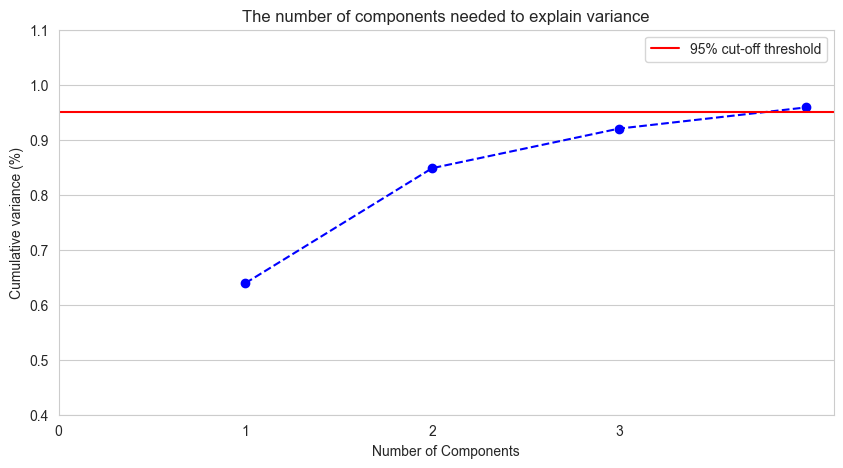

In [12]:
plot_explained_variance(pca, ylim=(0.4, 1.1))

### Feature correlation

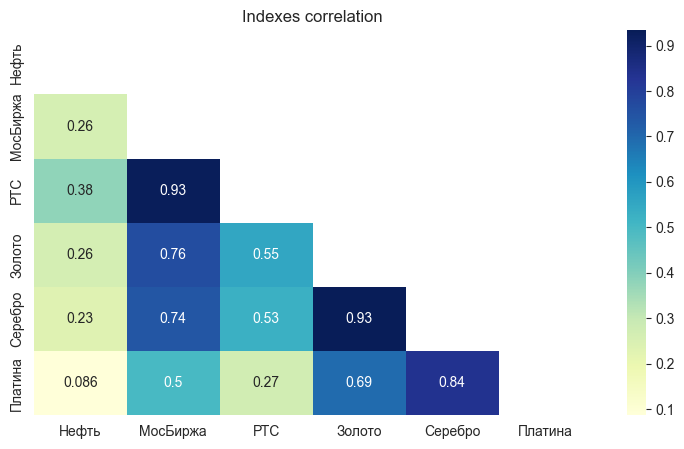

In [21]:
plot_corr(data[indexes])
plt.title('Indexes correlation')
plt.show()

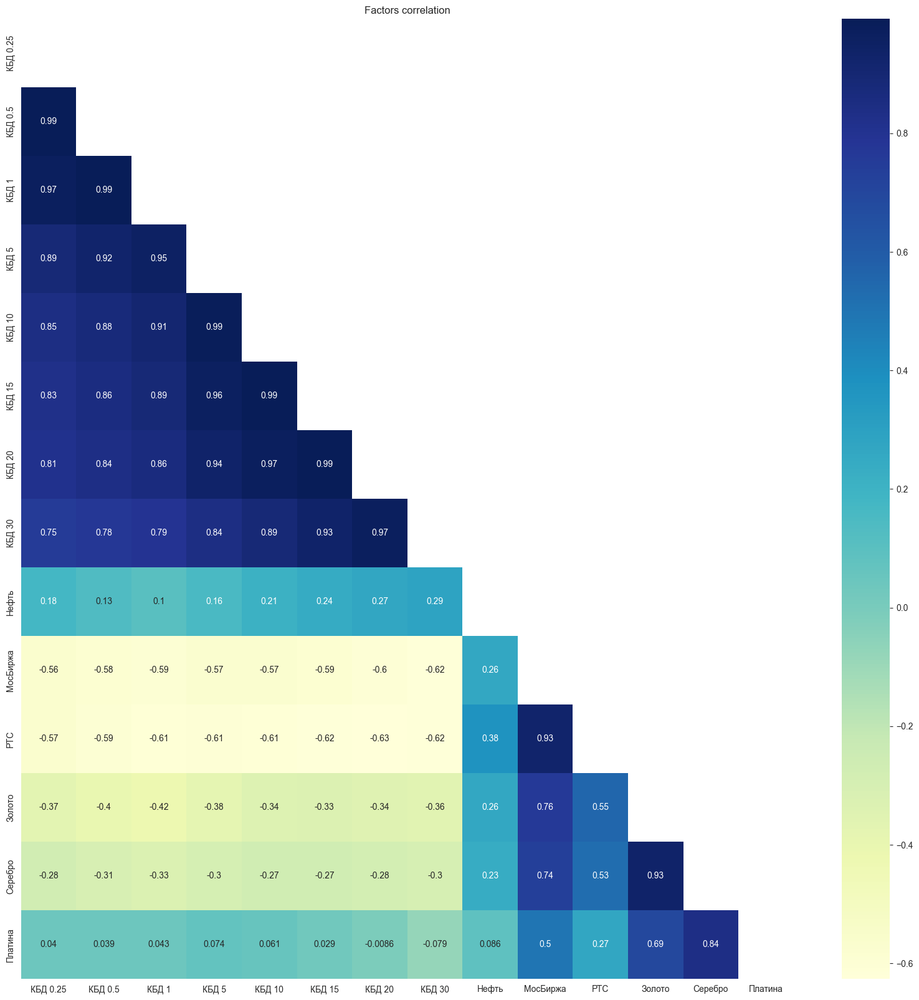

In [14]:
fig, ax = plt.subplots(1,1, figsize=(20,20))
plot_corr(data[risk_factors], ax=ax)
plt.title('Factors correlation')
plt.show()

Pairwise relationships of market indices:

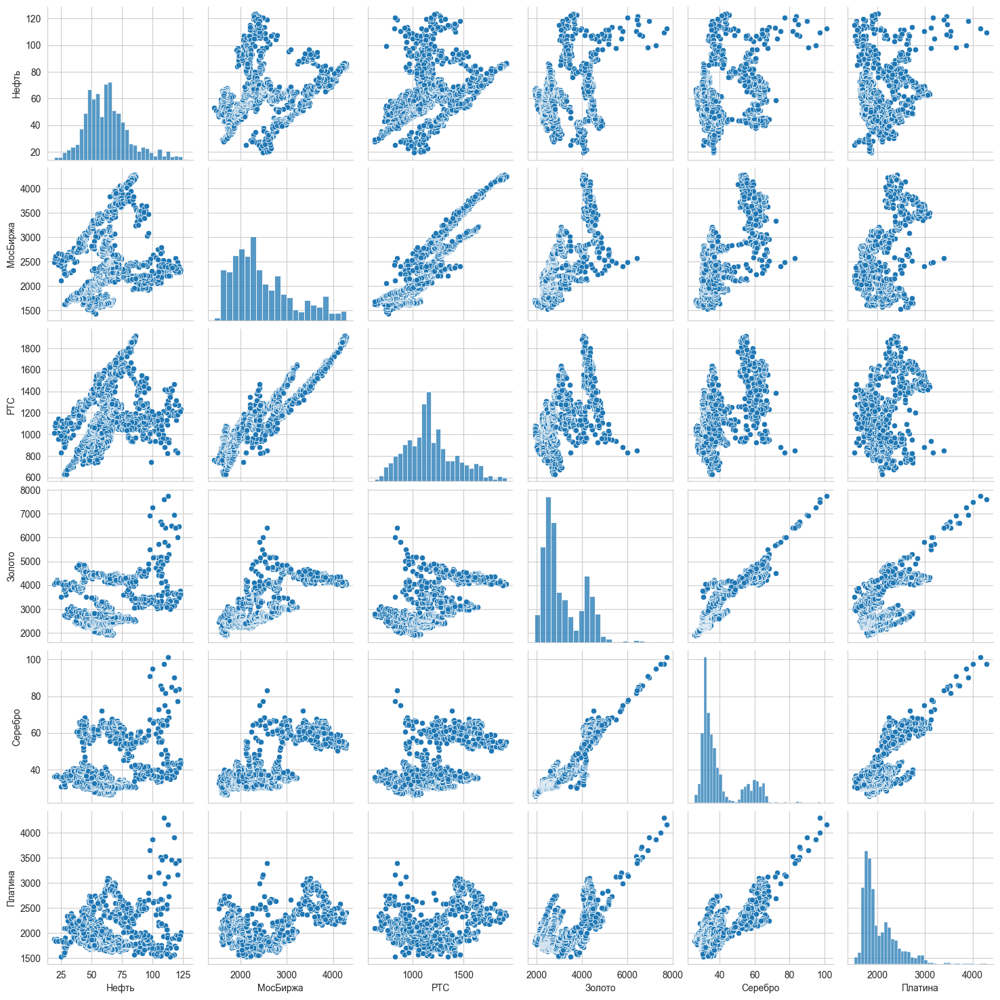

In [36]:
sns.pairplot(data[indexes])
plt.show()

### Full info

КБД 0.25


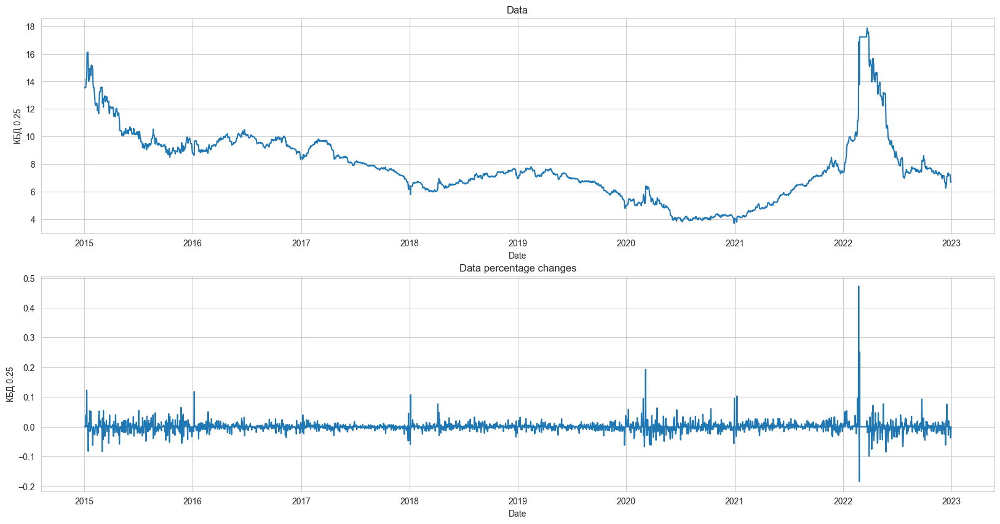

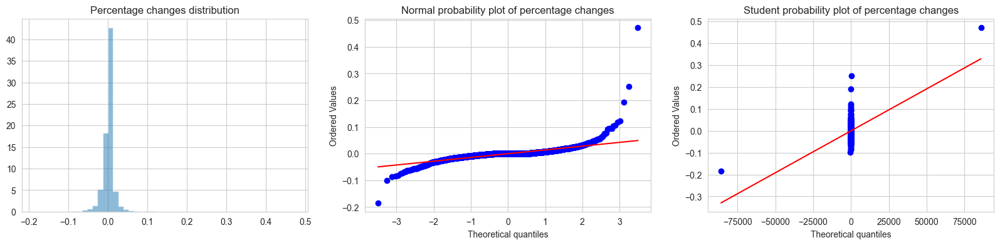

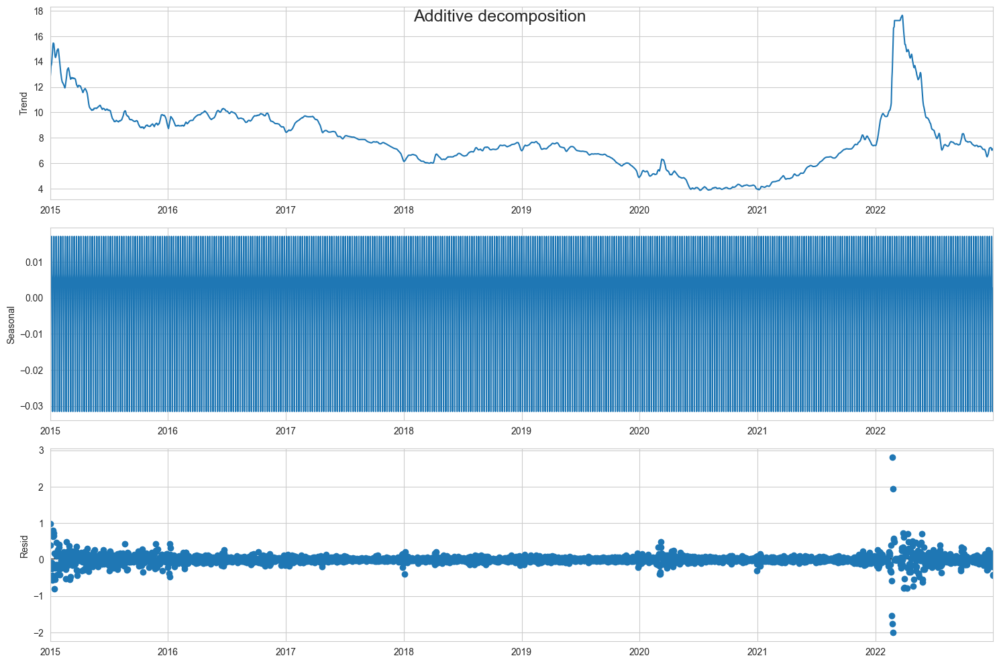

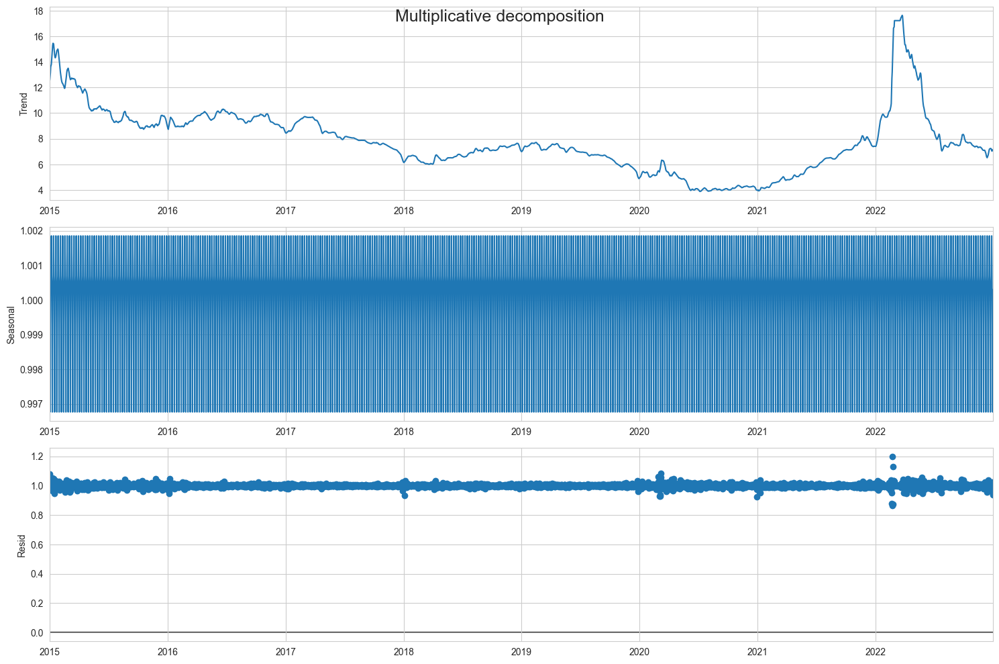

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is stationary.
KPSS test: the series is not stationary.


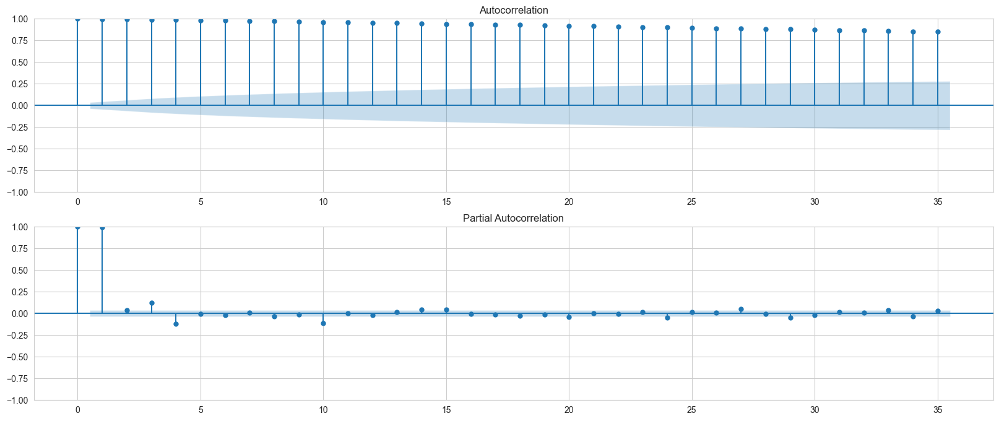


	Diff-1
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
КБД 0.5


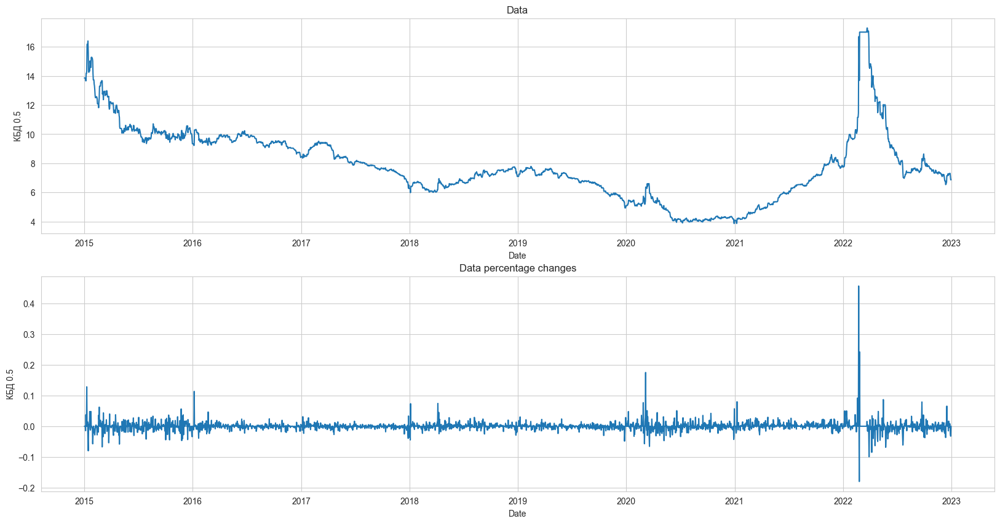

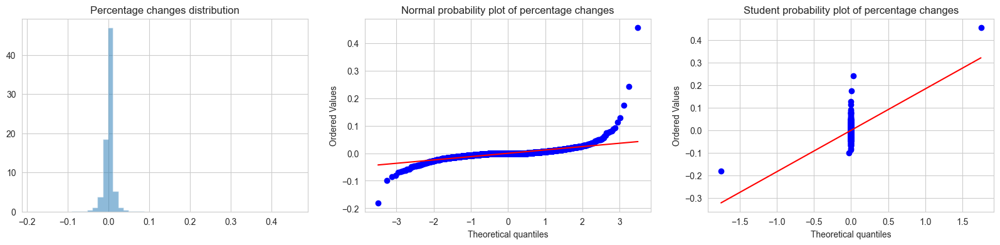

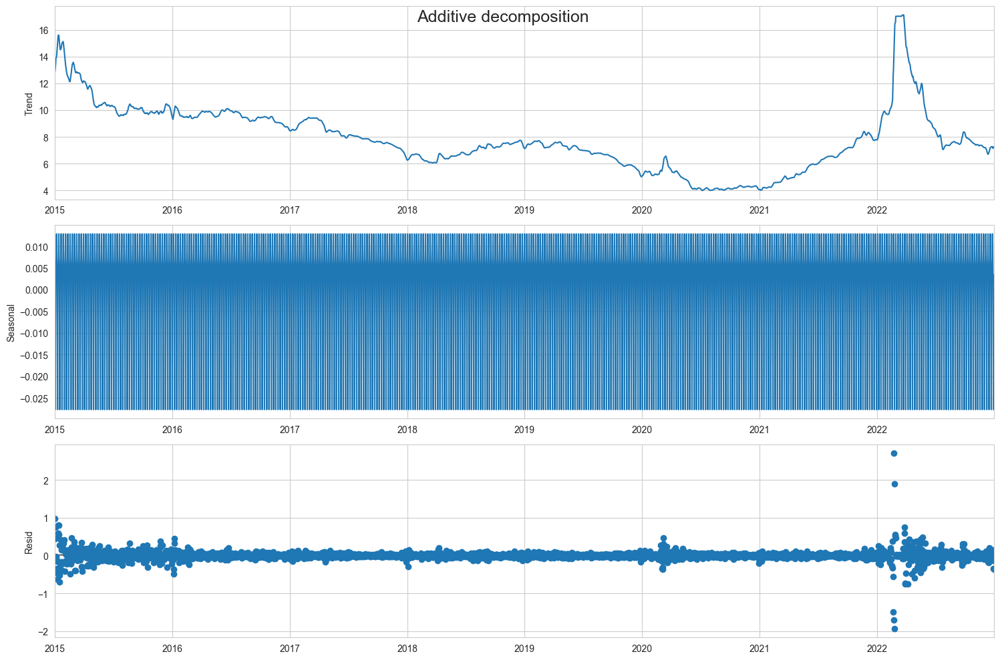

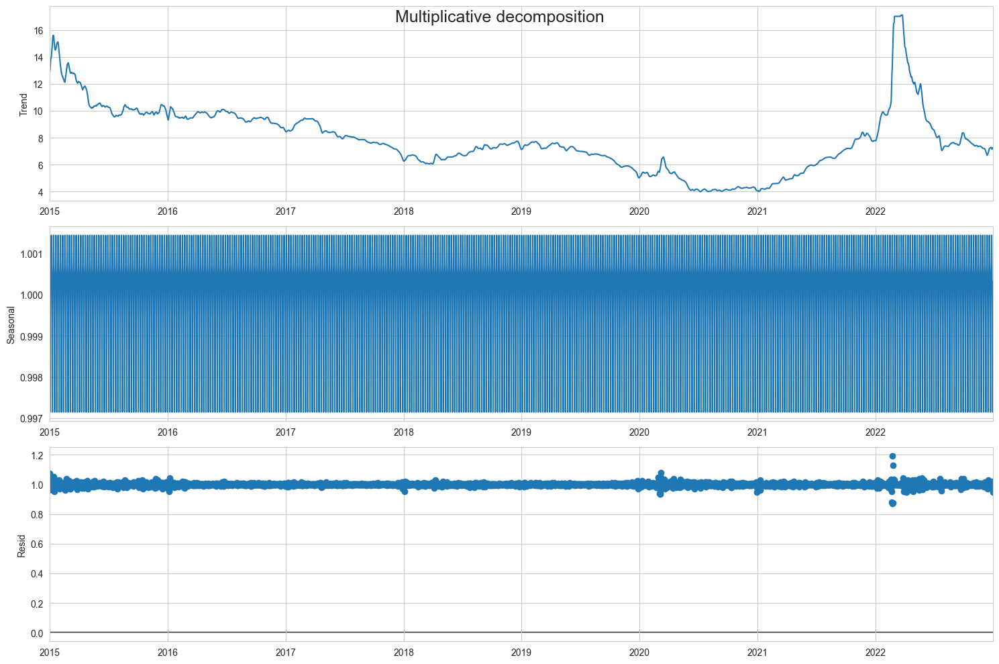

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is stationary.
KPSS test: the series is not stationary.


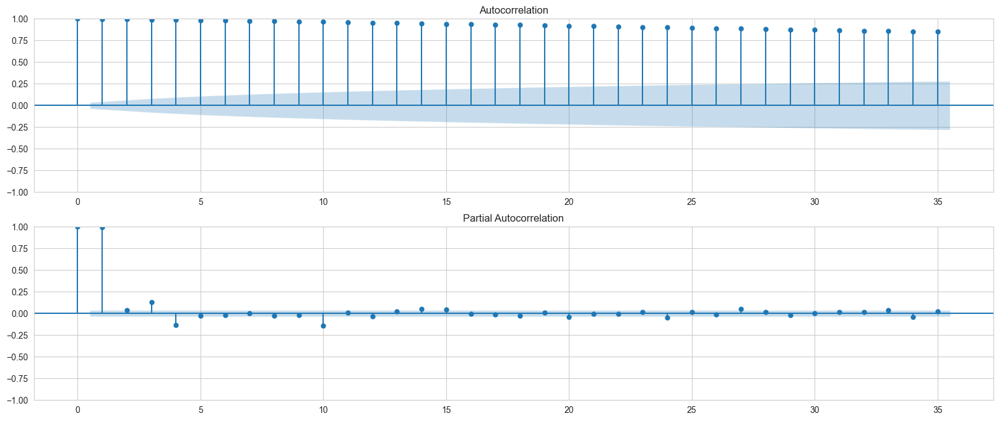


	Diff-1
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
КБД 1


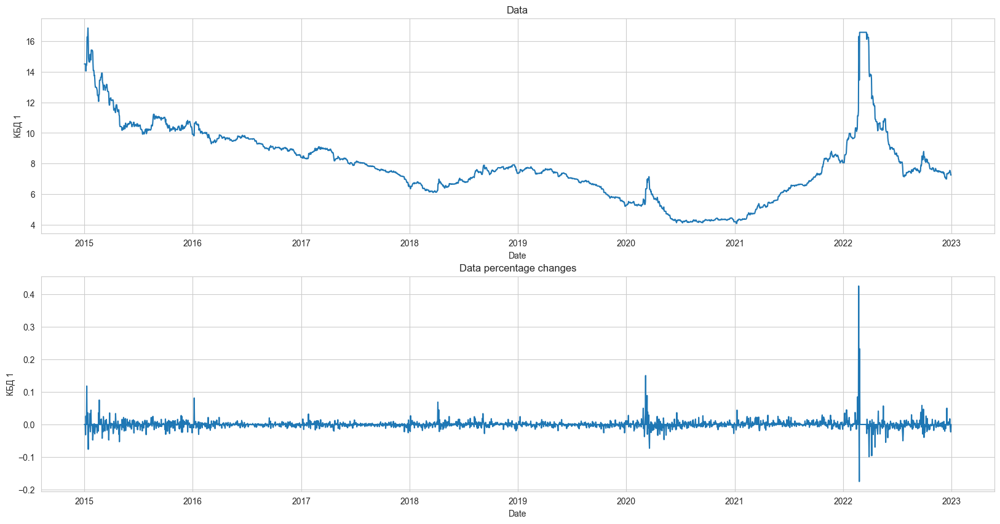

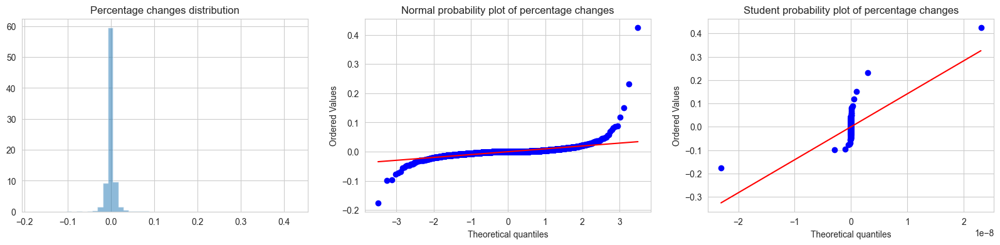

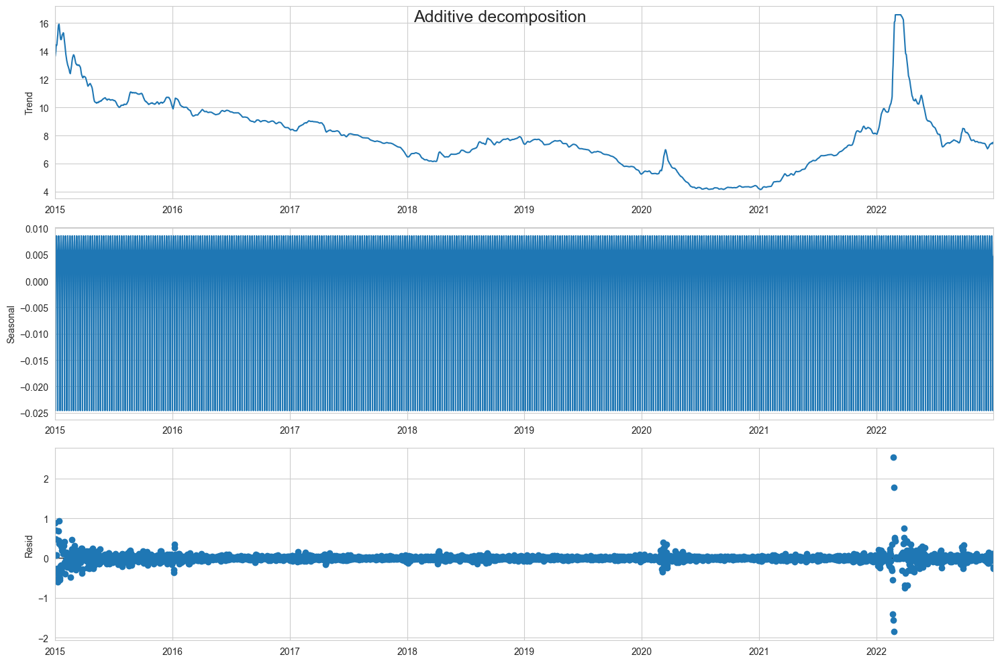

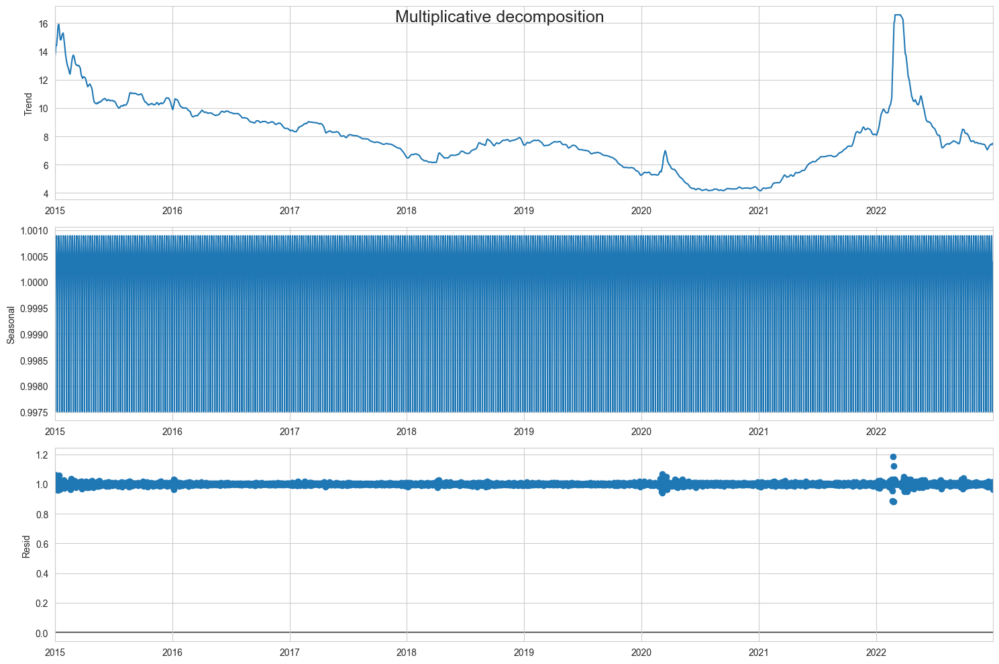

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is stationary.
KPSS test: the series is not stationary.


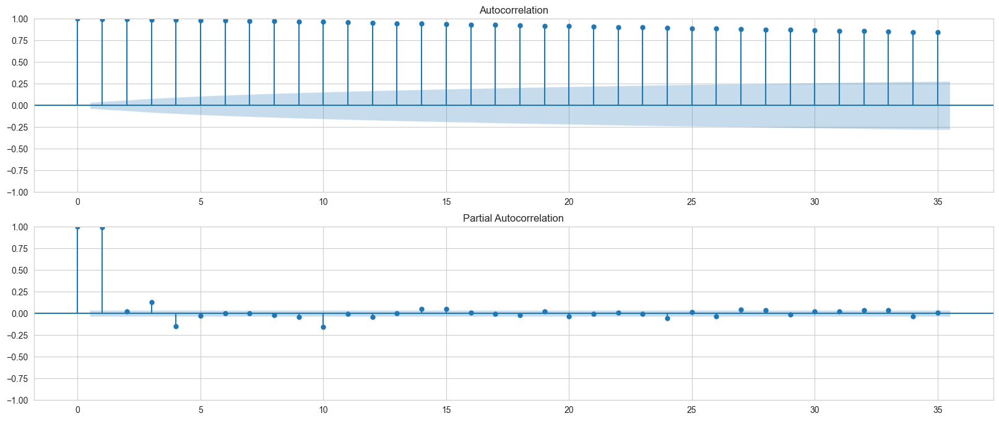


	Diff-1
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
КБД 5


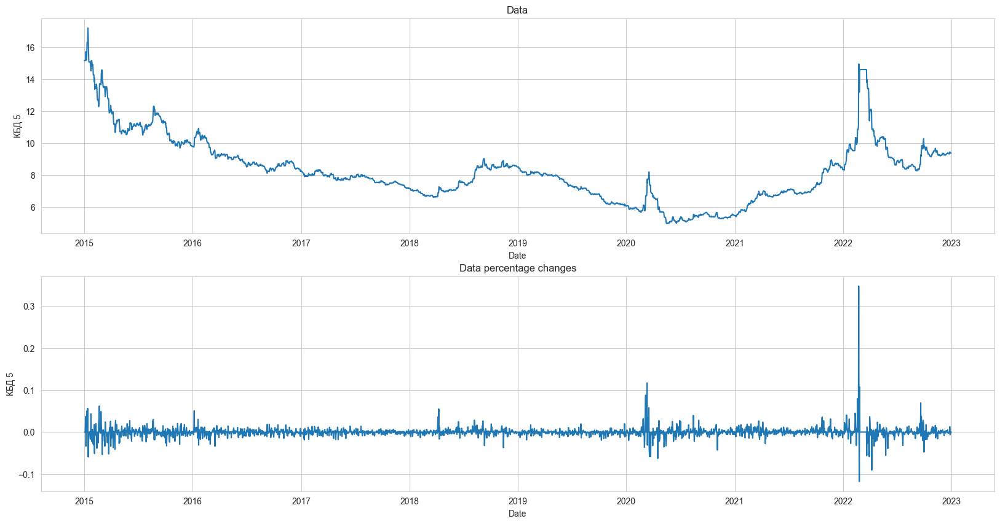

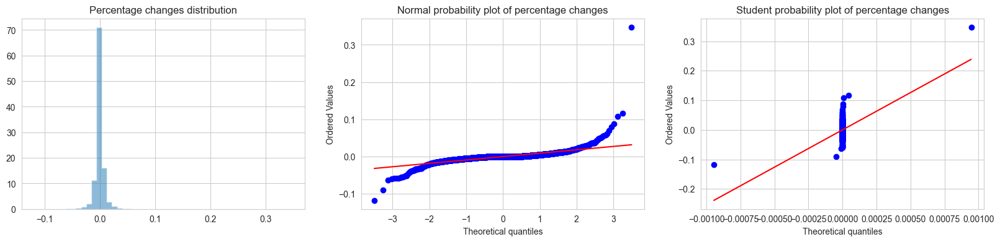

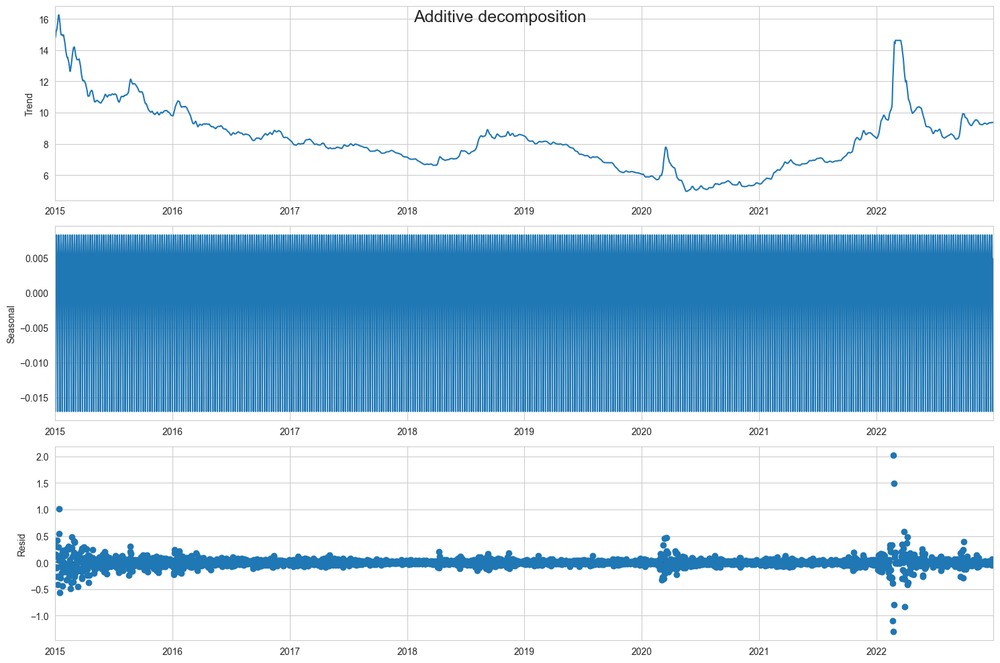

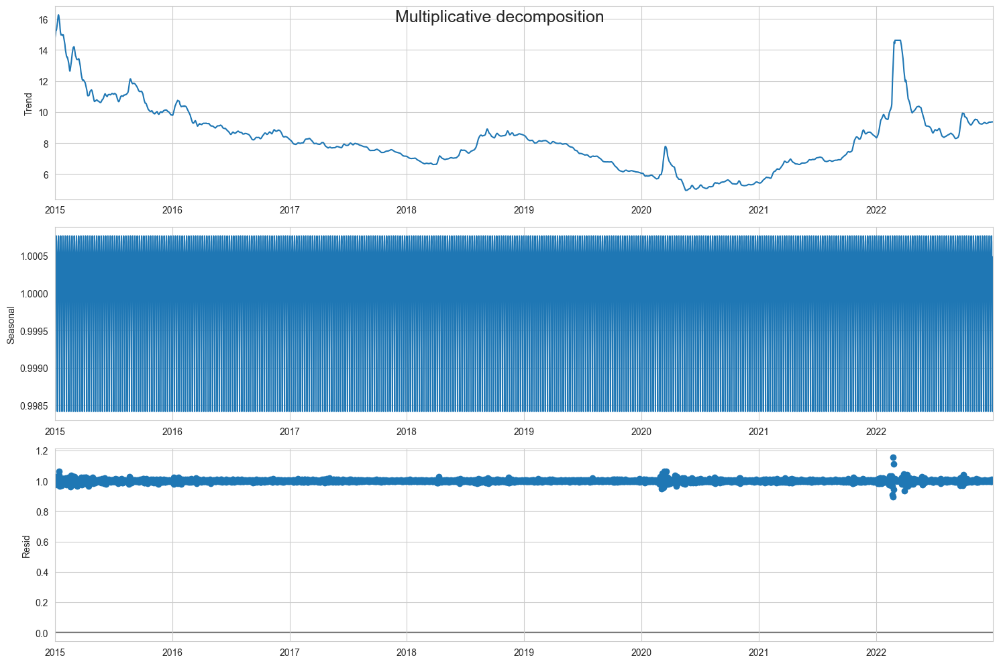

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is stationary.
KPSS test: the series is not stationary.


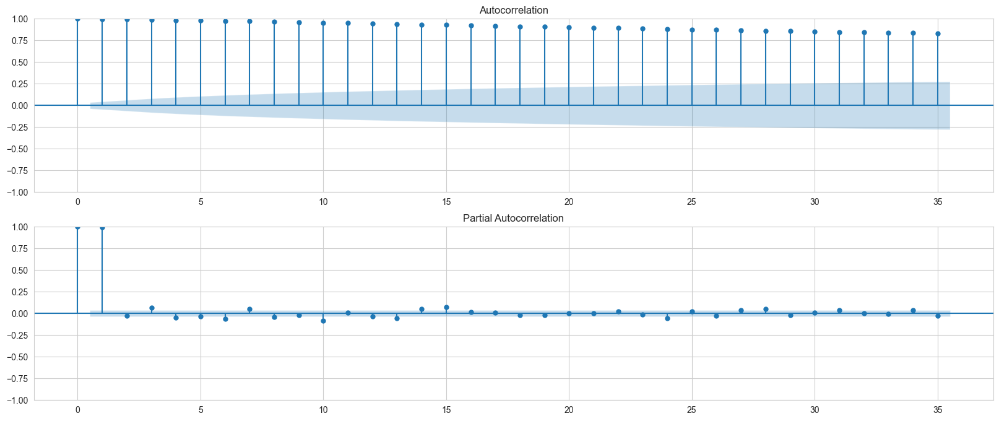


	Diff-1
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
КБД 10


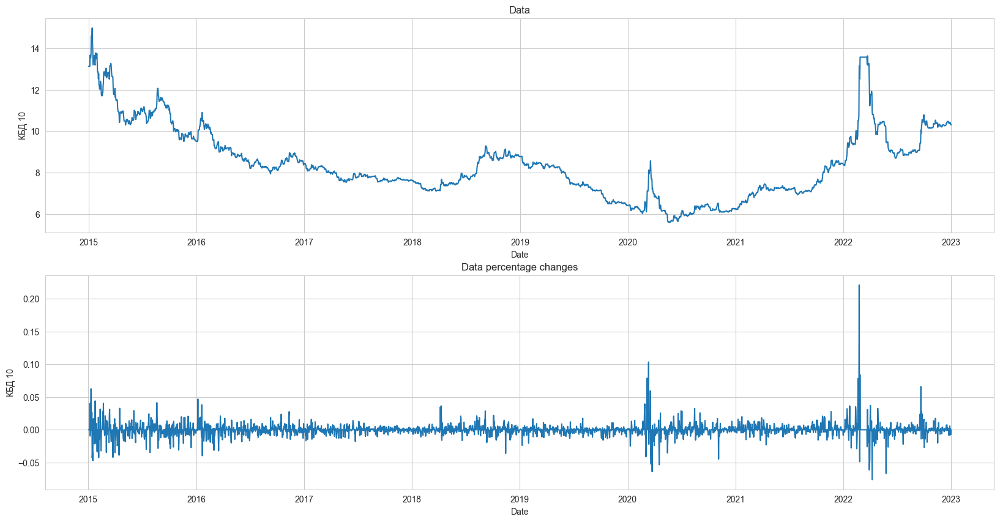

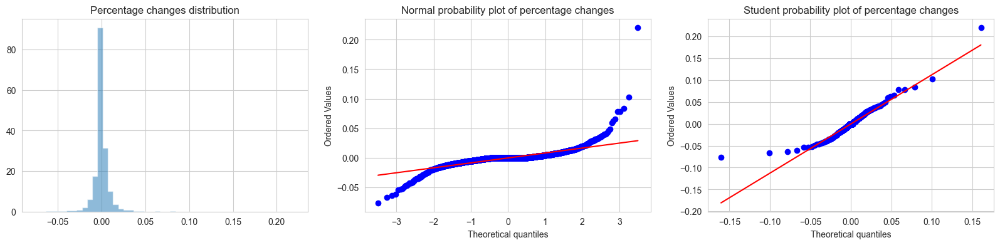

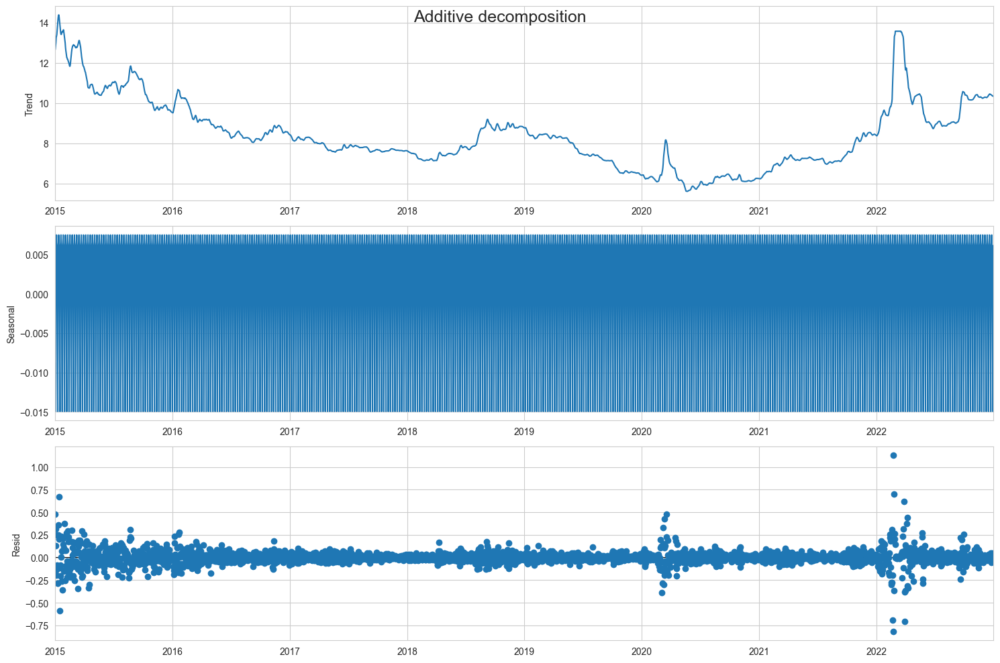

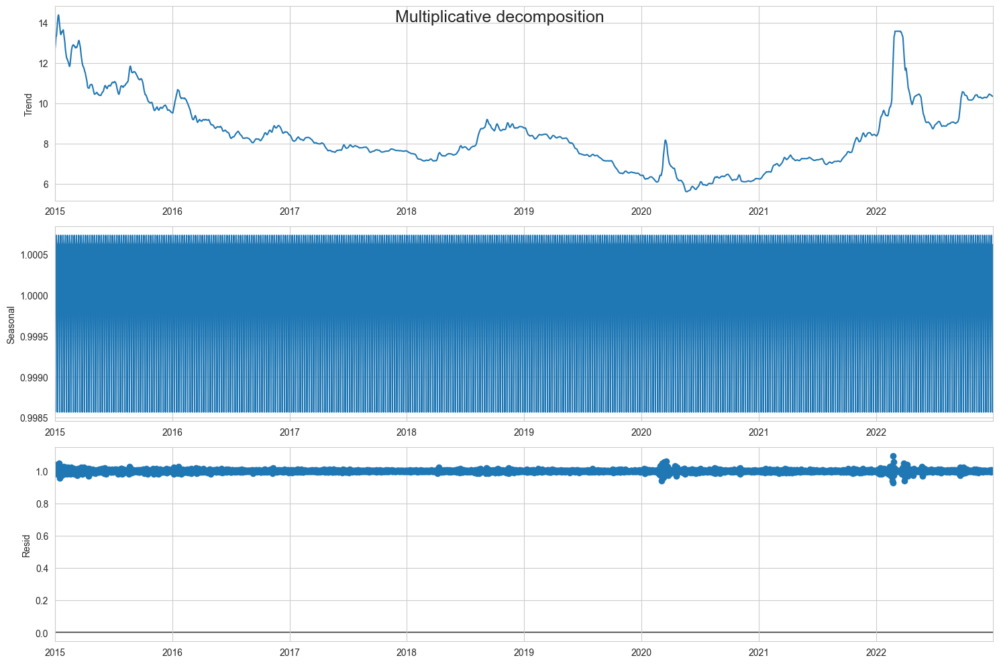

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is stationary.
KPSS test: the series is not stationary.


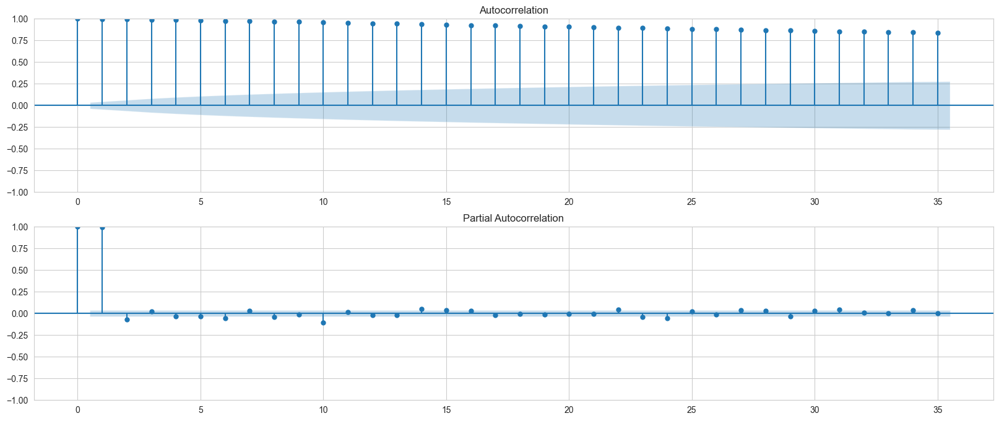


	Diff-1
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
КБД 15


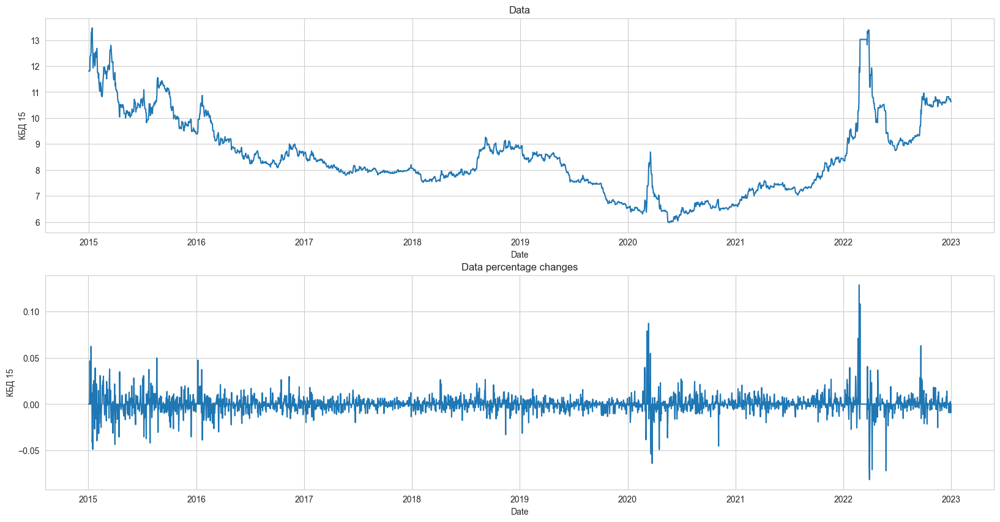

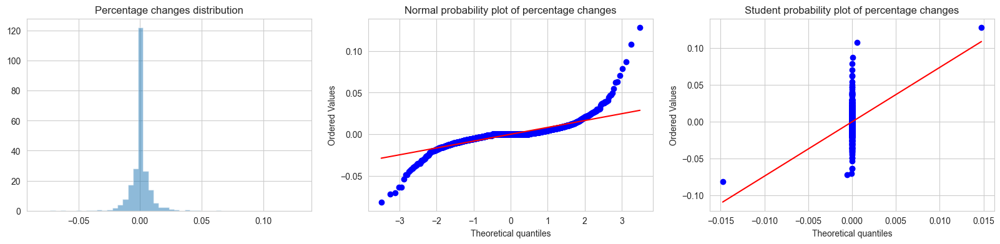

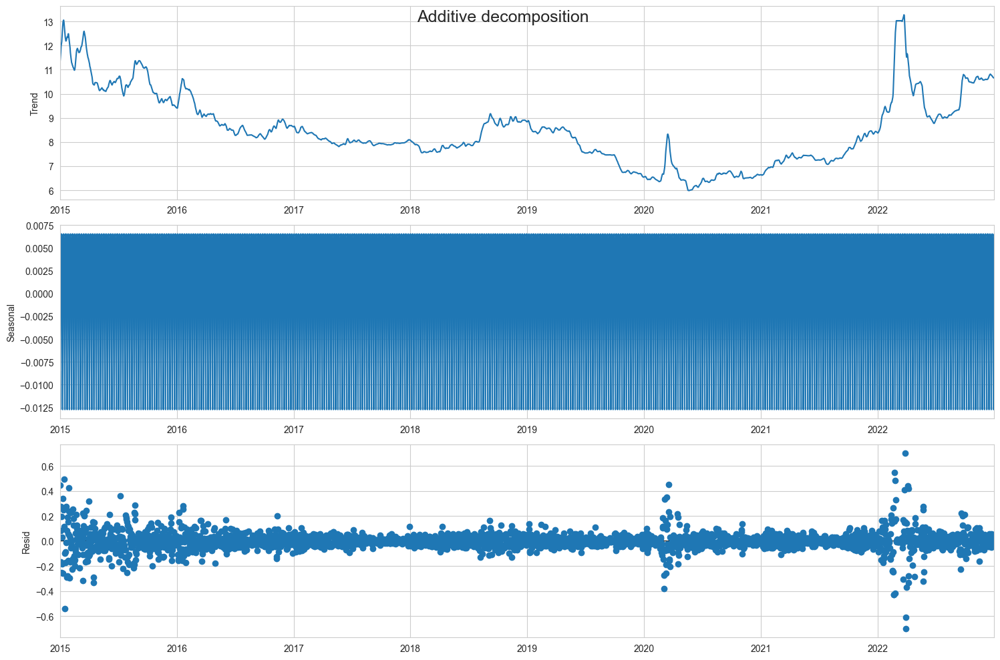

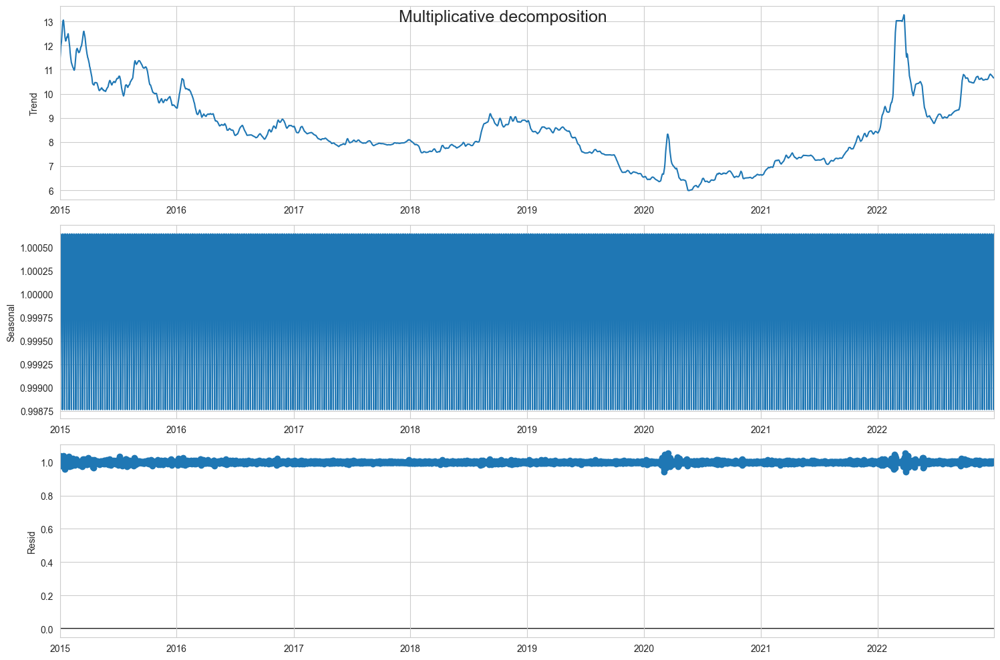

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is stationary.
KPSS test: the series is not stationary.


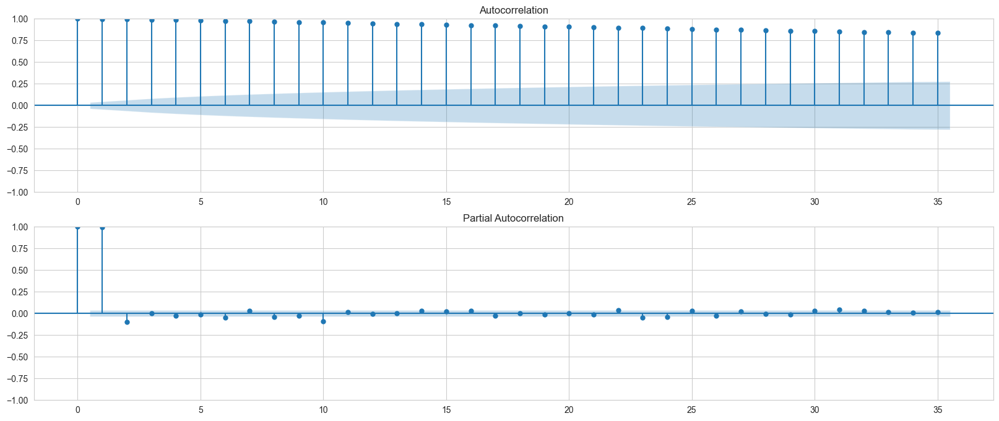


	Diff-1
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
КБД 20


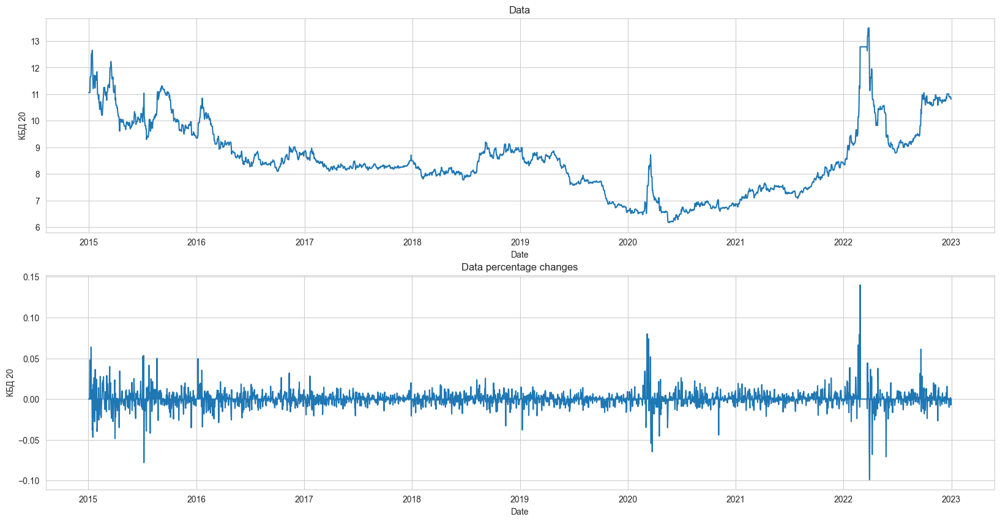

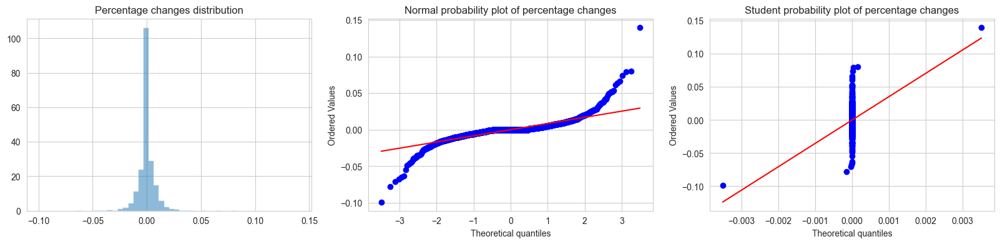

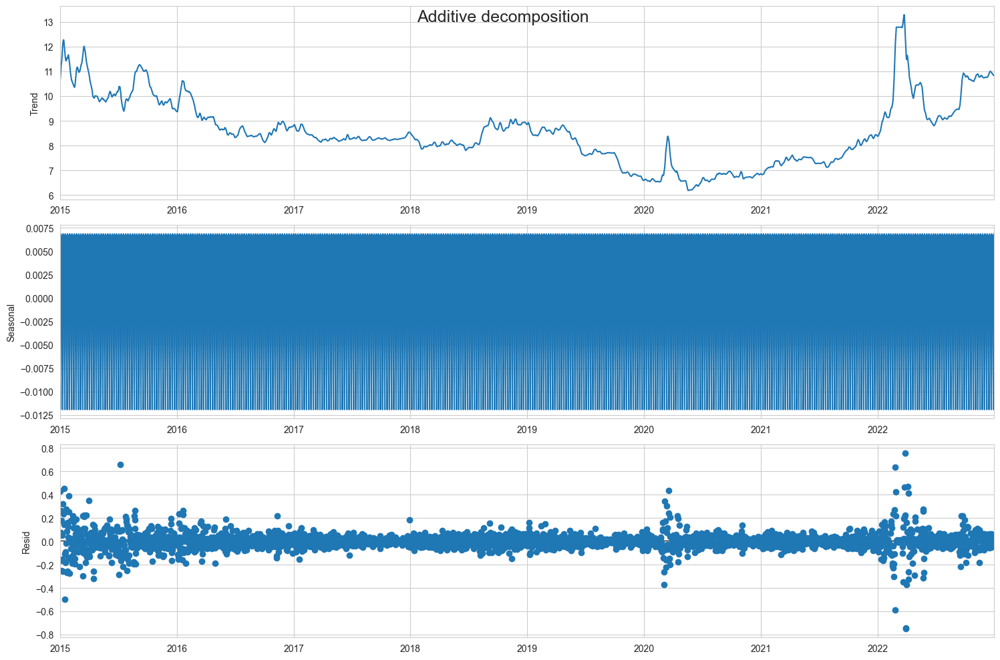

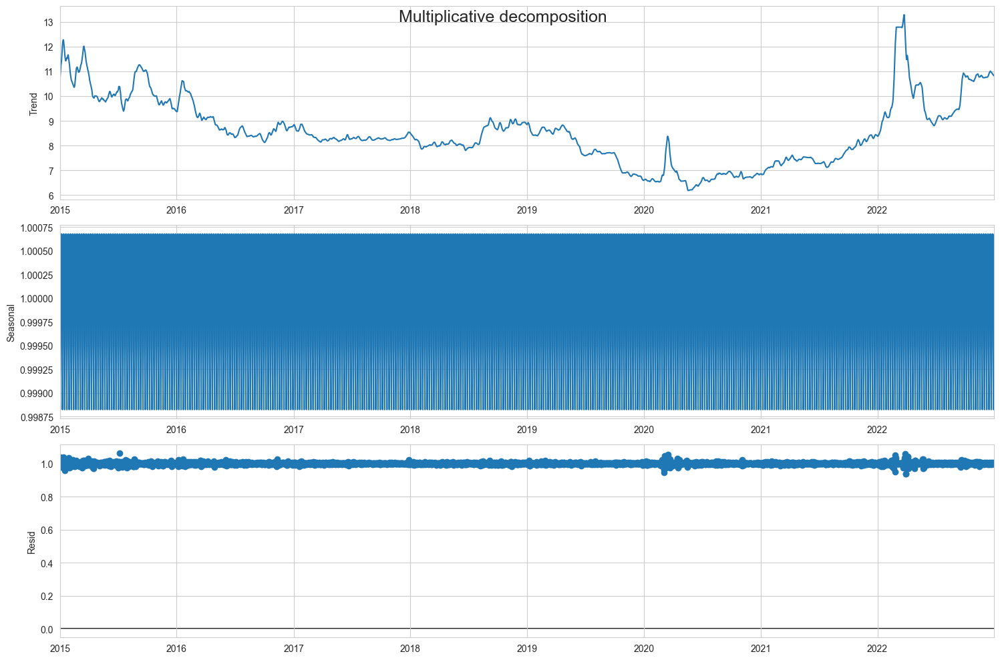

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


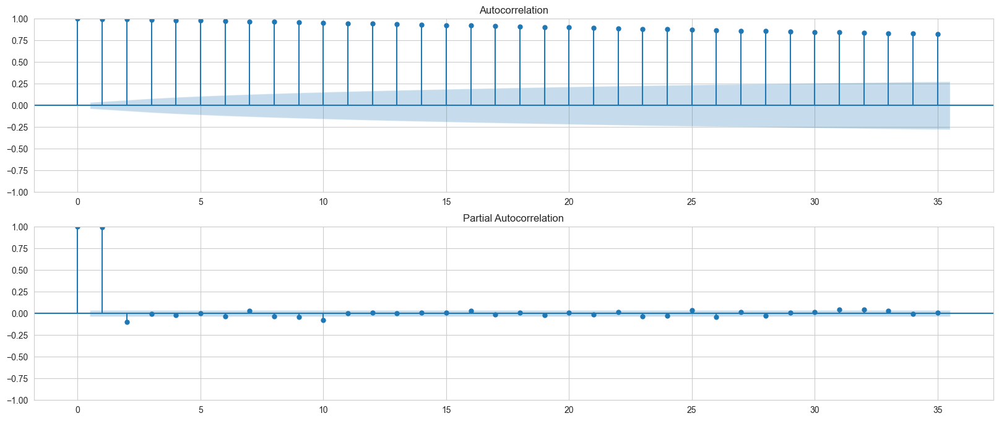


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
КБД 30


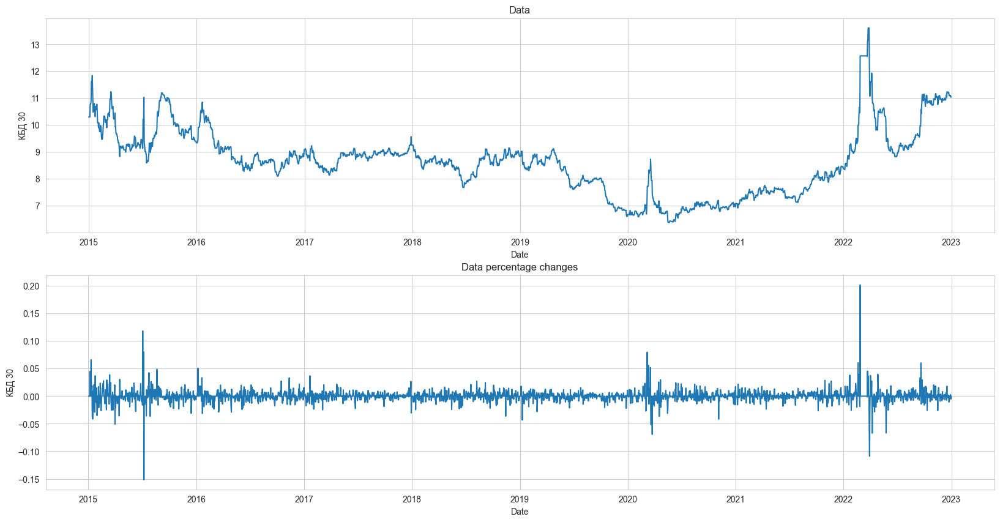

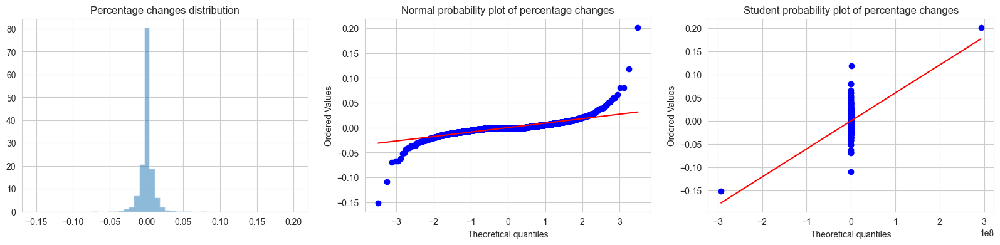

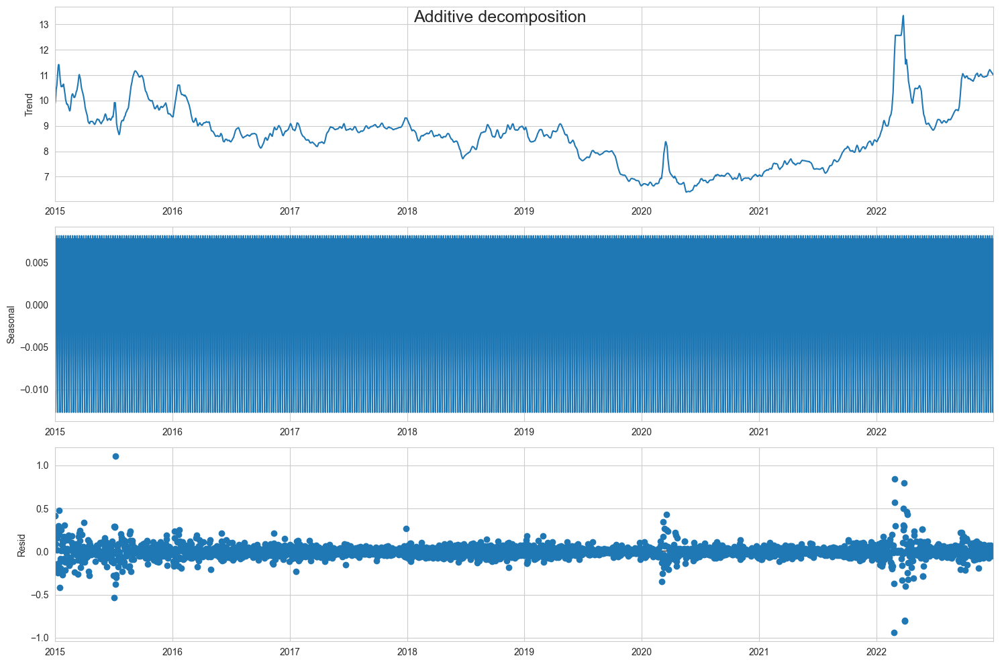

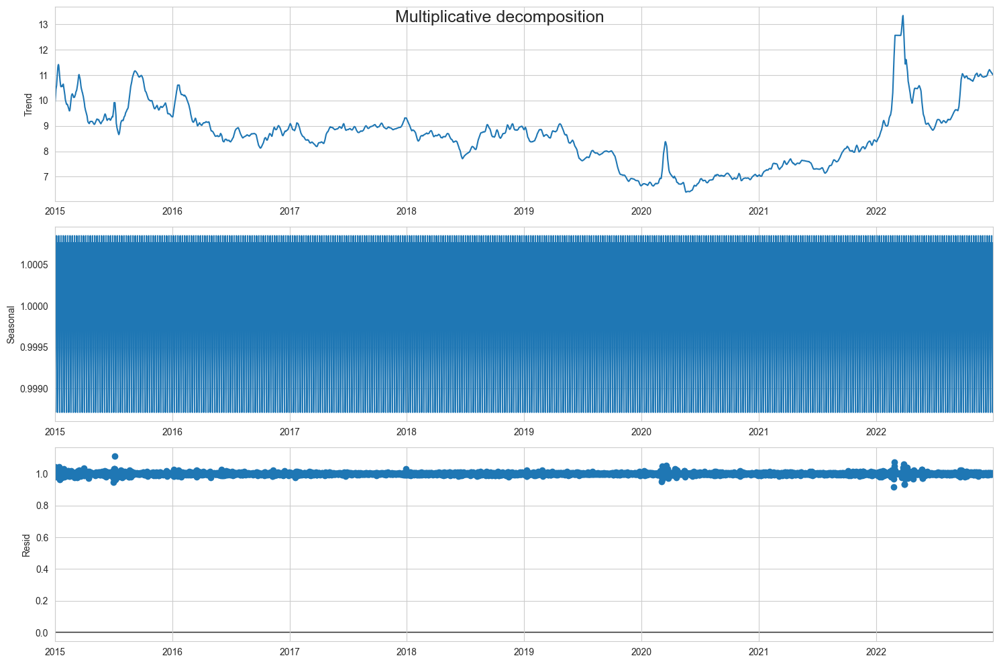

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


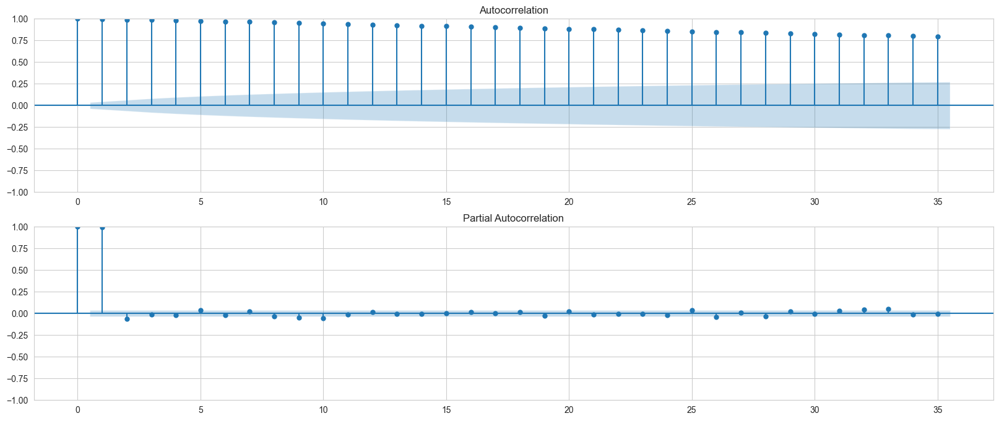


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
НЕФТЬ


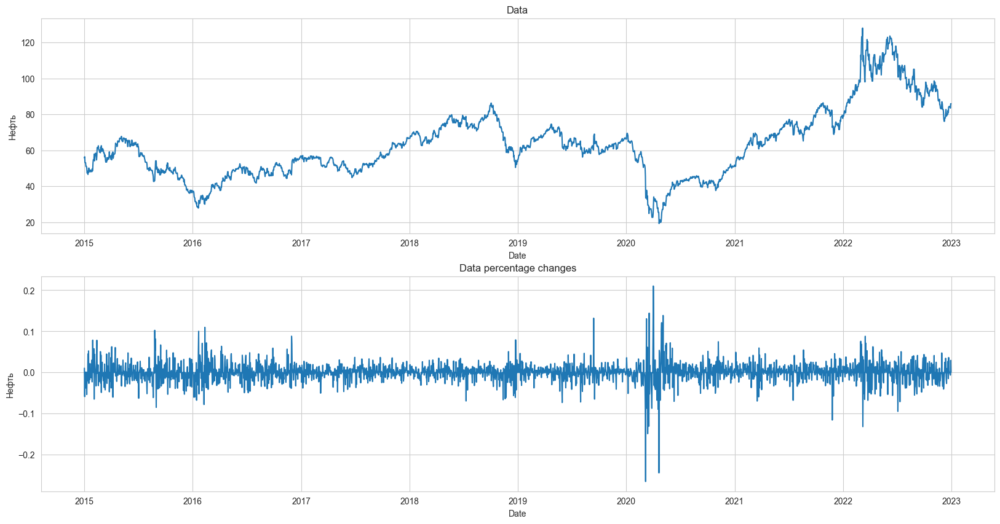

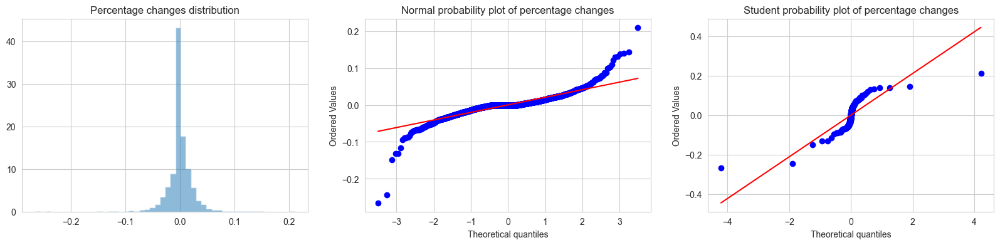

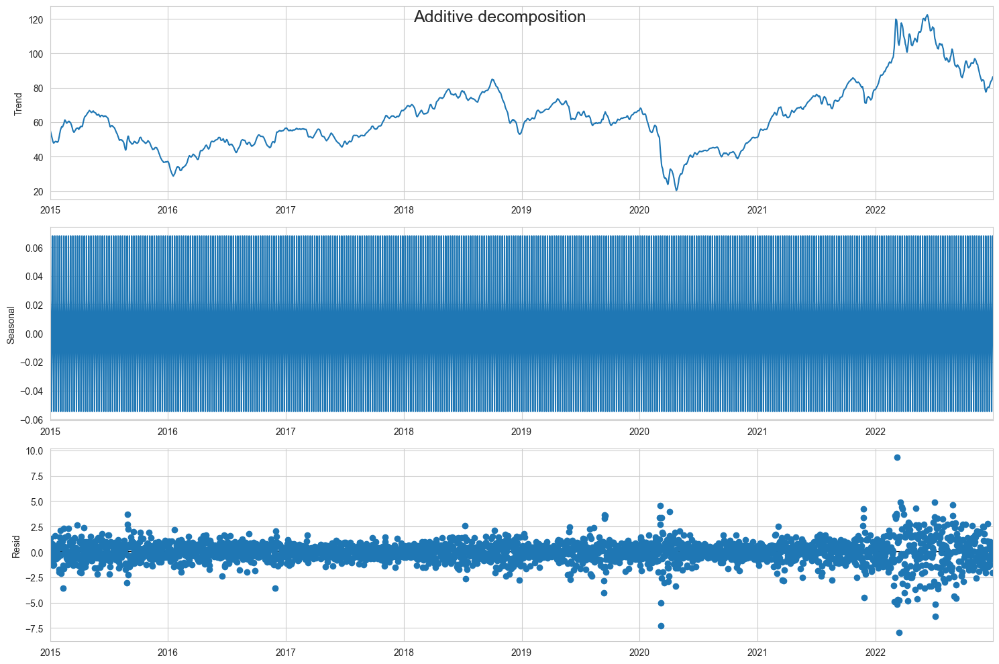

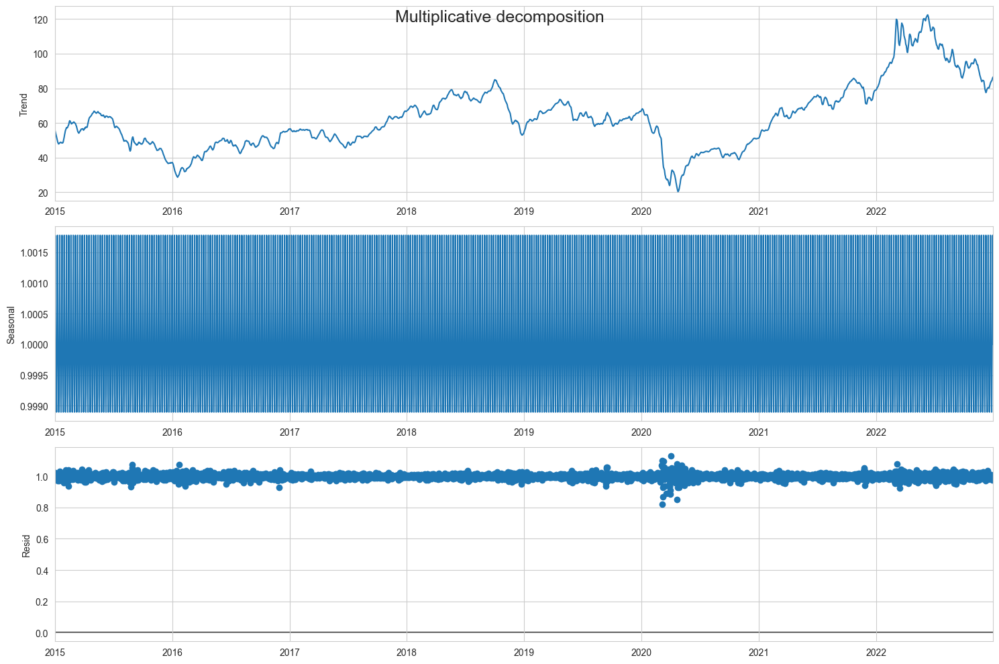

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


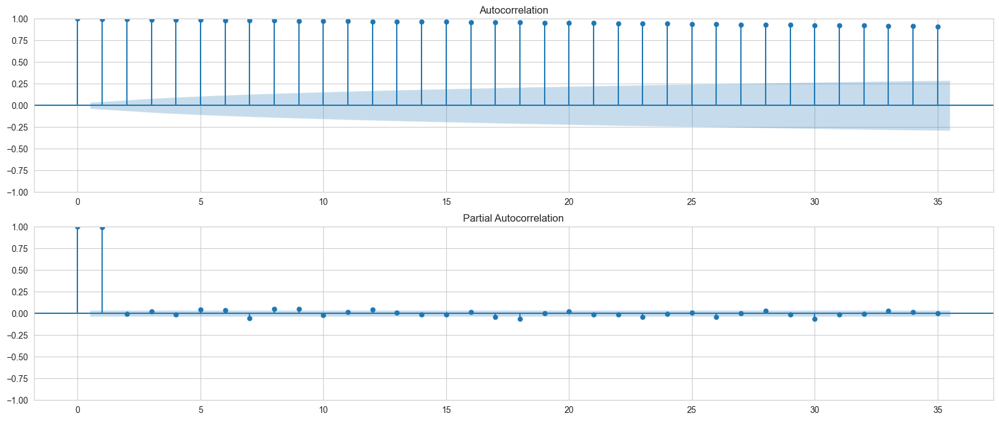


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
МОСБИРЖА


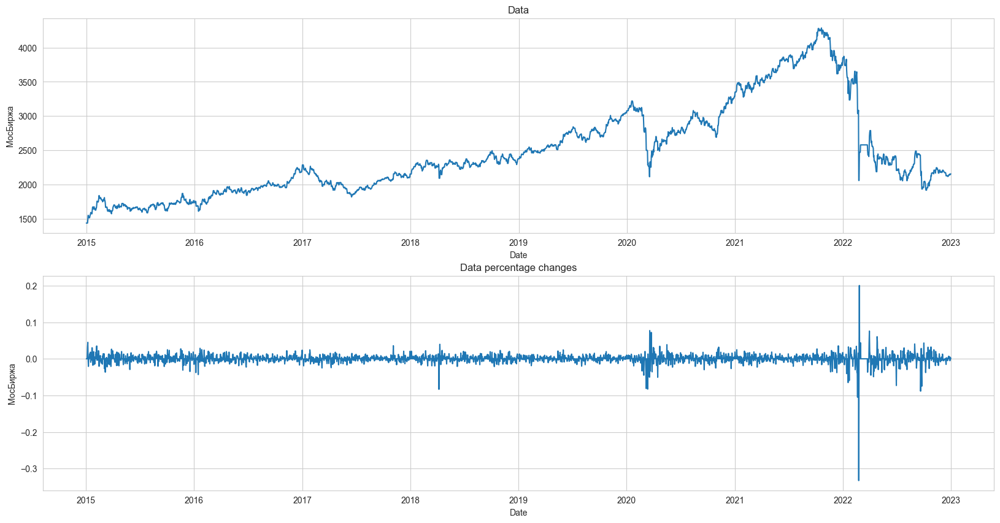

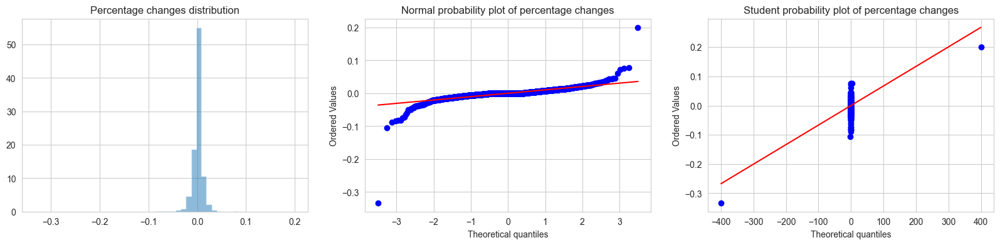

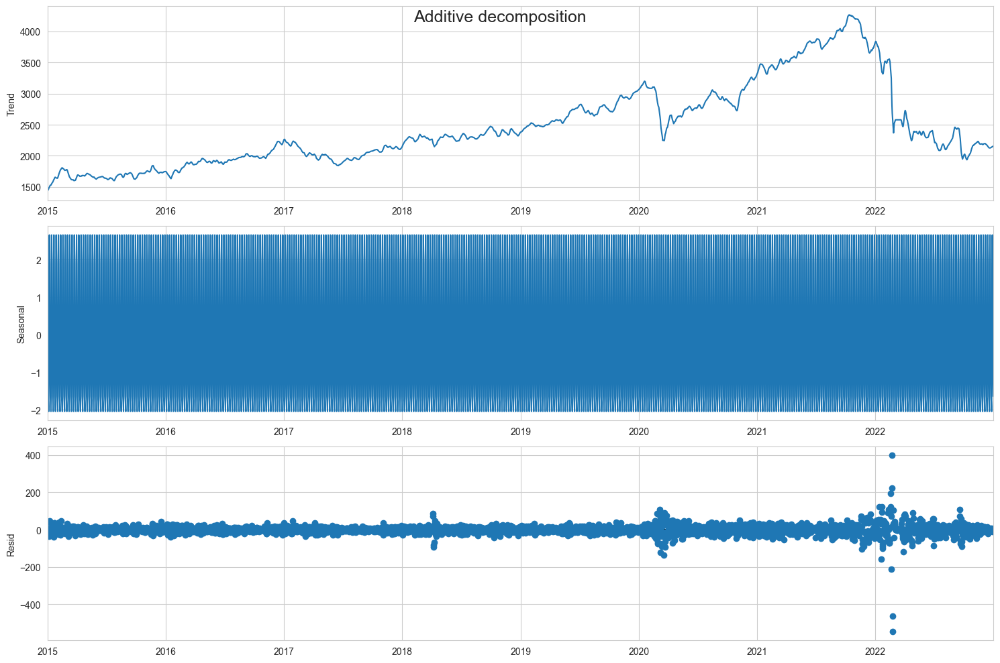

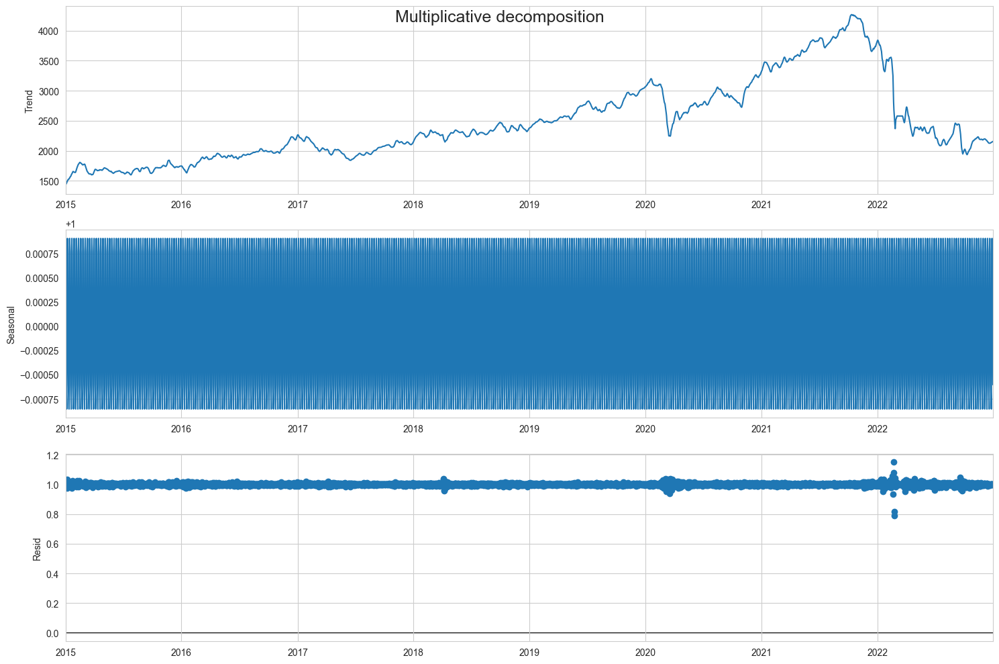

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


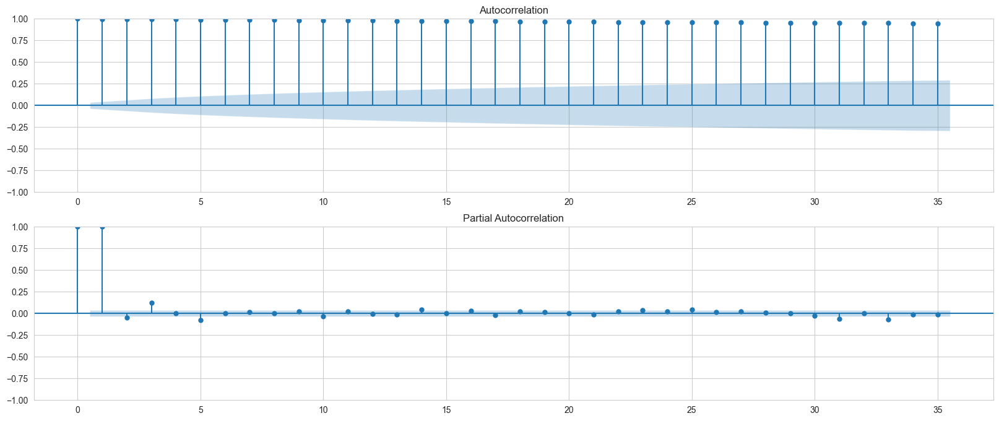


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
РТС


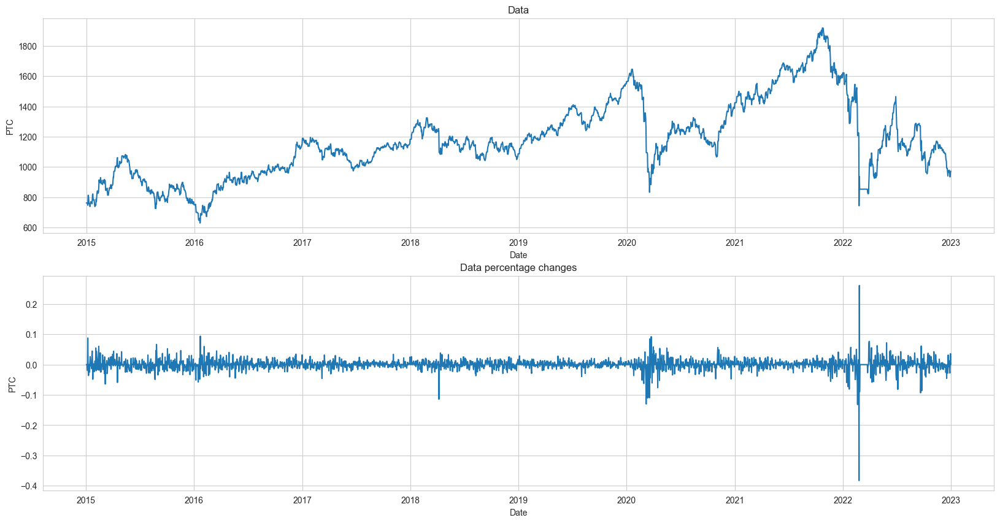

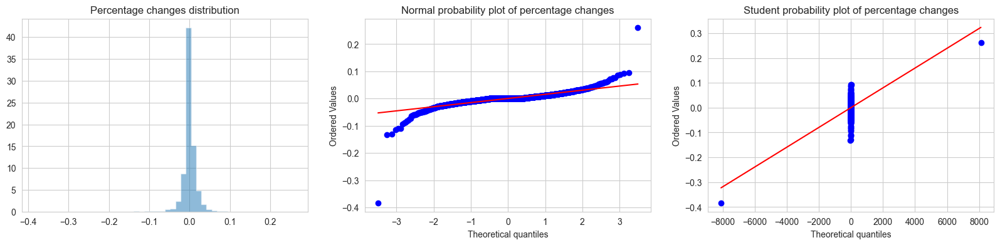

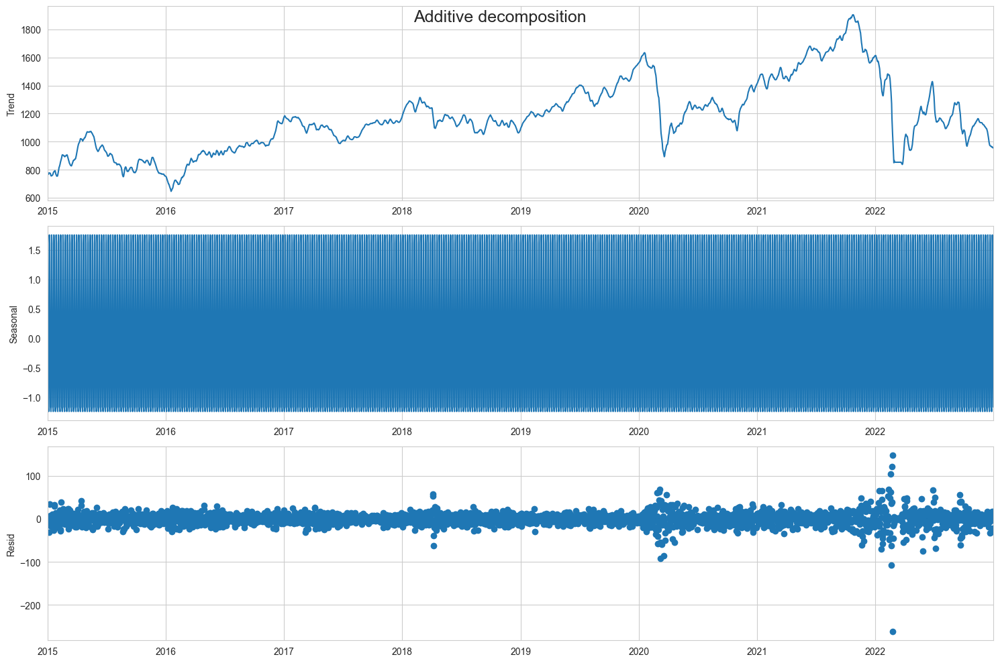

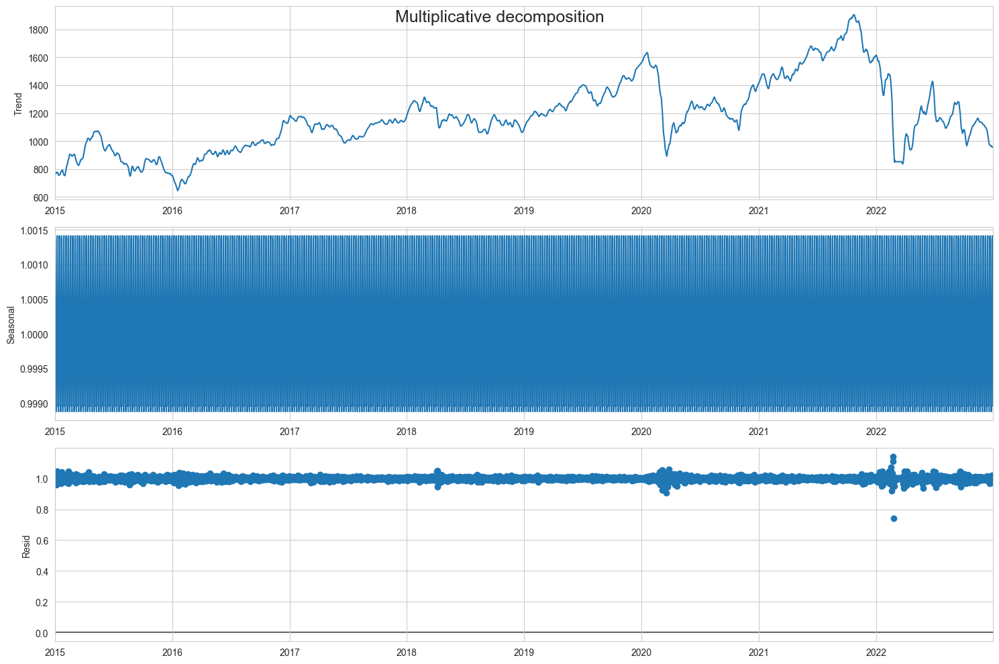

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


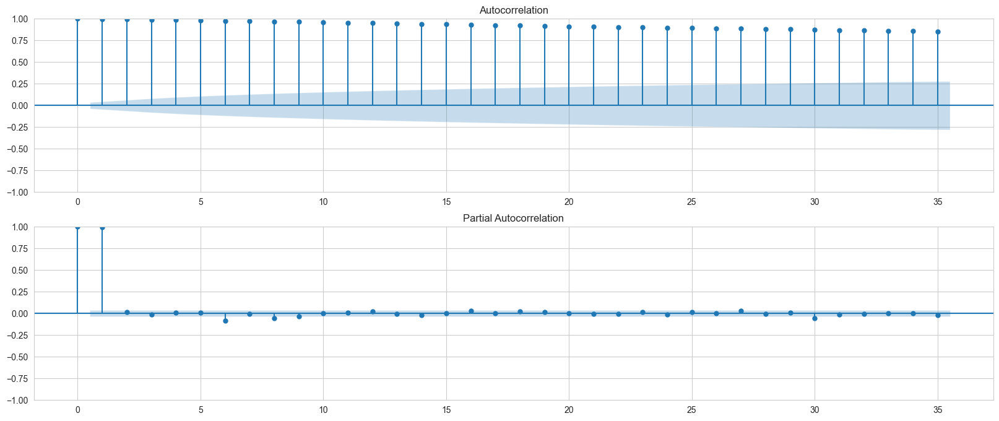


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
ЗОЛОТО


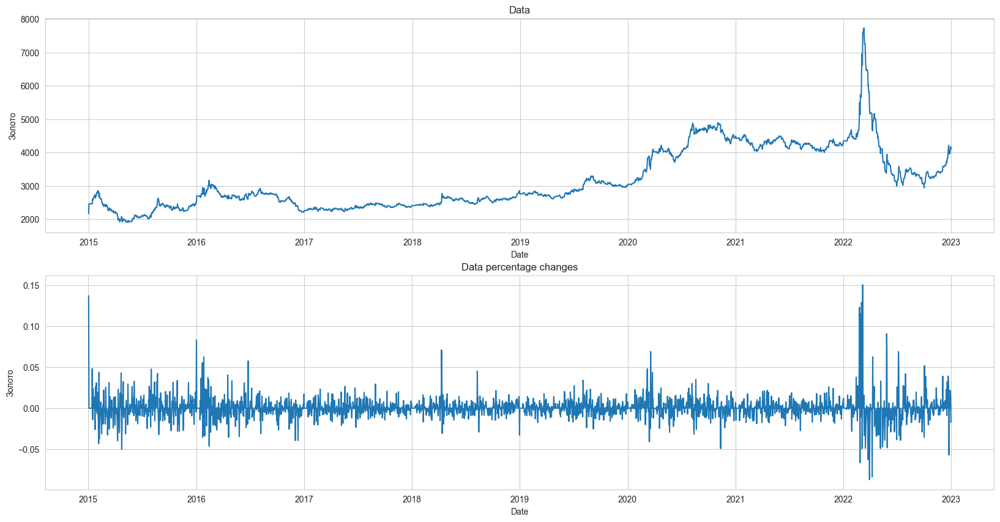

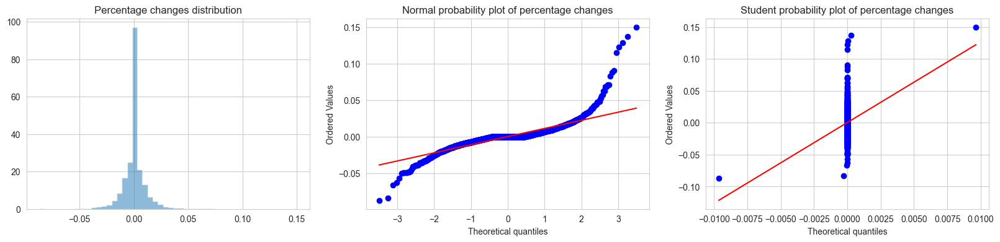

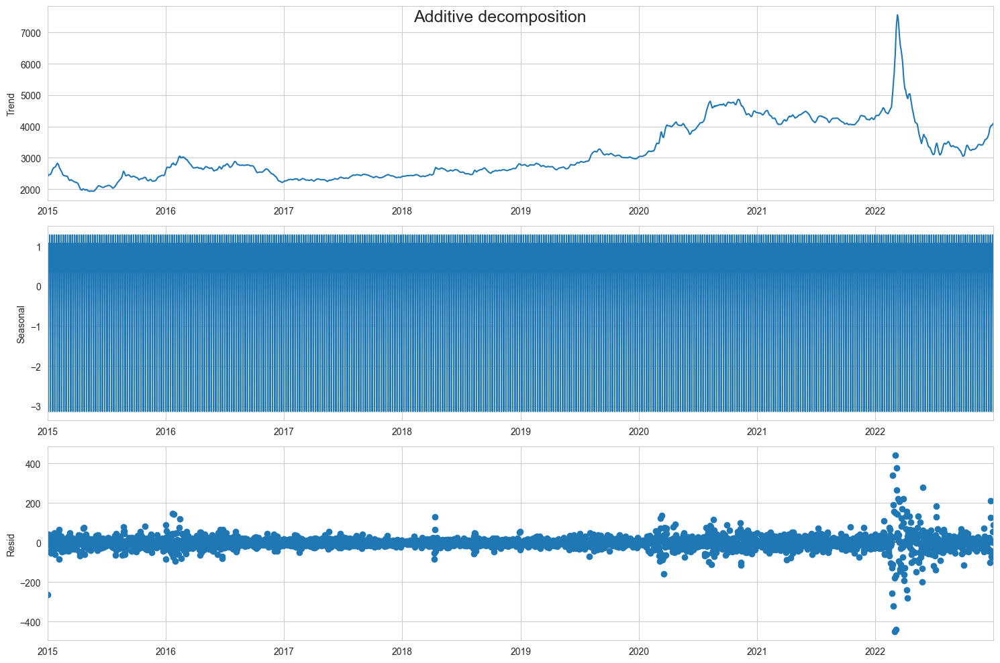

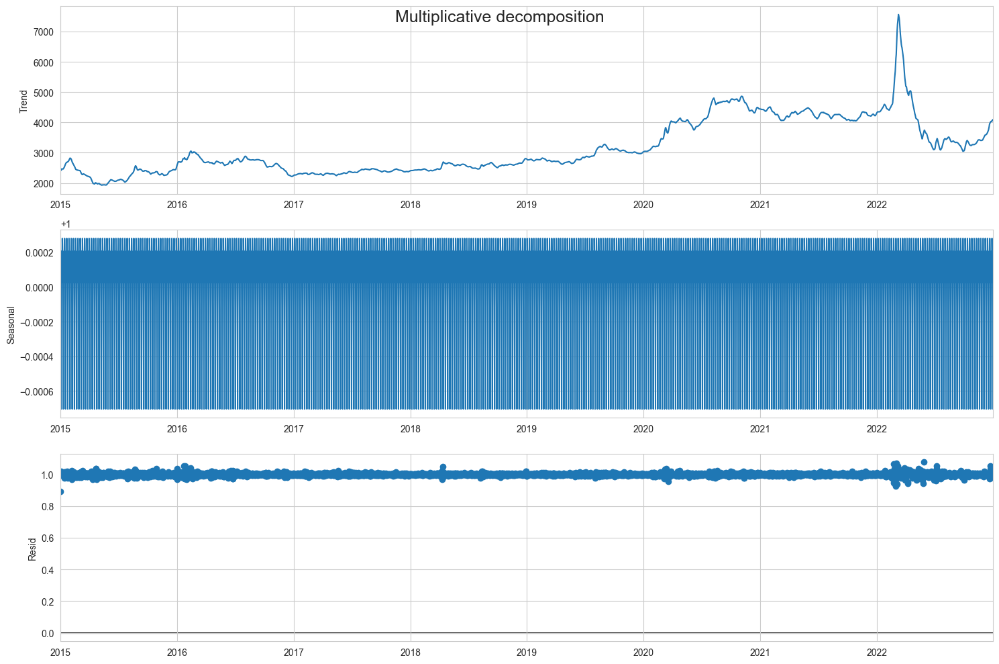

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


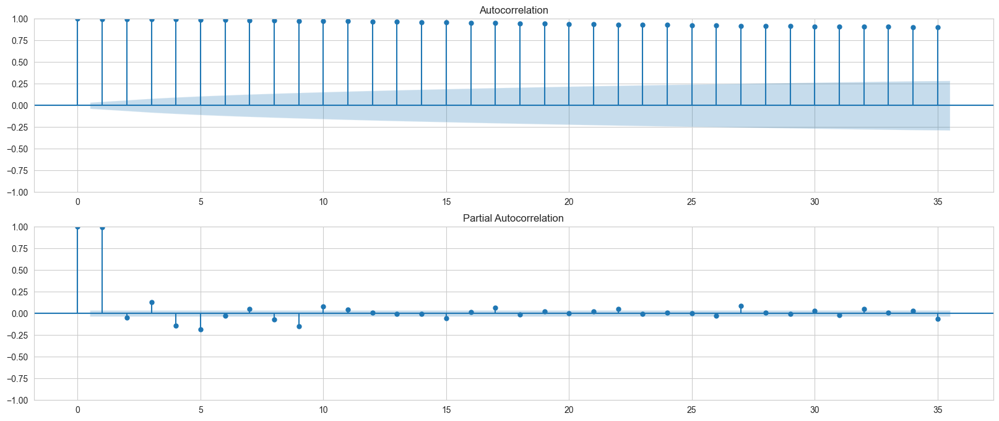


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
СЕРЕБРО


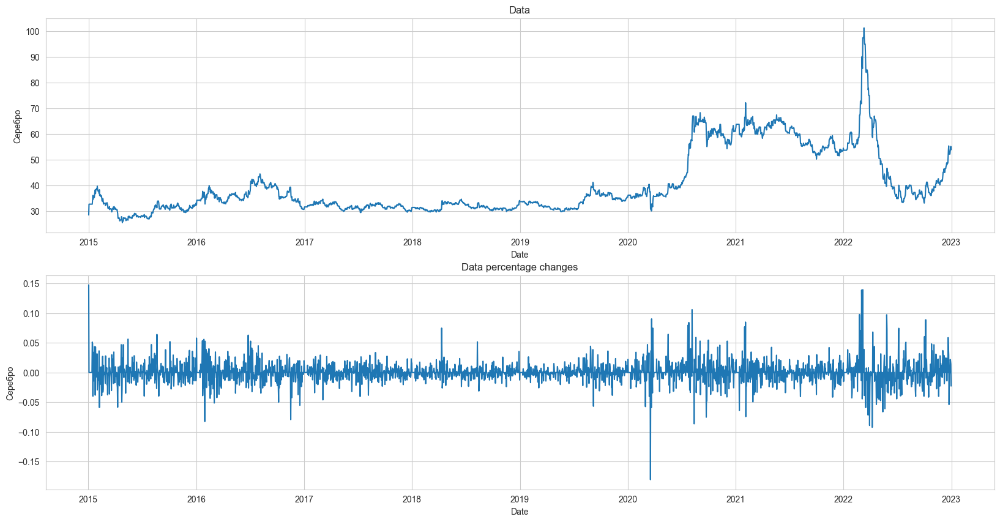

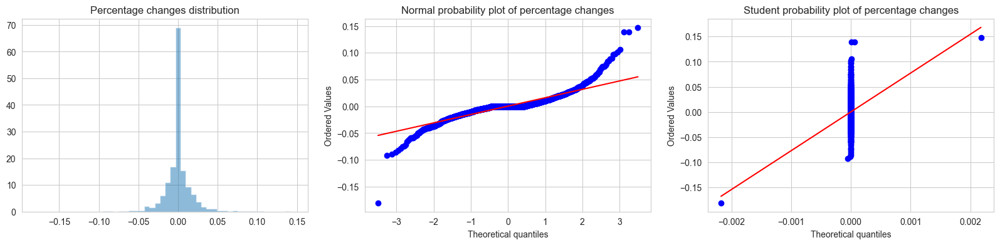

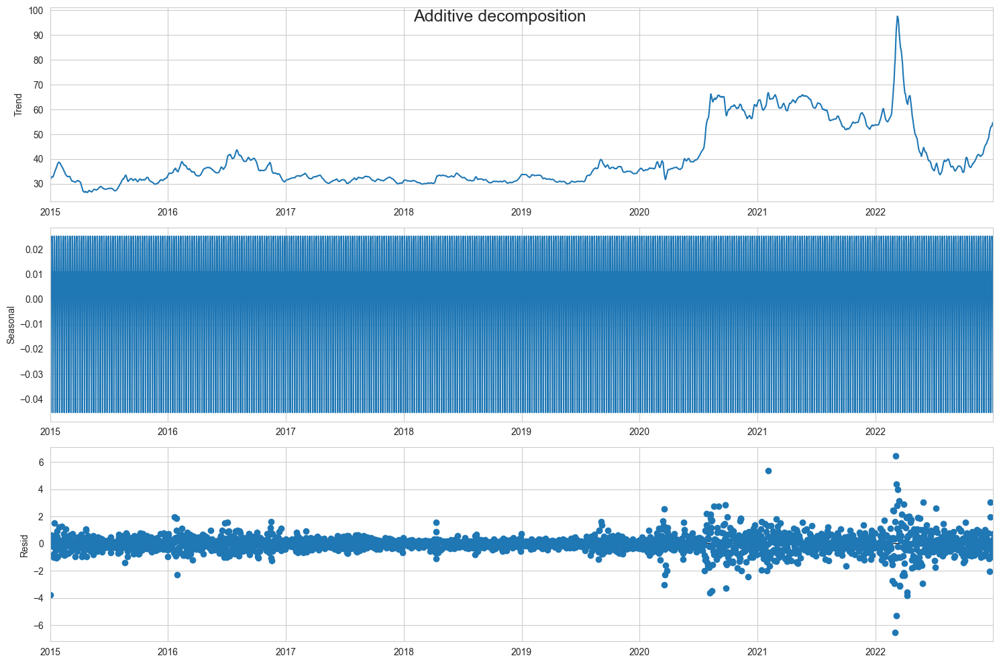

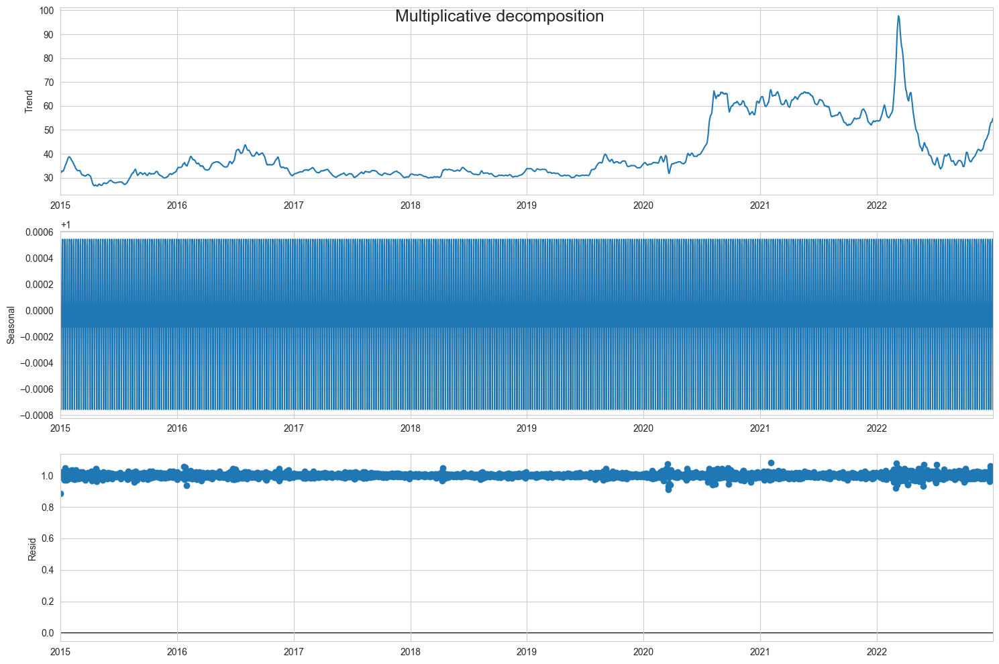

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


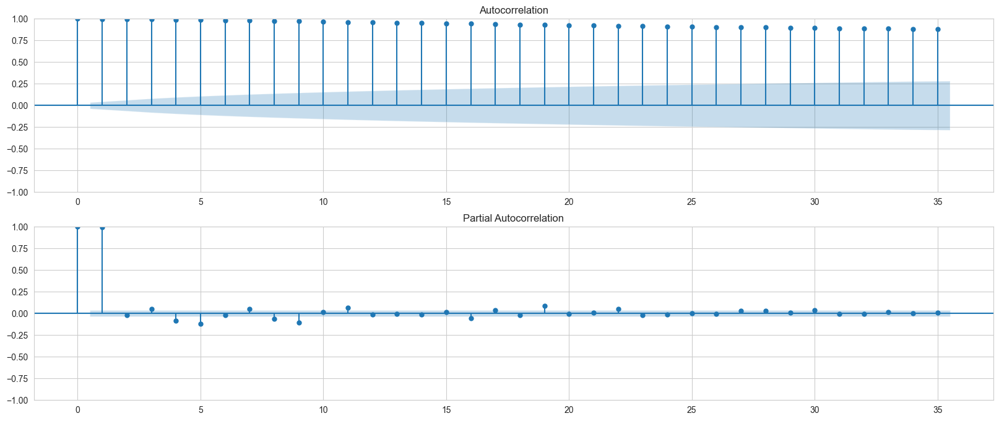


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
ПЛАТИНА


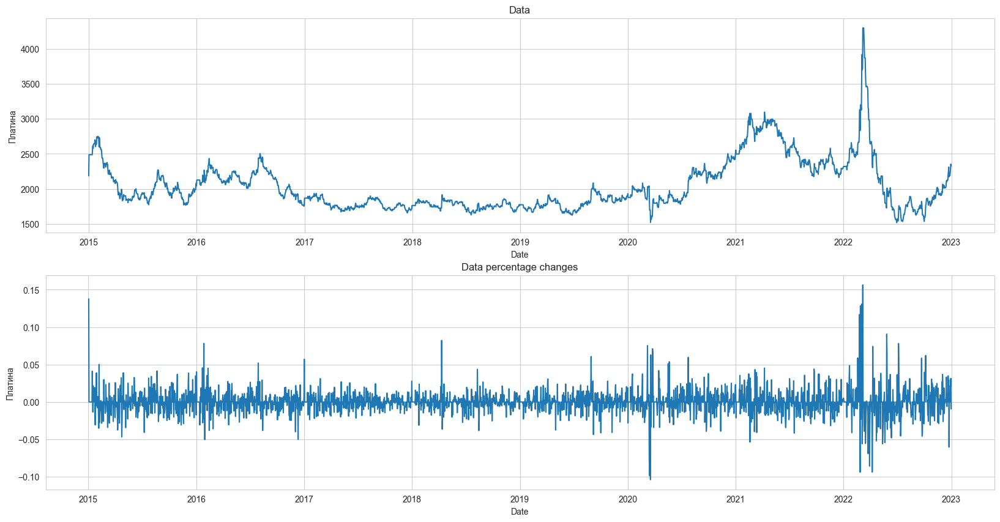

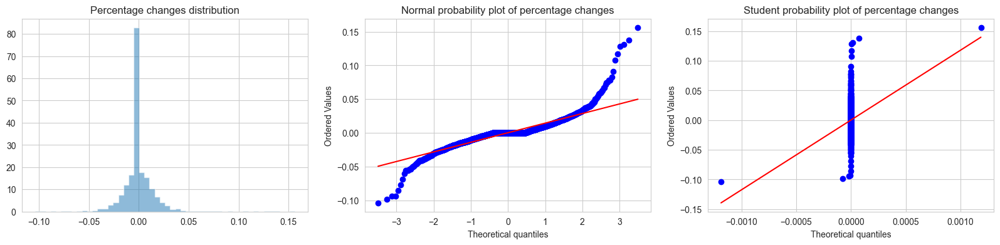

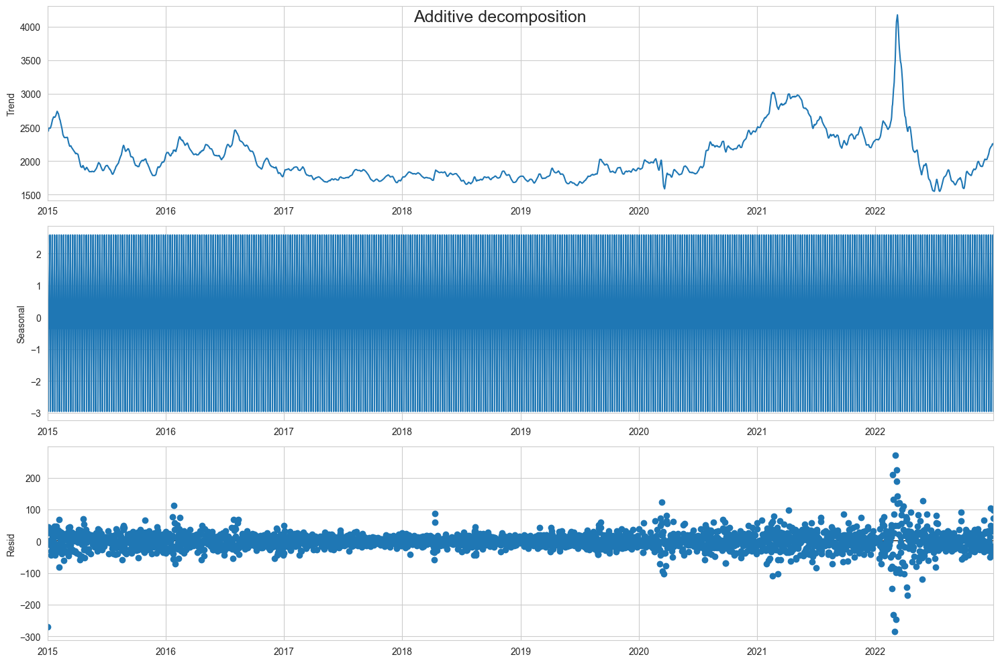

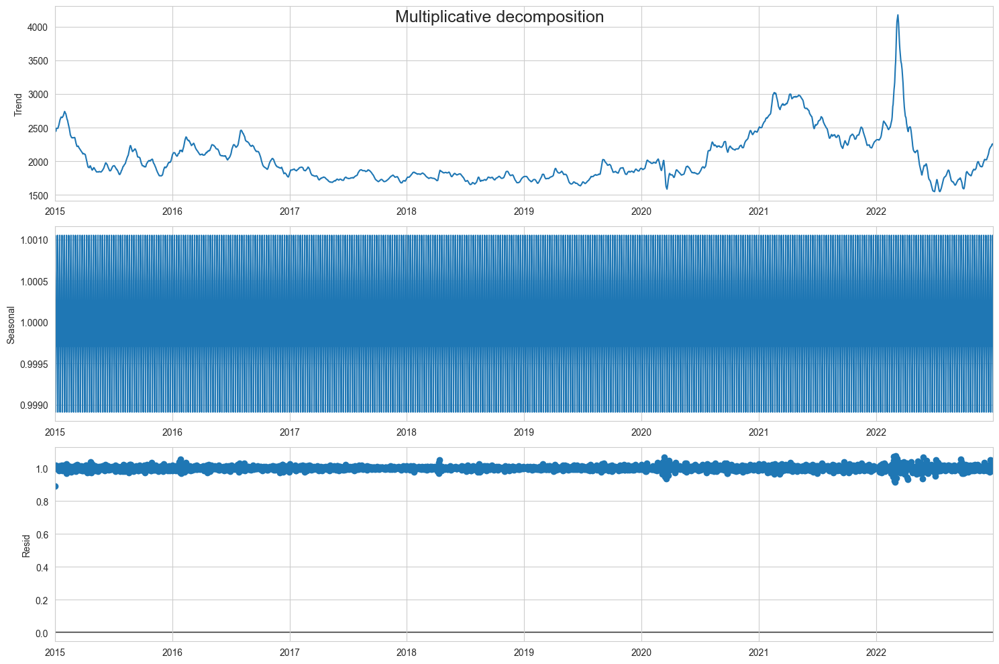

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is stationary.
KPSS test: the series is not stationary.


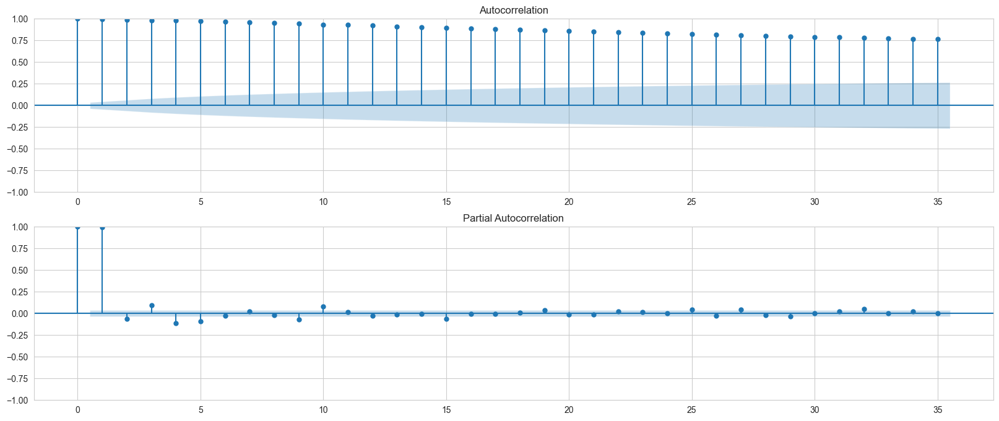


	Diff-1
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is stationary.
KPSS test: the series is not stationary.
**************************************************
КУРС ДОЛЛАРА


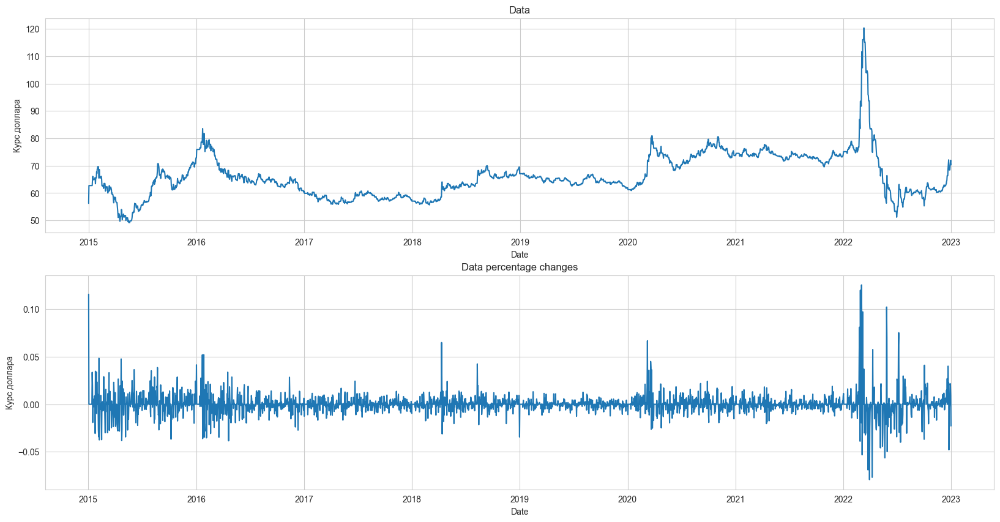

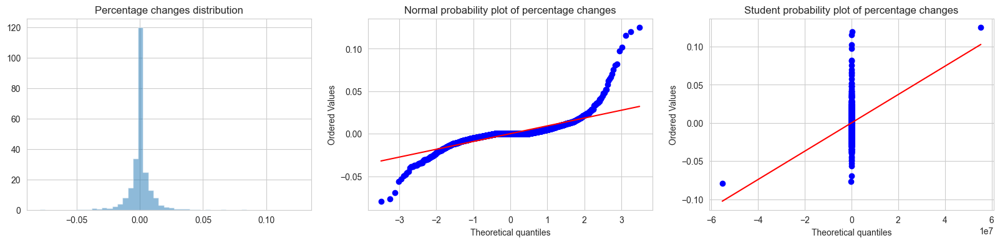

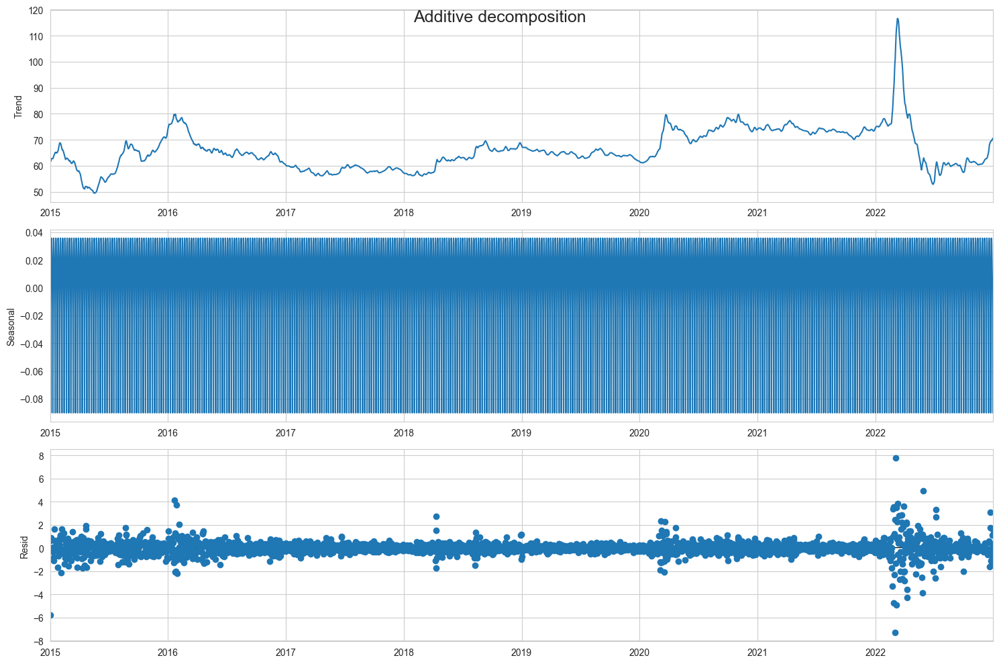

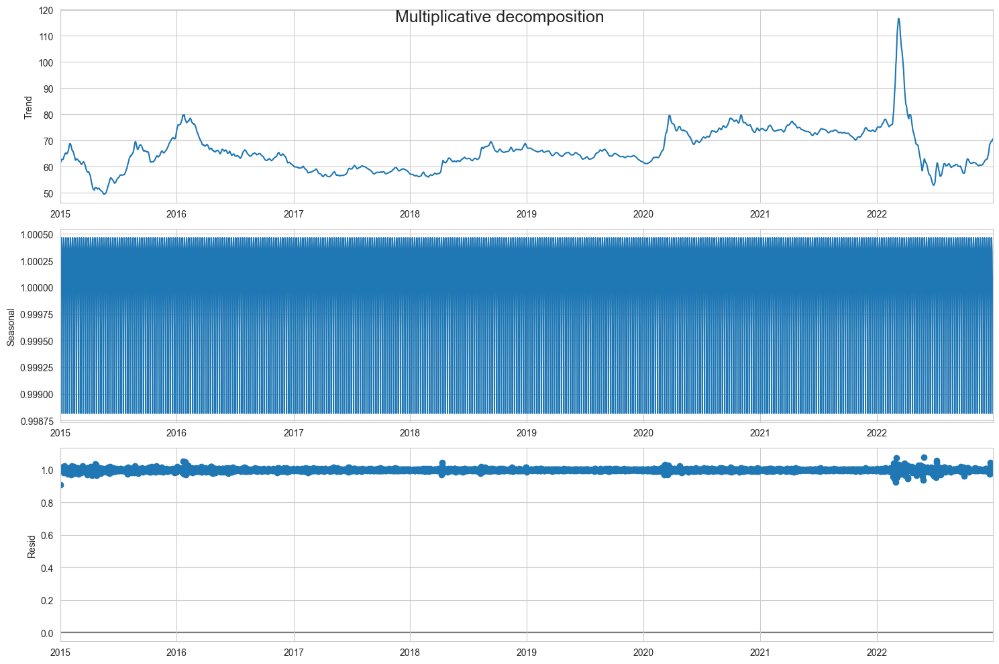

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is stationary.
KPSS test: the series is not stationary.


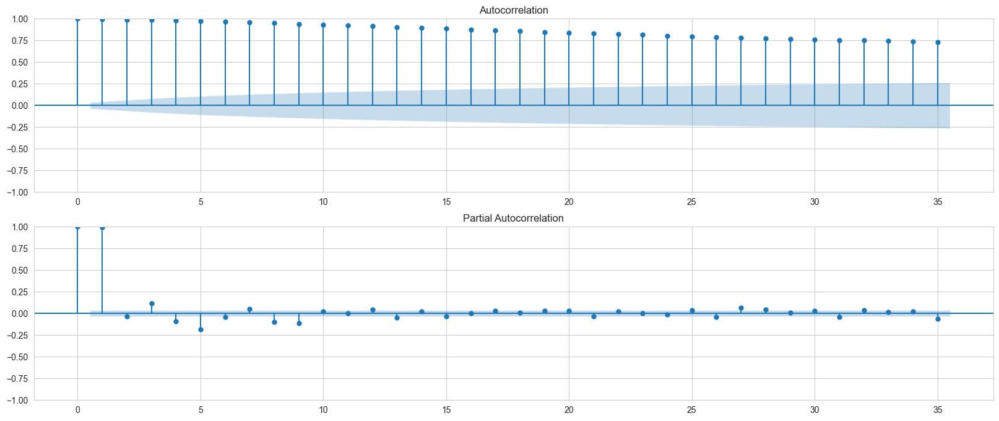


	Diff-1
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is stationary.
KPSS test: the series is stationary.
**************************************************
КУРС ЕВРО


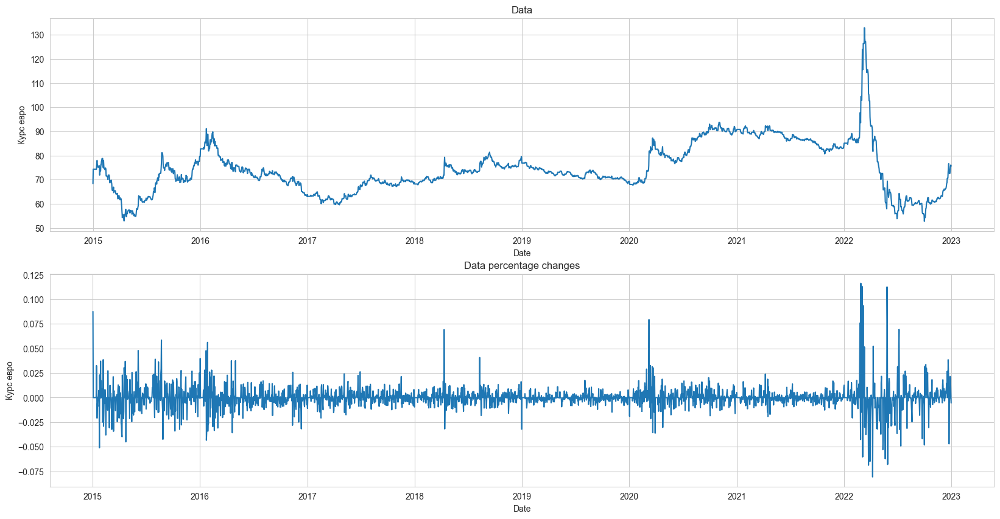

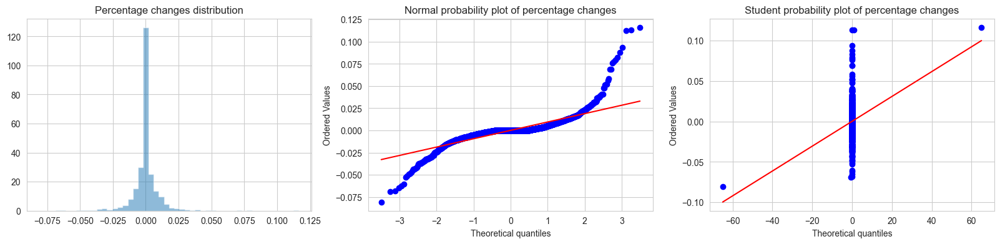

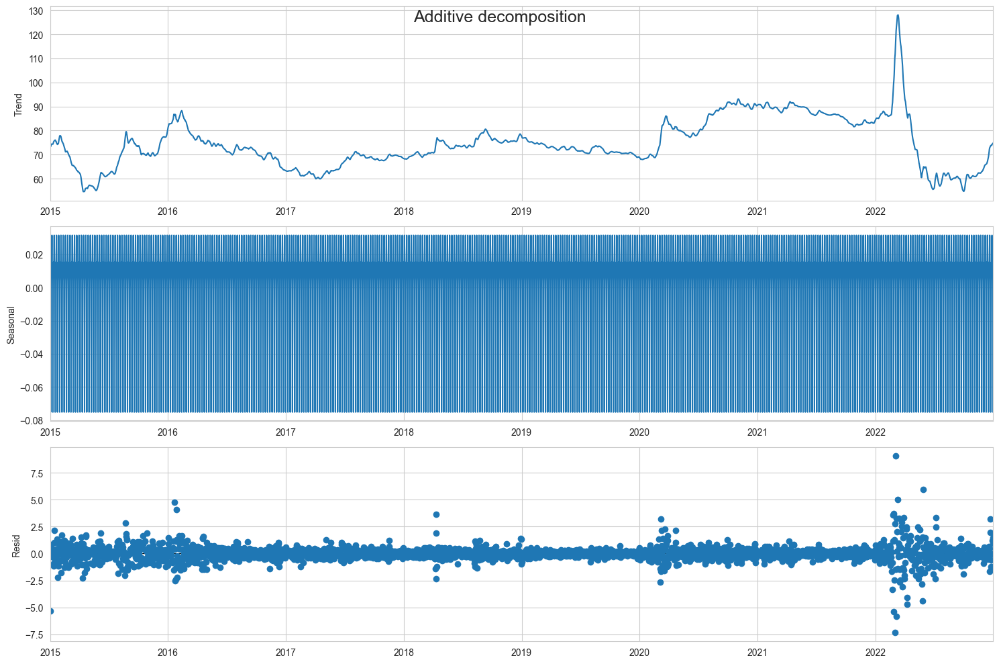

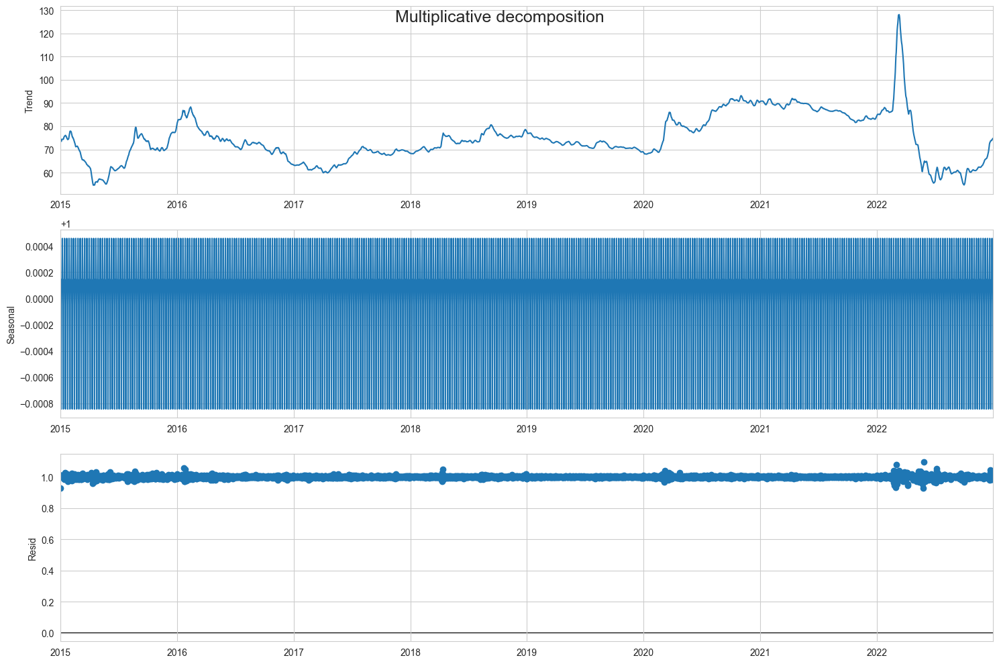

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is stationary.
KPSS test: the series is not stationary.


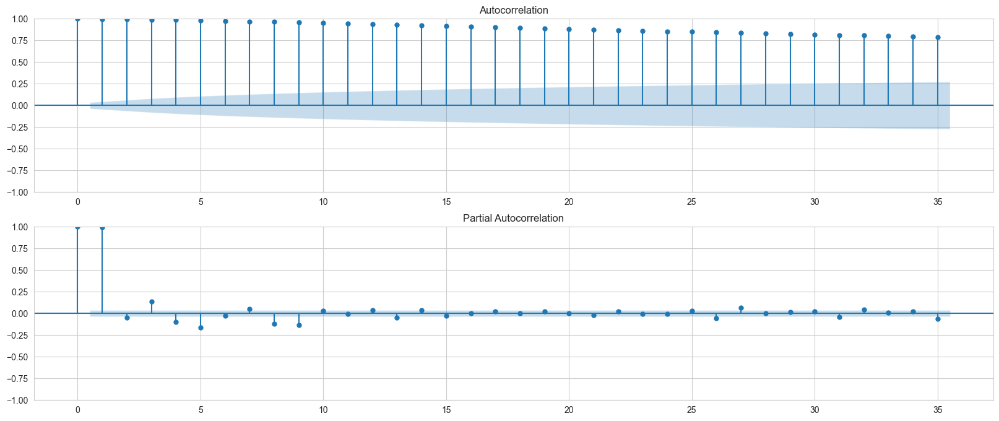


	Diff-1
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is stationary.
KPSS test: the series is not stationary.
**************************************************


In [19]:
for factor in risk_factors:
    fd = FactorDescriptor(data.set_index('Date')[factor])
    print(f'{factor.upper()}')
    fd.full_info()
    print('*' * 50)

## Stocks analysis

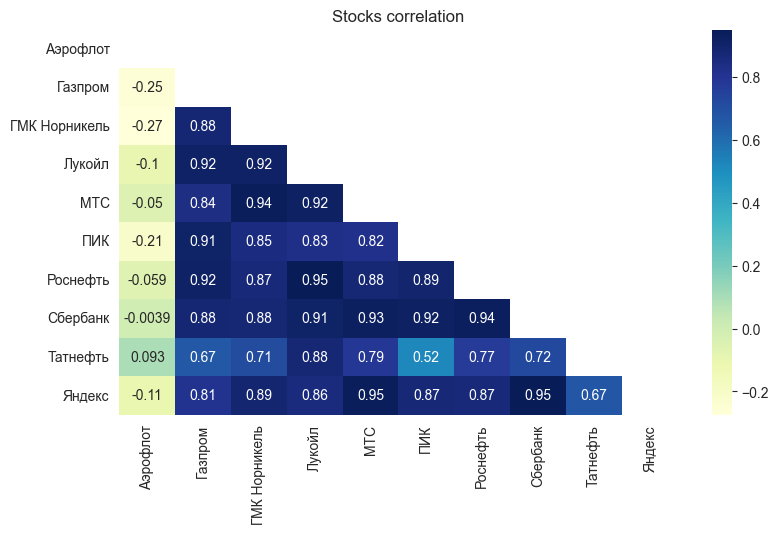

In [20]:
plot_corr(data[stocks])
plt.title('Stocks correlation')
plt.show()

Pairwise relationships of market stocks:

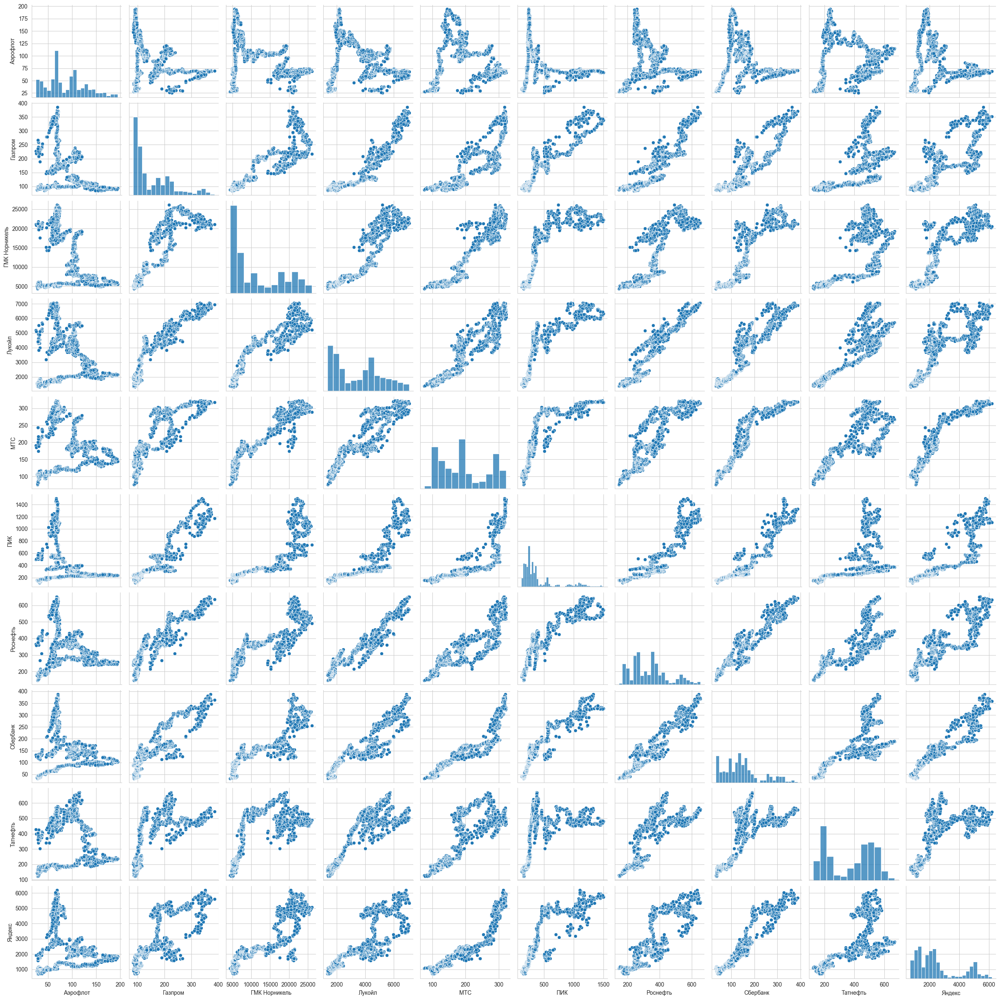

In [33]:
sns.pairplot(data[stocks])
plt.show()

АЭРОФЛОТ


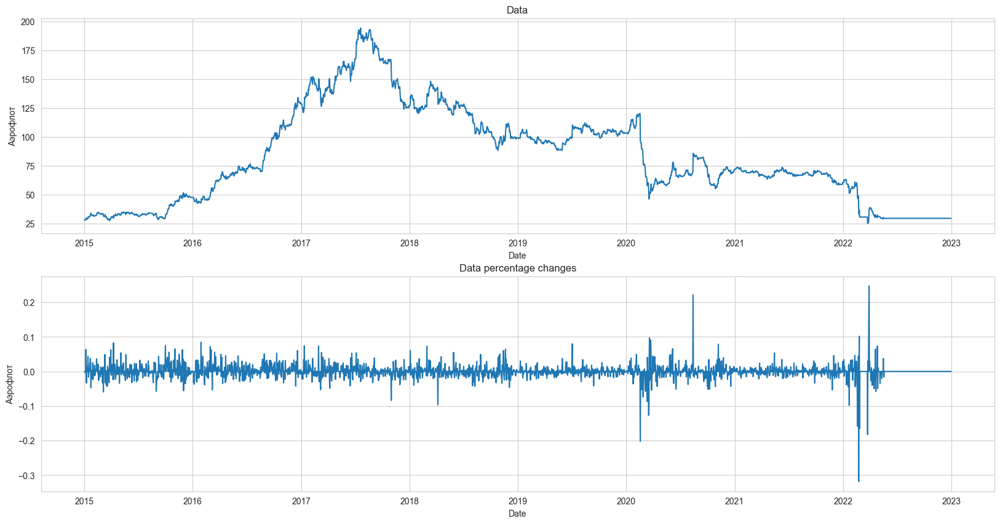

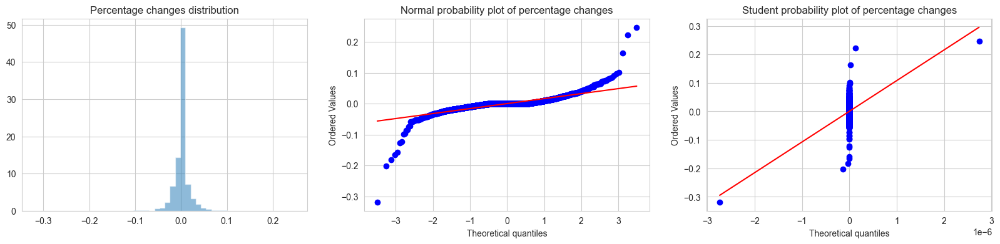

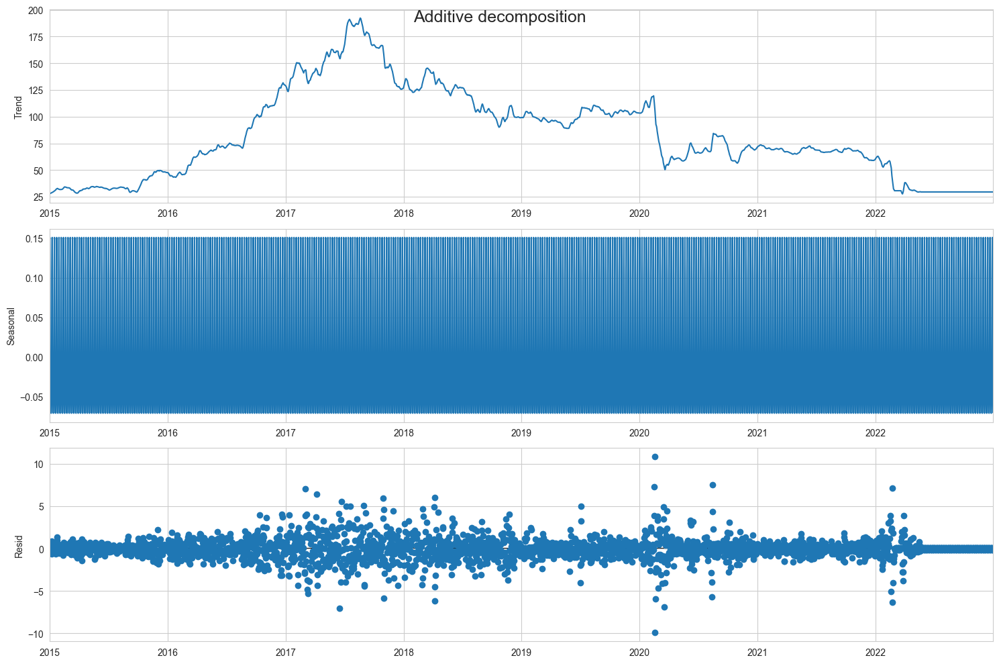

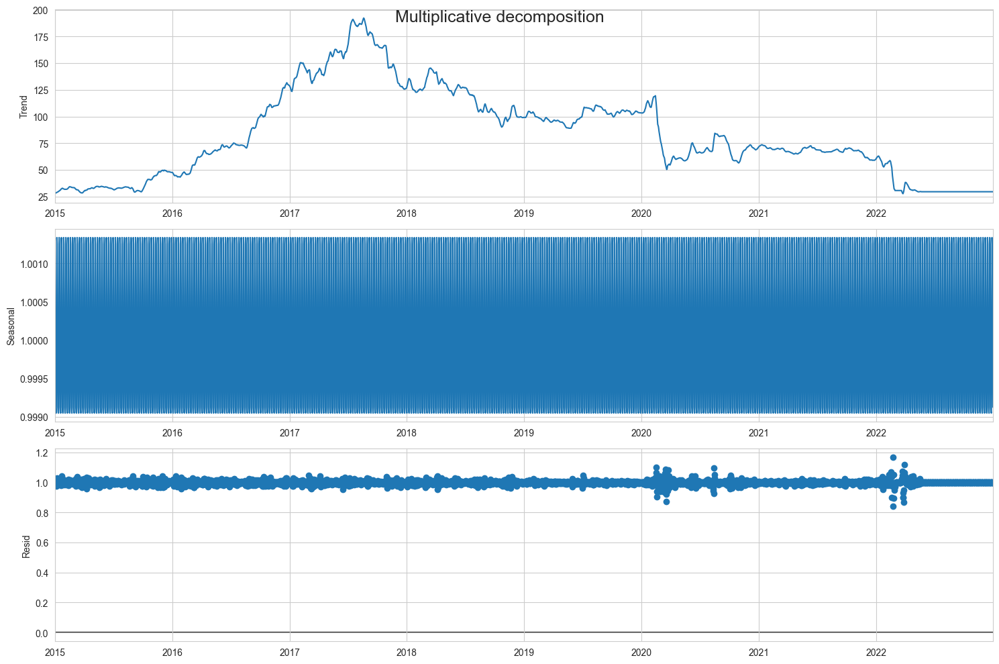

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


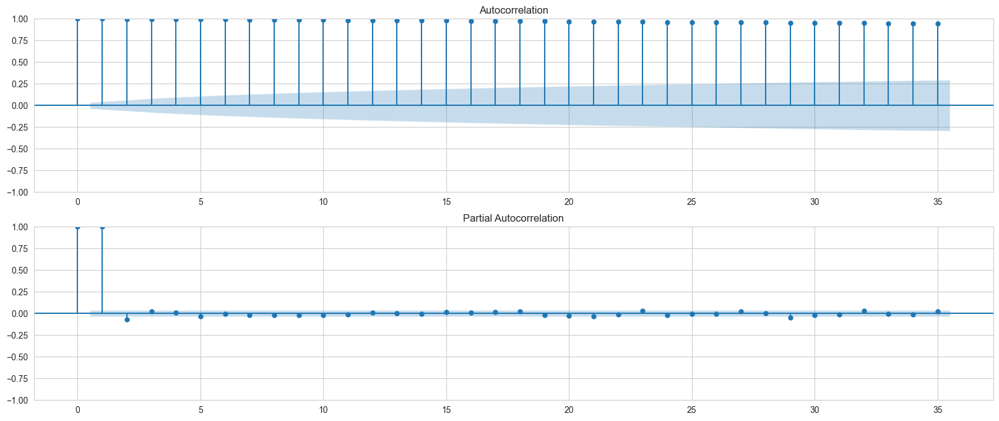


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
ГАЗПРОМ


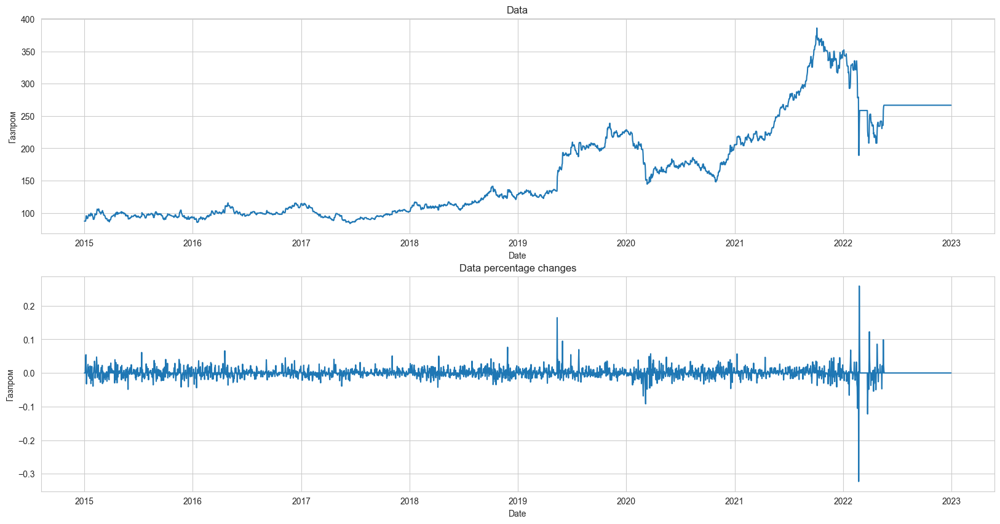

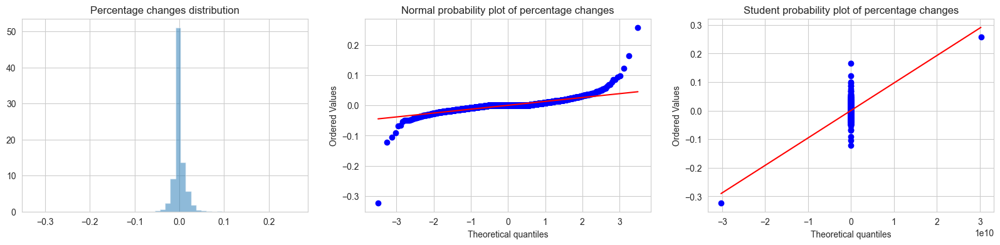

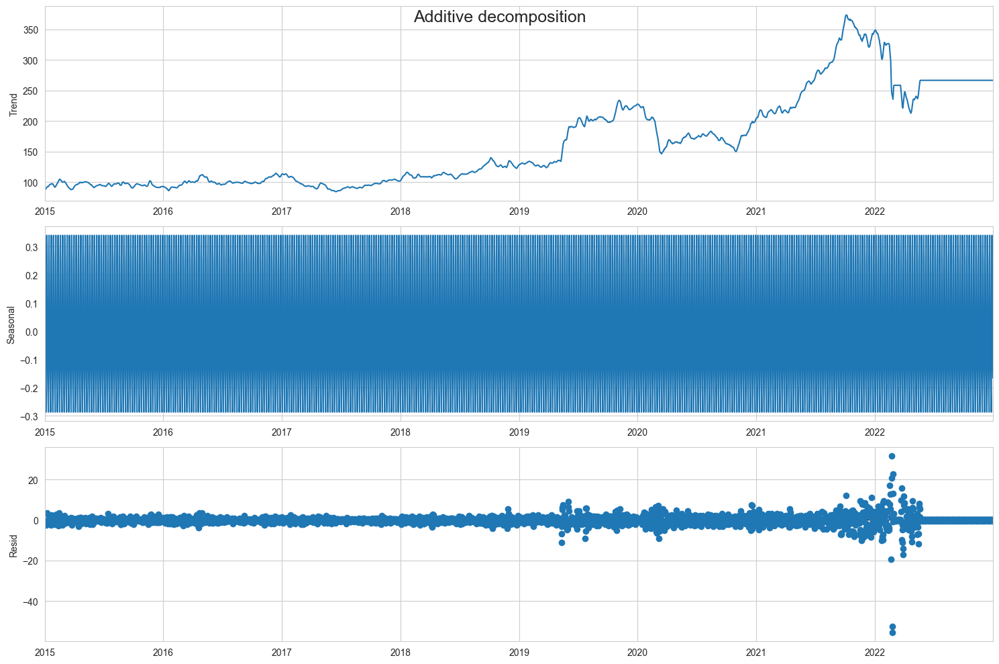

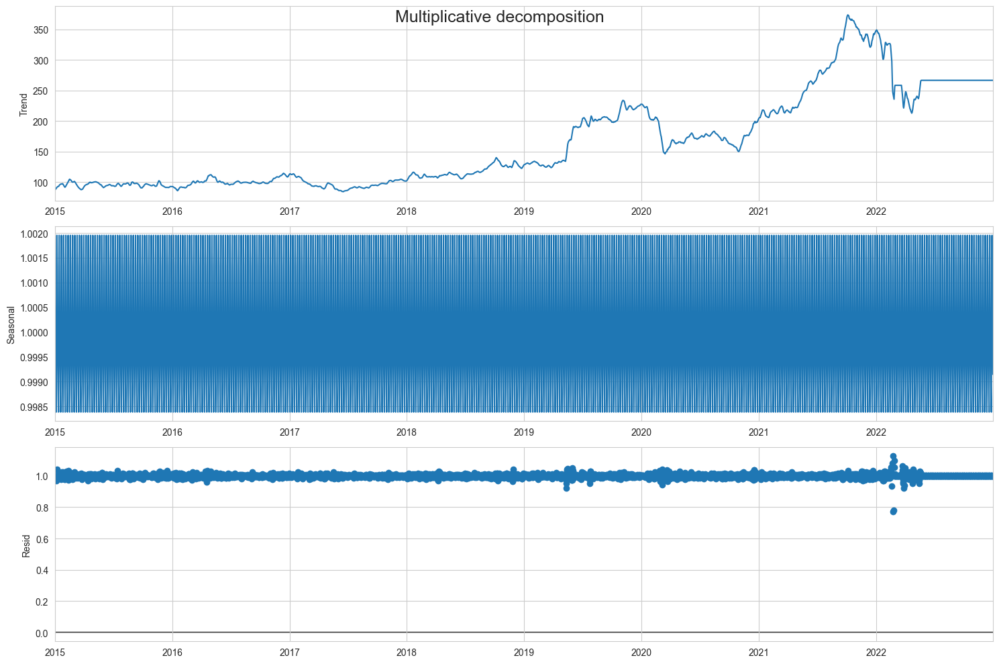

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


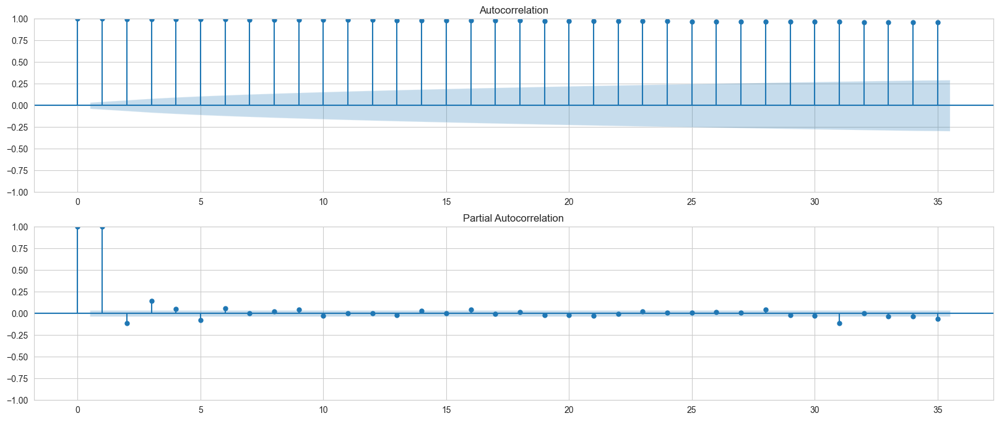


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
ГМК НОРНИКЕЛЬ


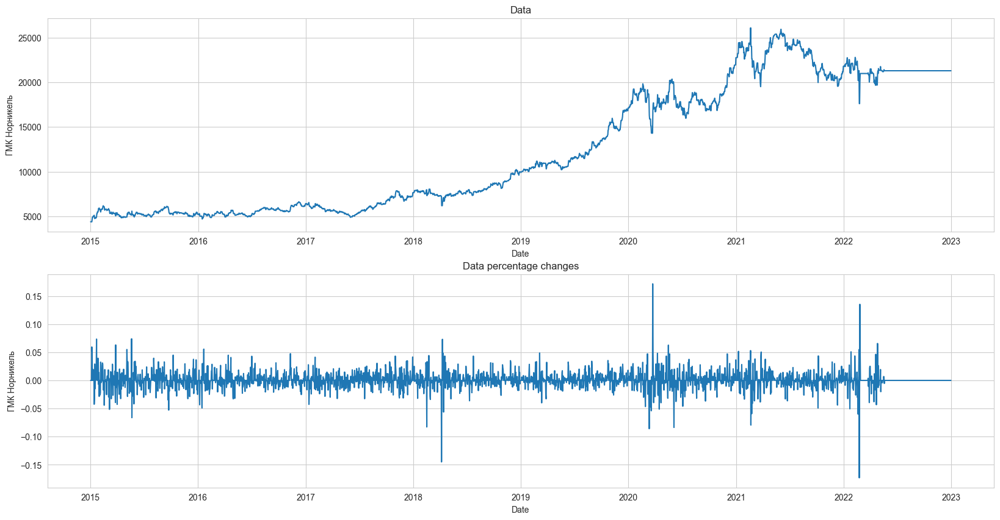

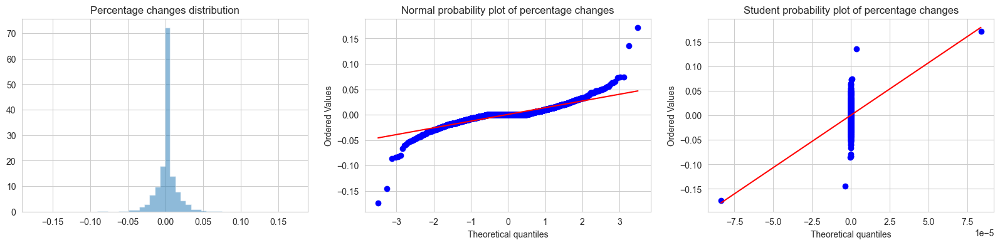

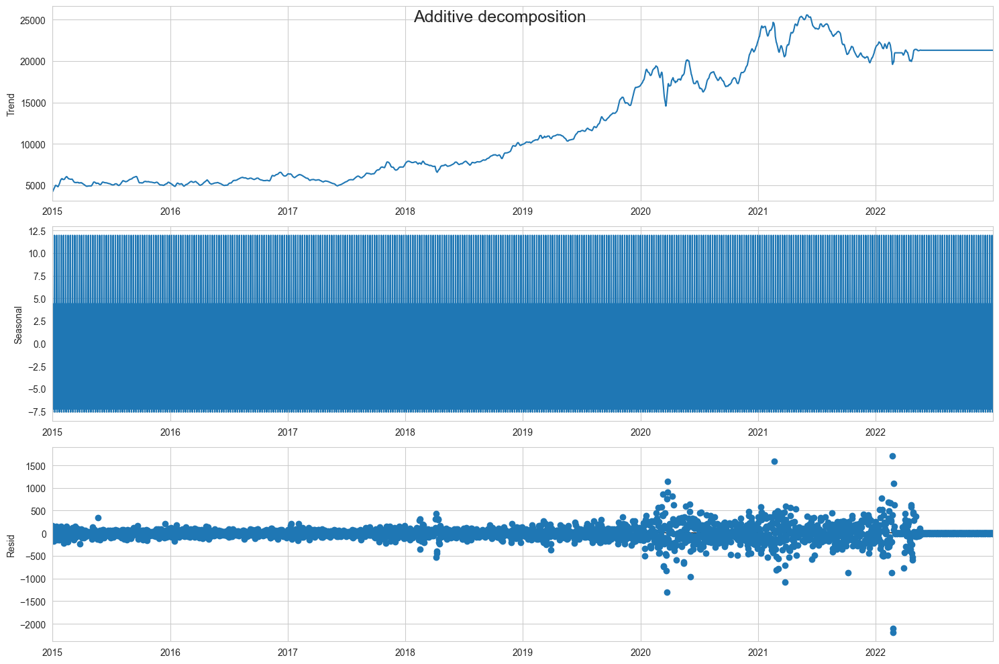

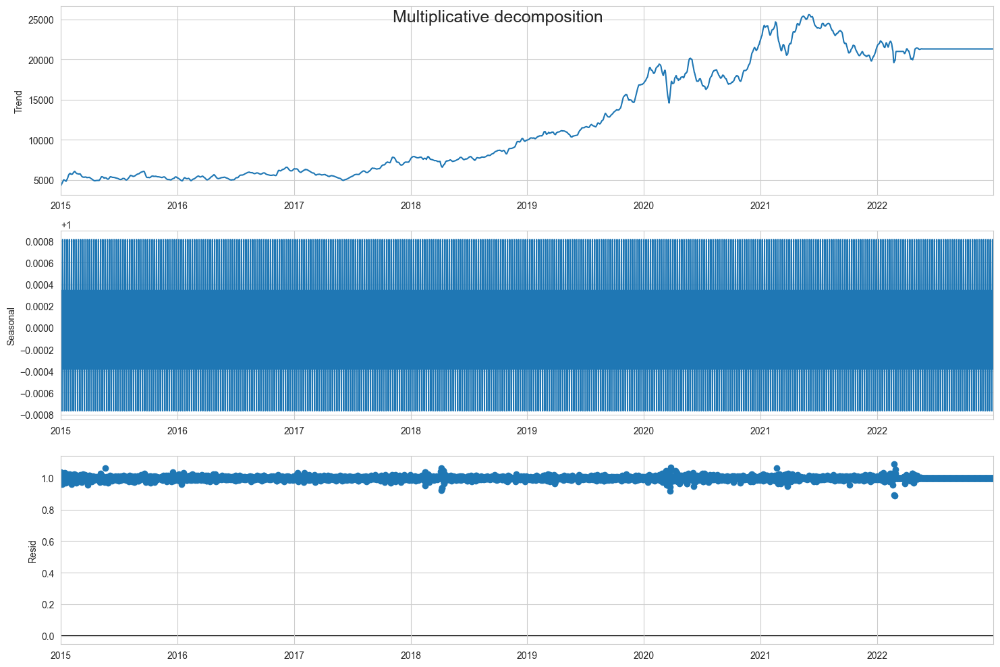

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


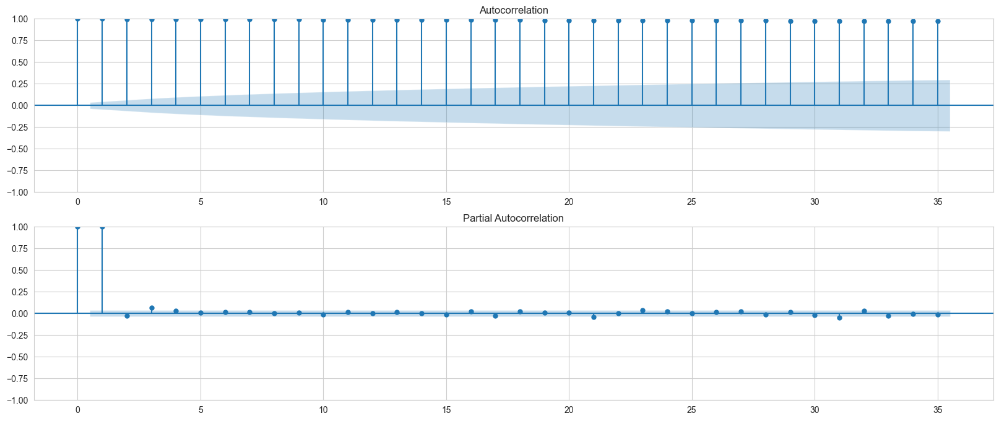


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
ЛУКОЙЛ


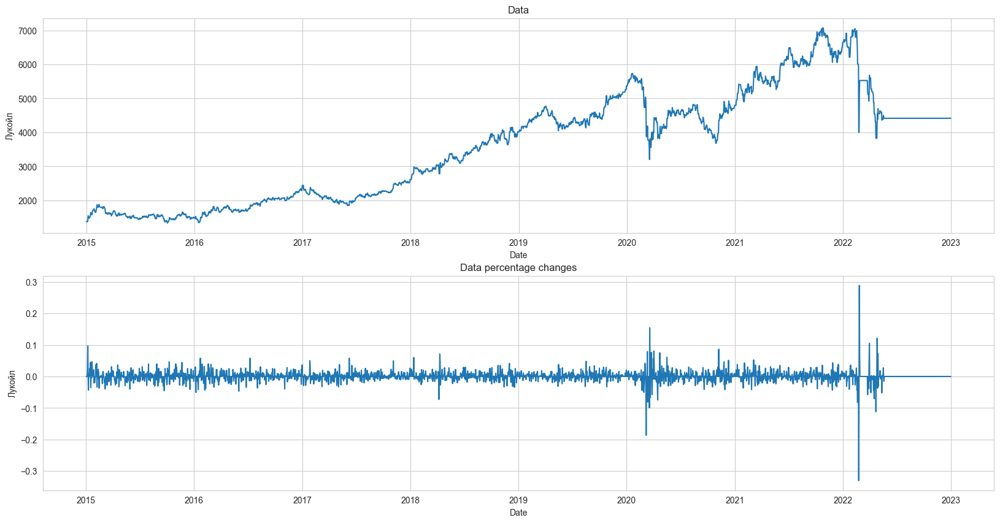

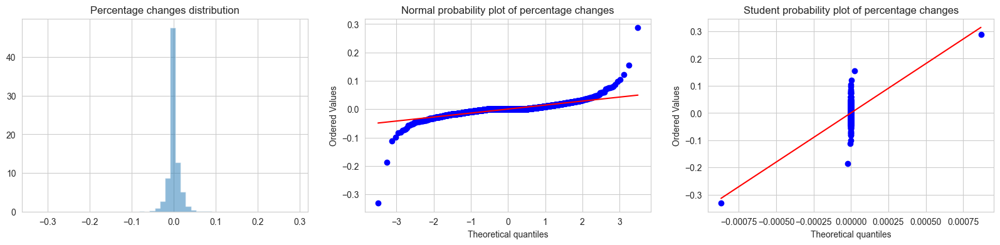

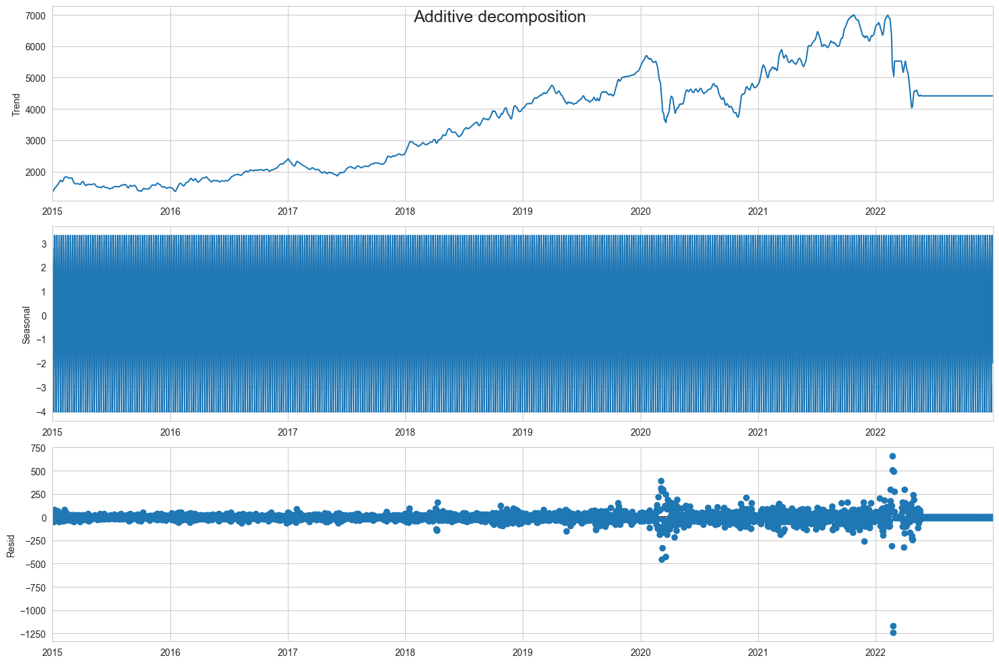

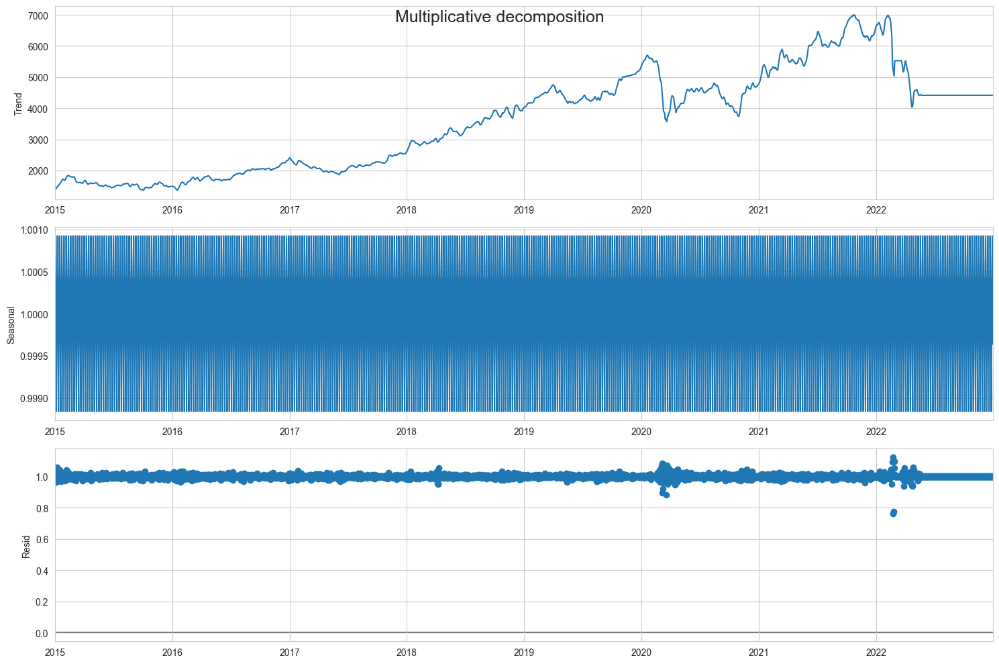

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


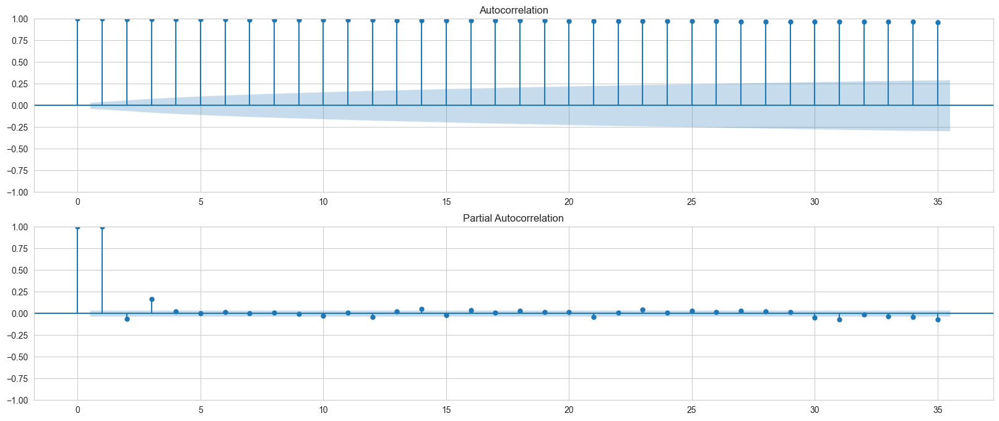


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
МТС


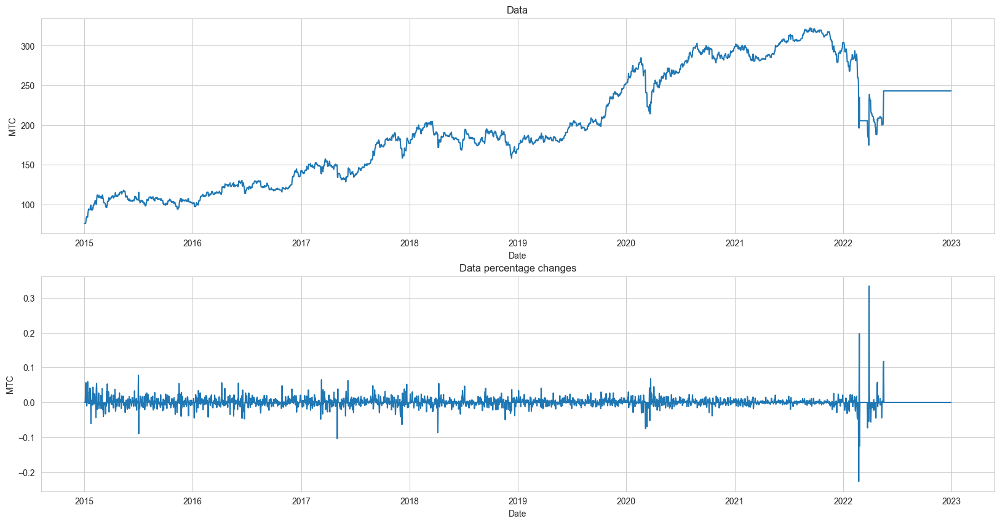

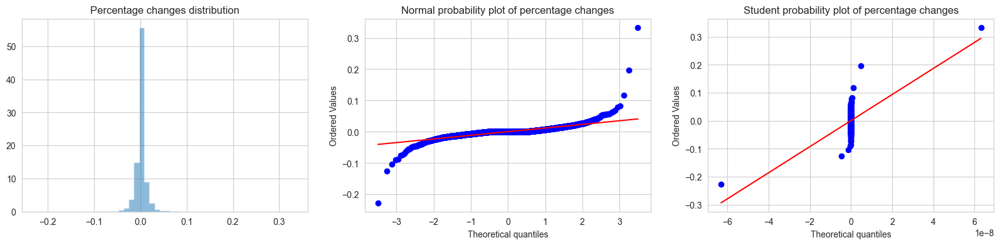

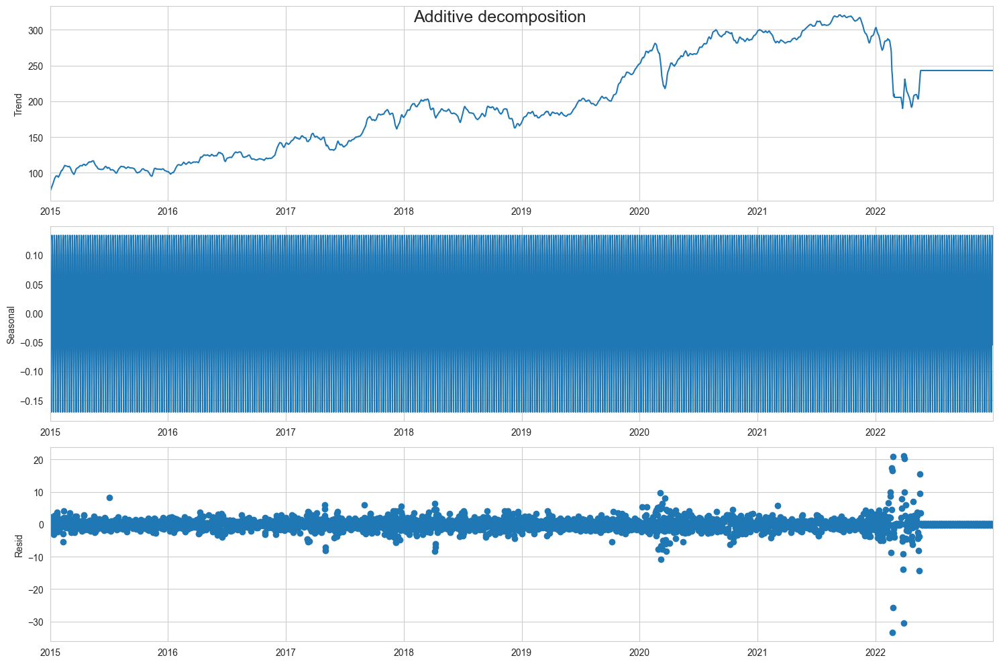

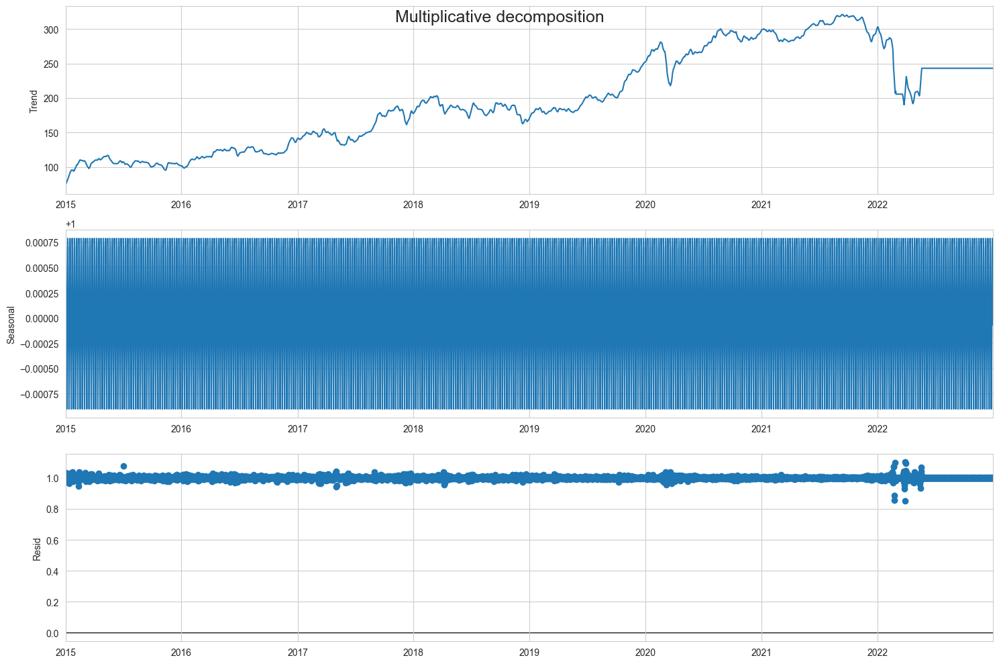

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


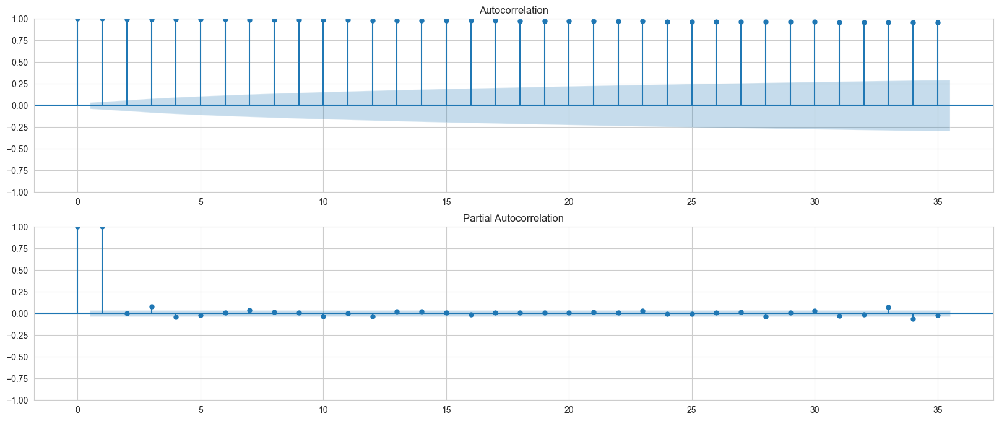


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
ПИК


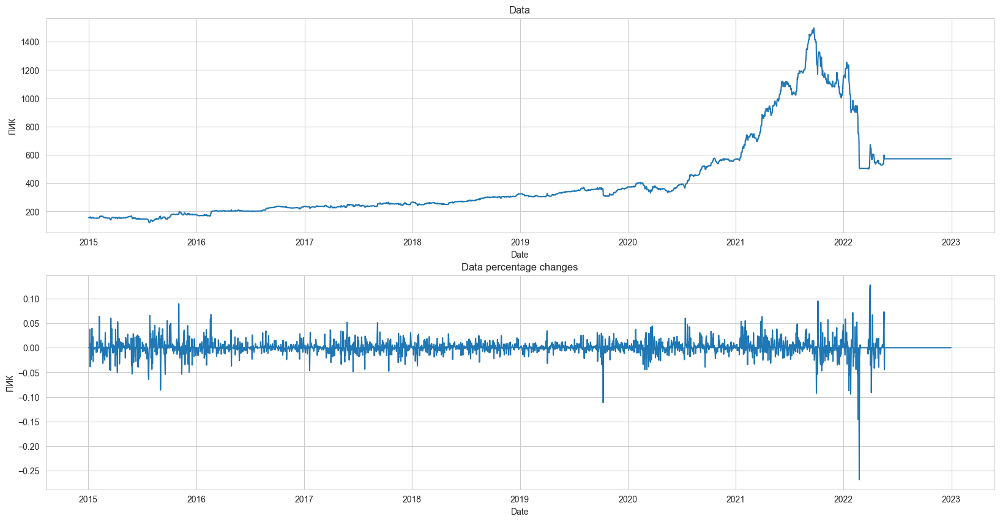

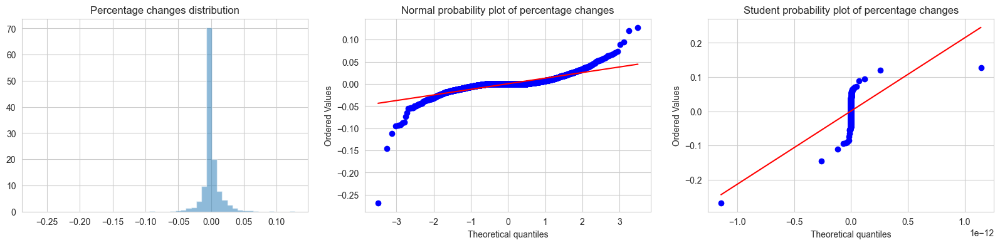

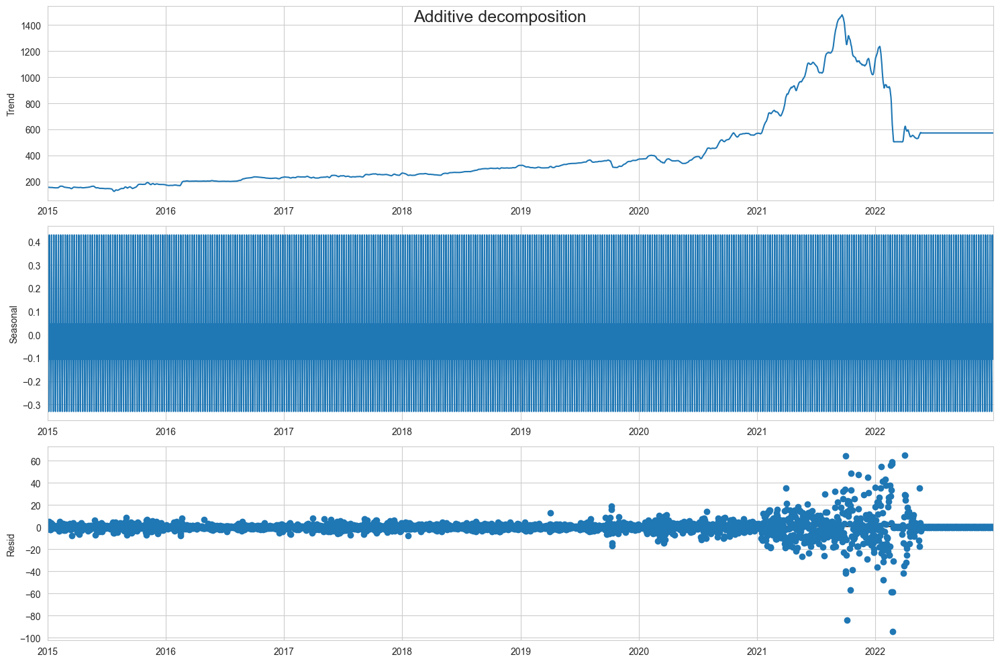

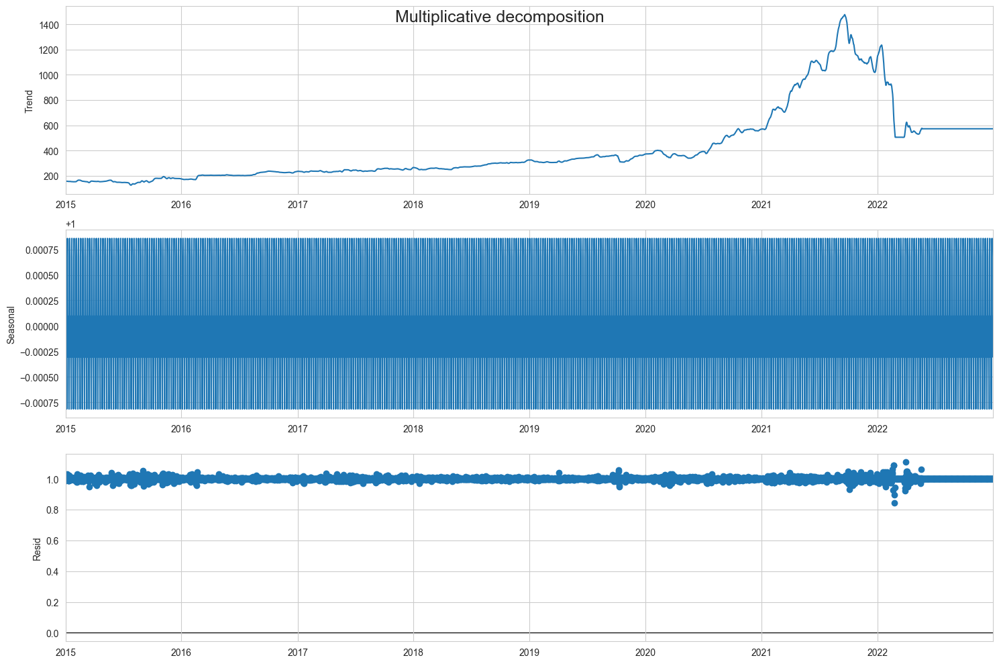

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


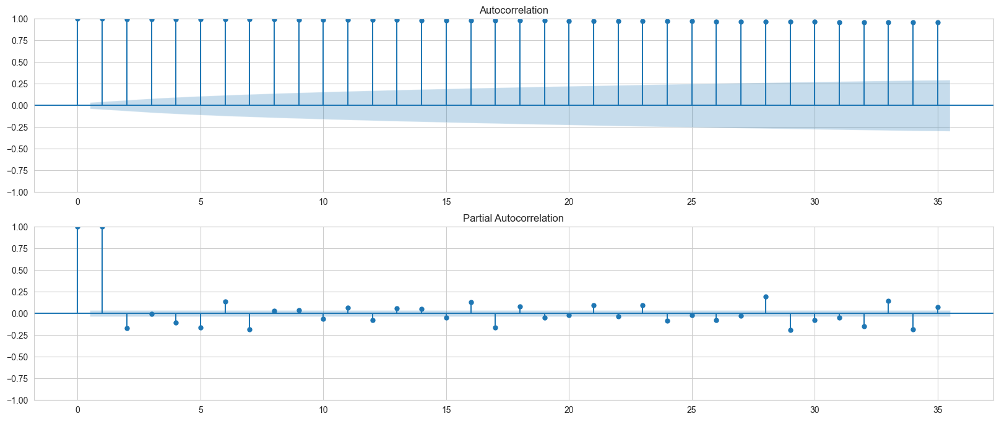


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
РОСНЕФТЬ


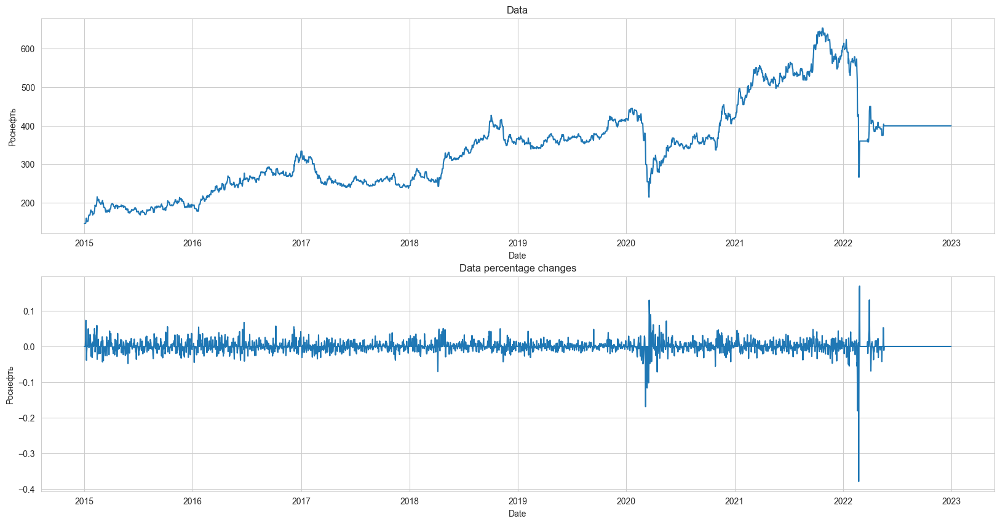

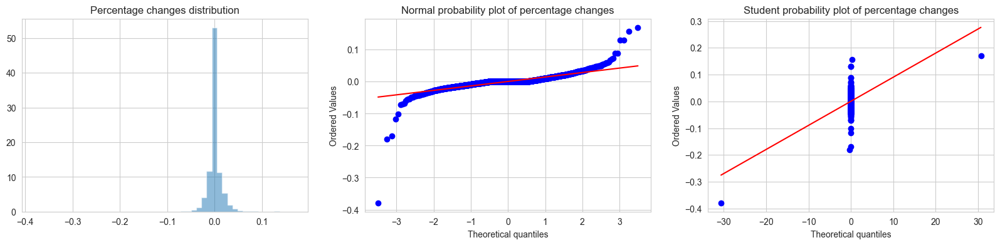

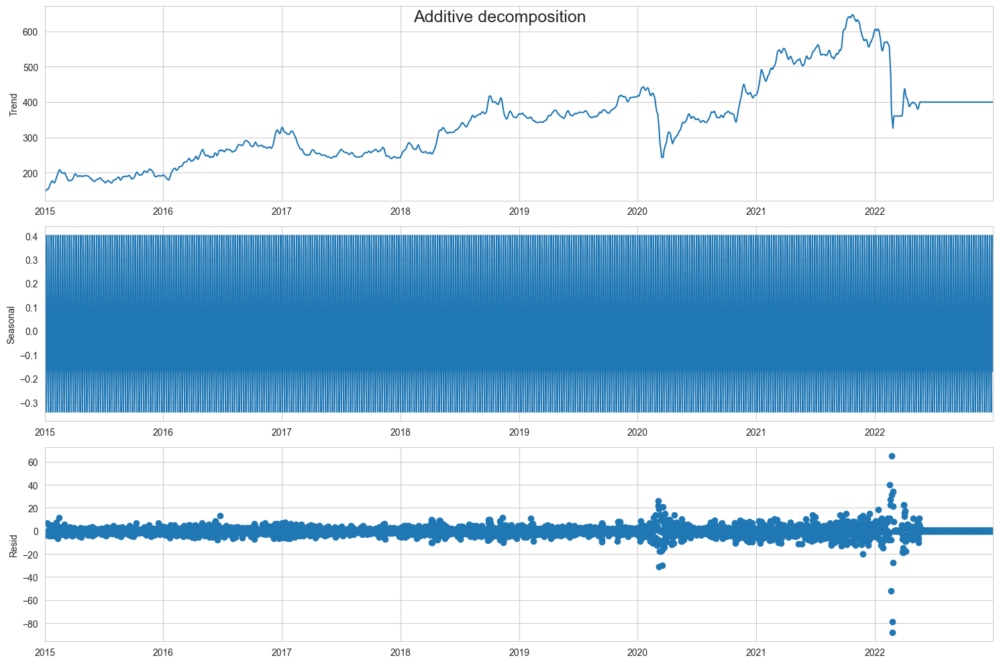

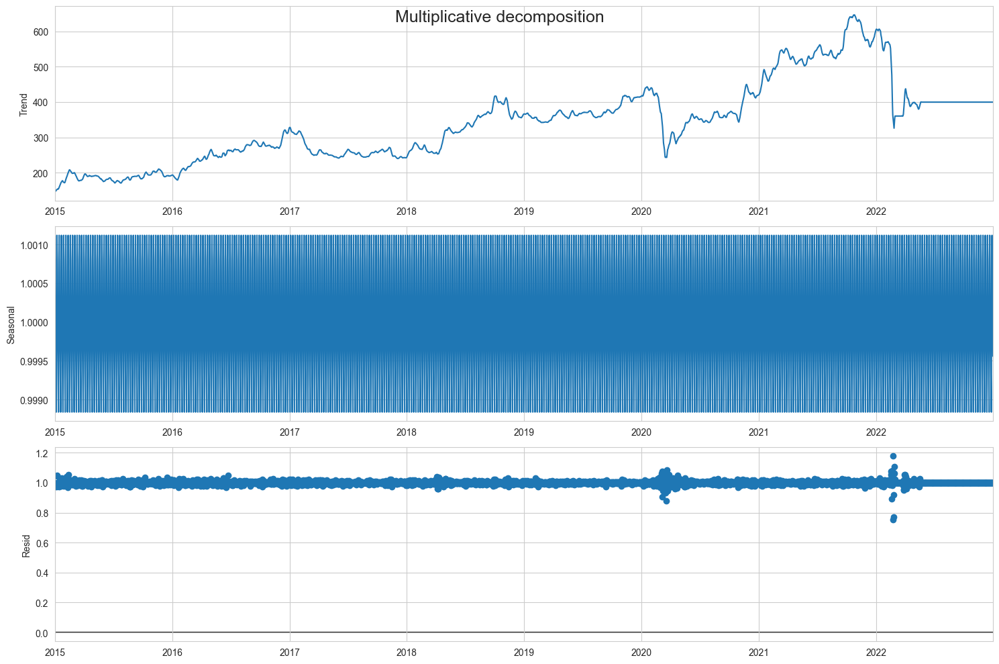

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


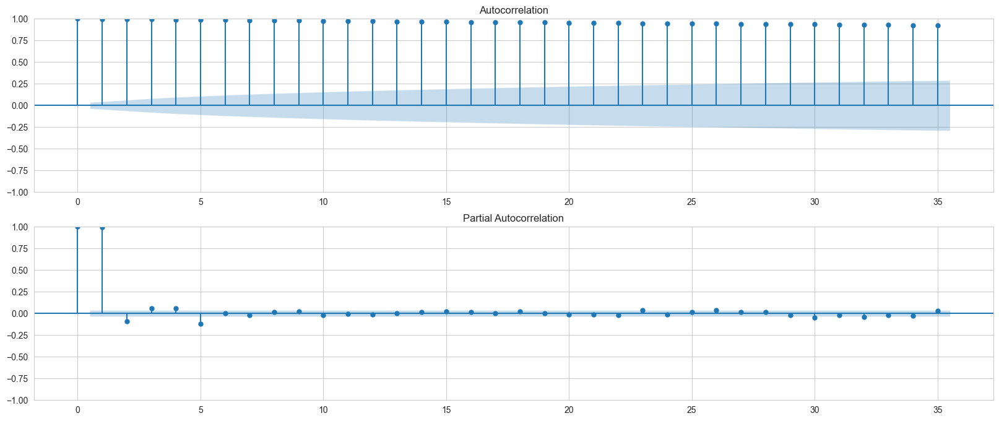


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
СБЕРБАНК


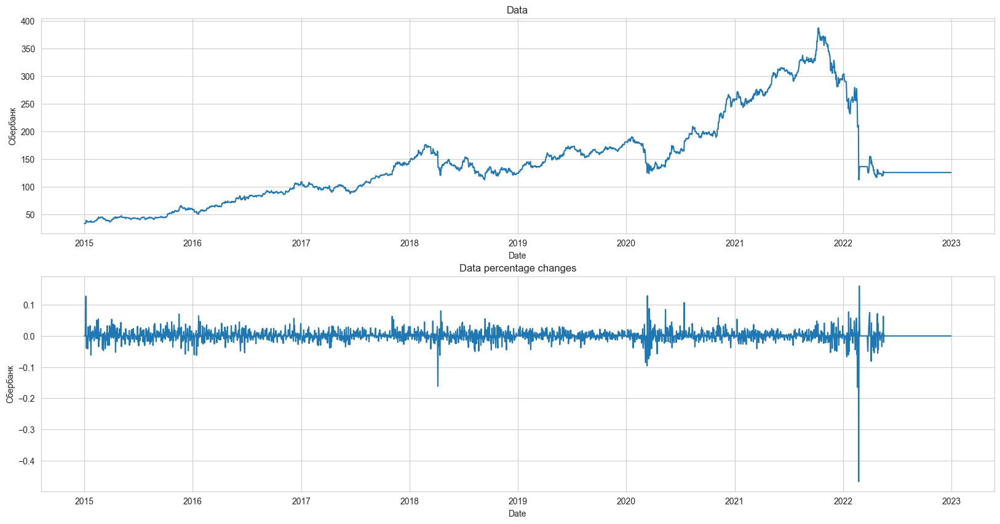

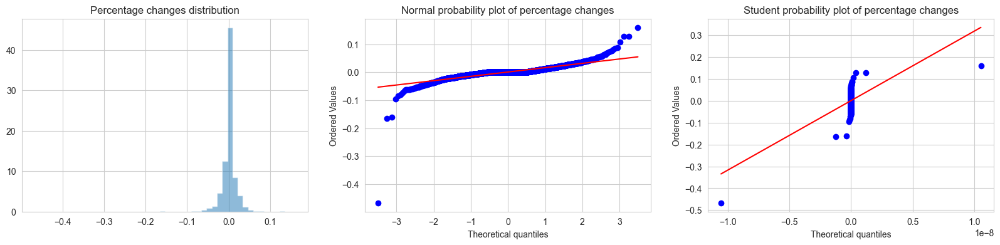

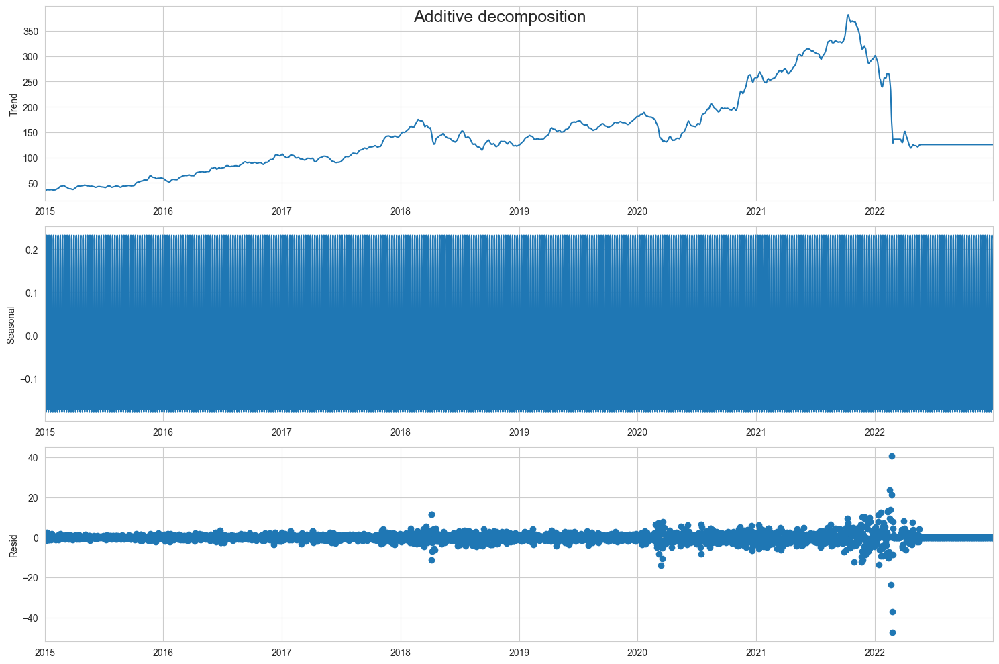

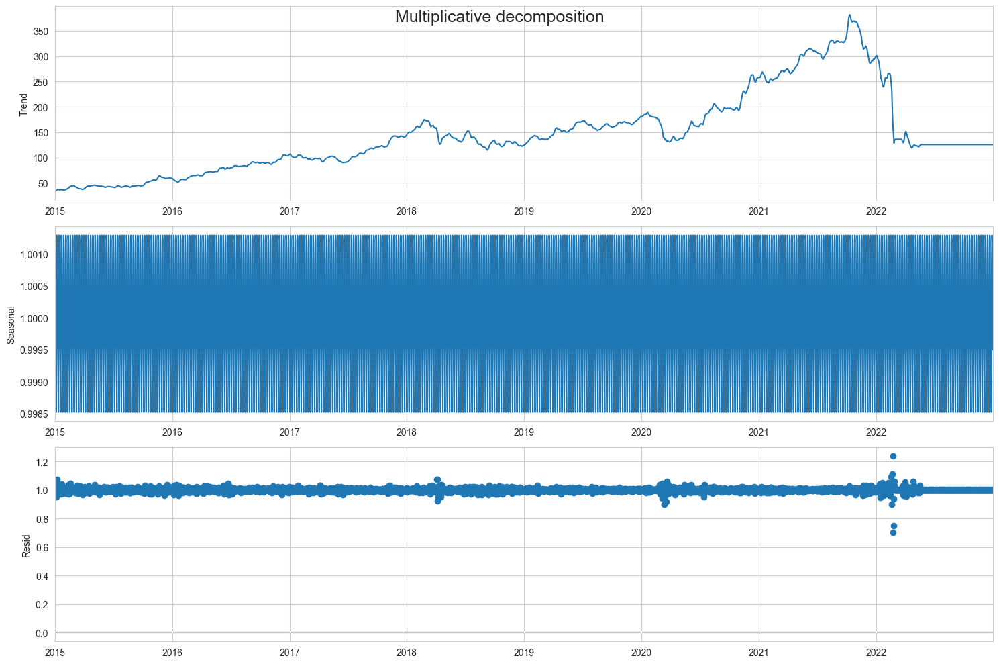

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


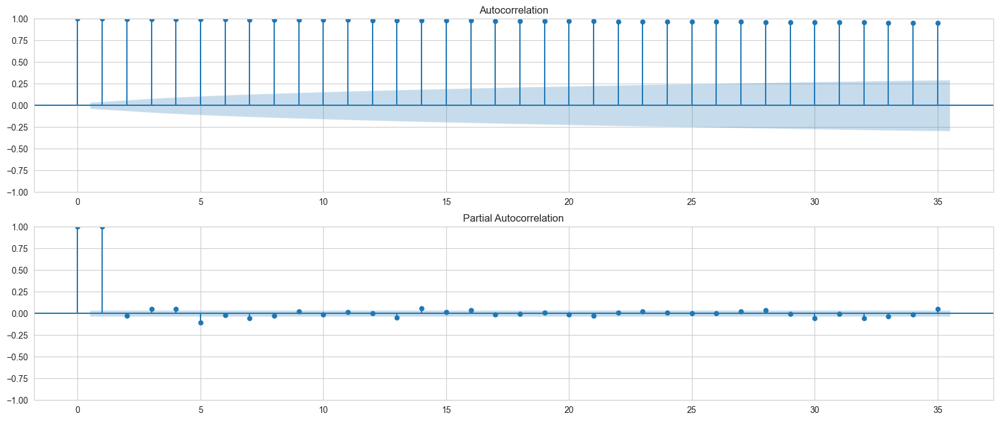


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
ТАТНЕФТЬ


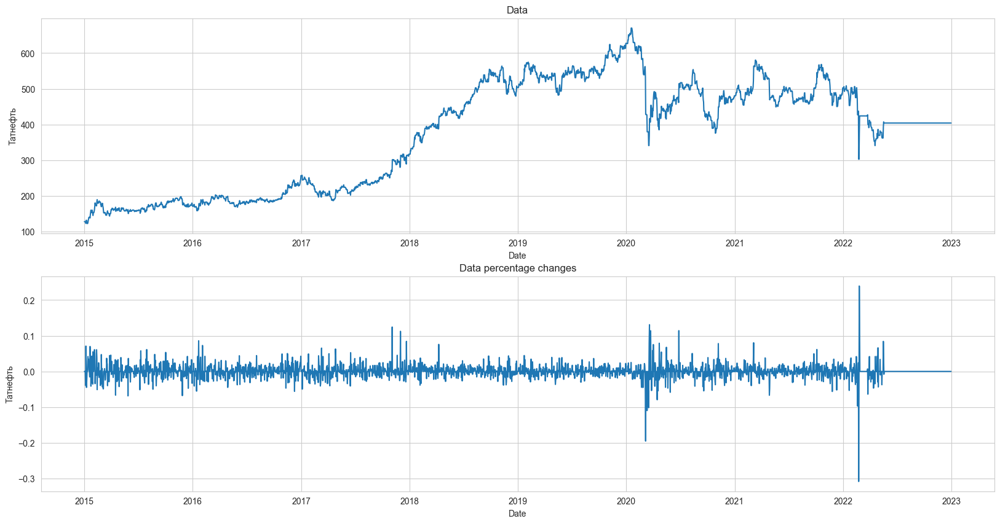

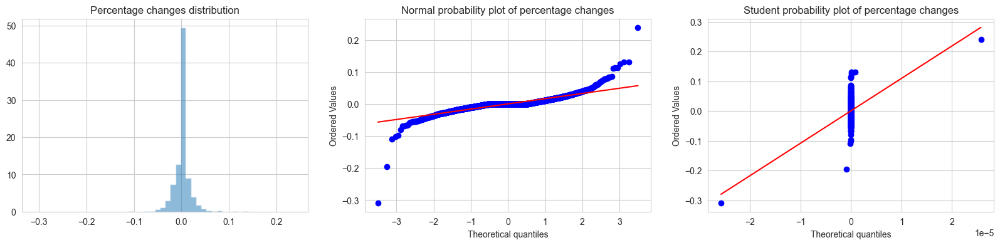

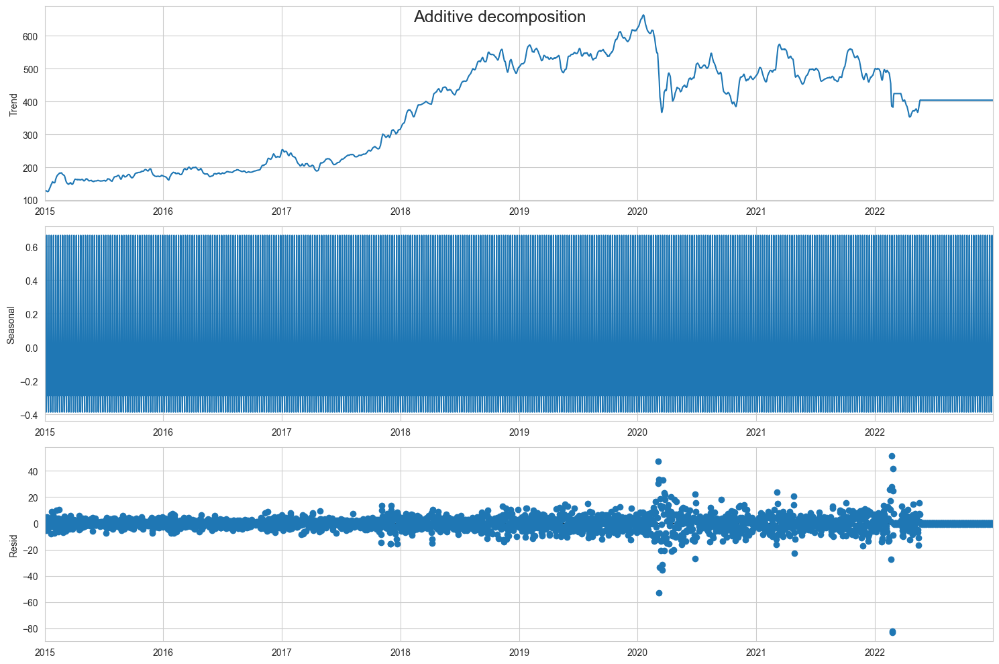

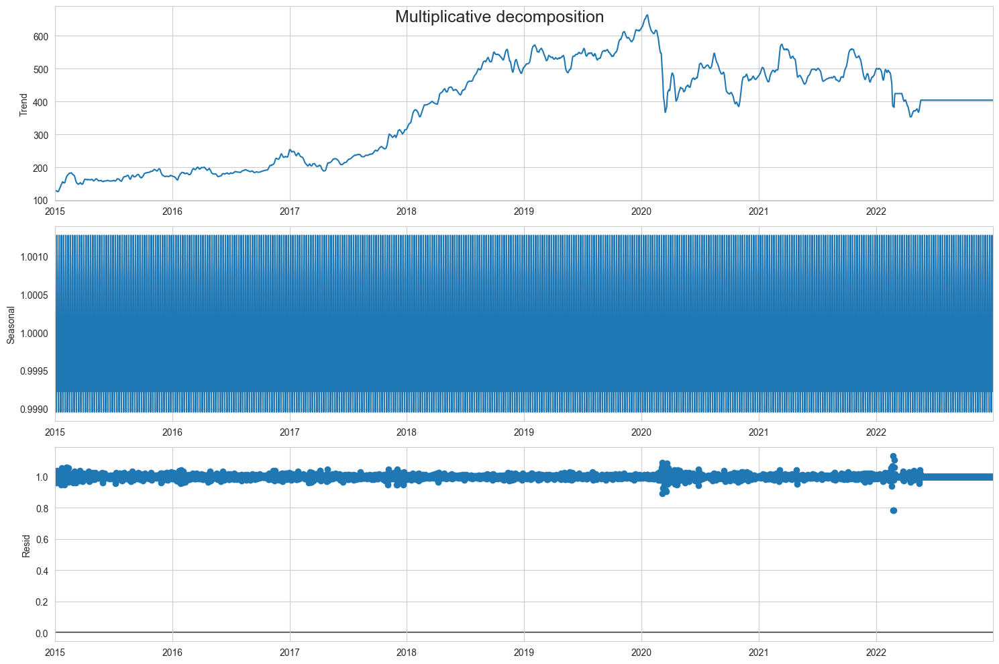

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


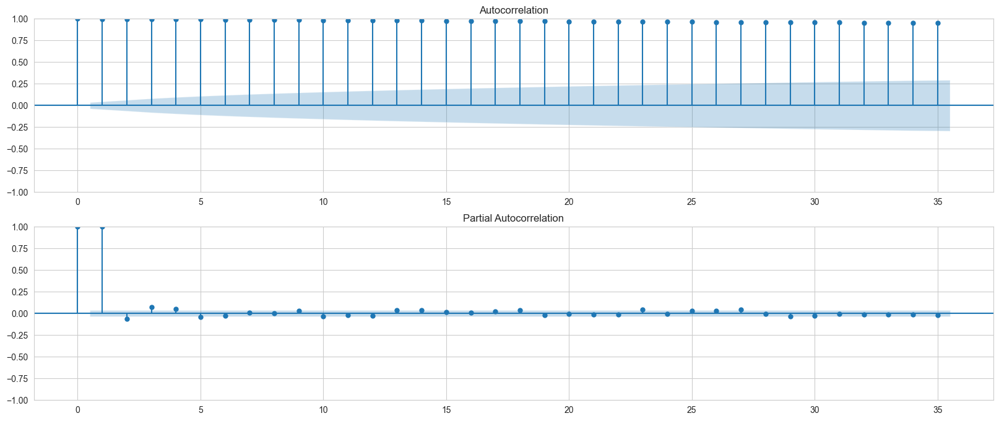


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************
ЯНДЕКС


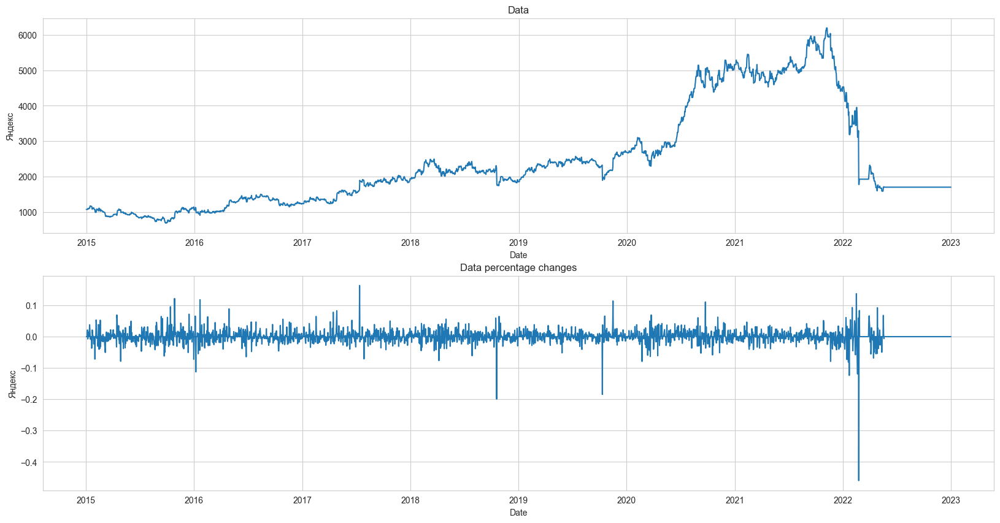

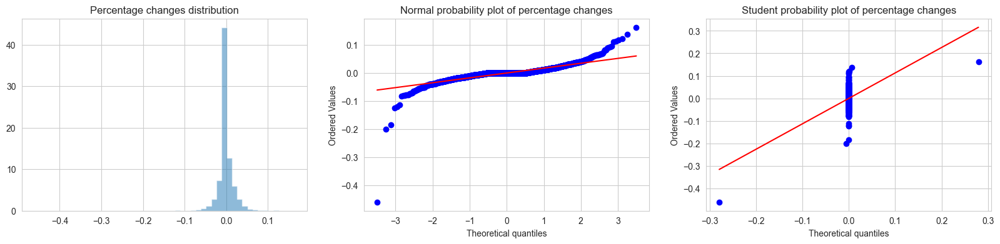

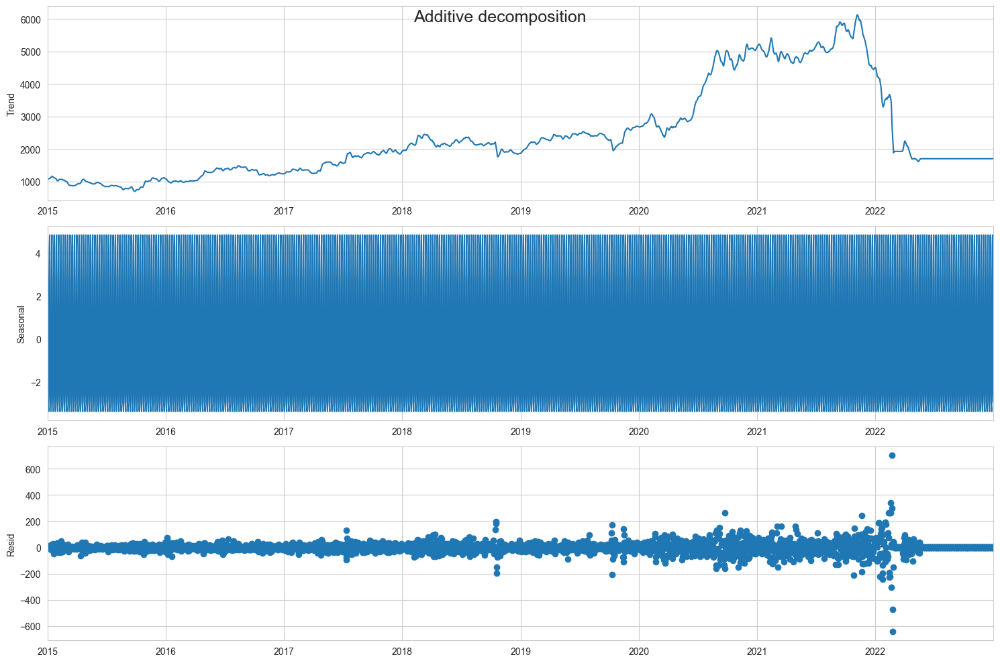

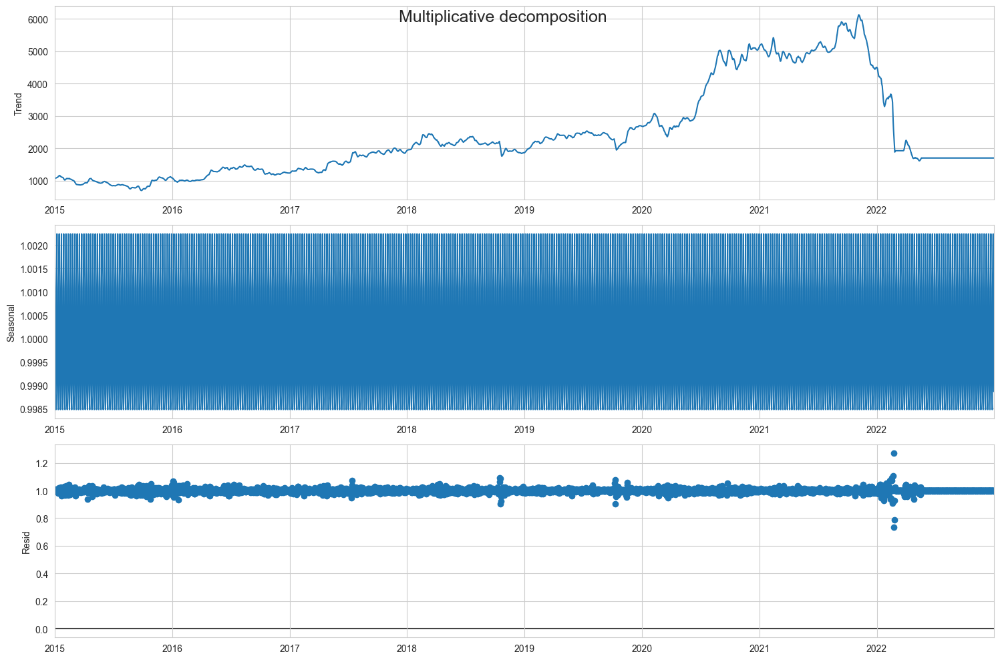

Tests on residuals
**********
	Applicative:
Student test: the estimator is biased.
ADF test: the series is stationary.

	Multiplicative:
Student test: the estimator is unbiased.
ADF test: the series is stationary.


Stationarity tests
**********
	Observed data
ADF test: the series is not stationary.
KPSS test: the series is not stationary.


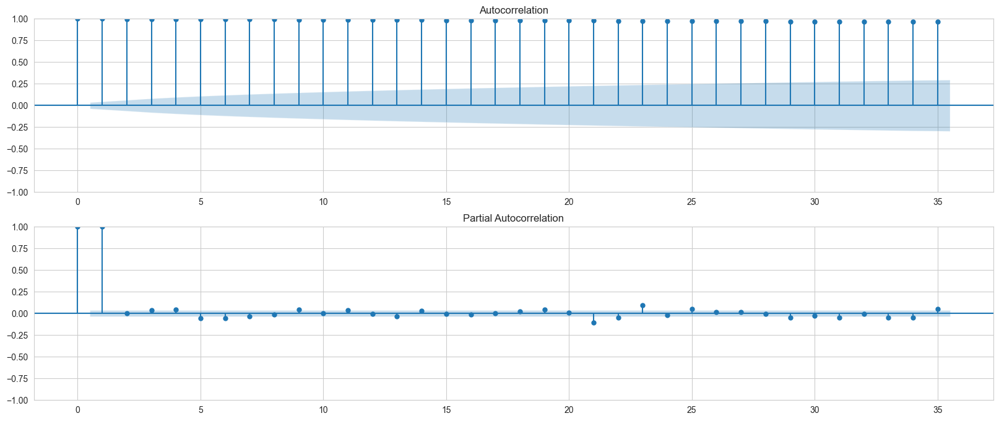


	Diff-1
ADF test: the series is not stationary.
KPSS test: the series is not stationary.

	Seasonal difference (30)
ADF test: the series is stationary.
KPSS test: the series is stationary.

	Seasonal difference (90)
ADF test: the series is stationary.
KPSS test: the series is not stationary.

	Seasonal difference (365)
ADF test: the series is not stationary.
KPSS test: the series is not stationary.
**************************************************


In [20]:
for factor in stocks:
    fd = FactorDescriptor(data.set_index('Date')[factor])
    print(f'{factor.upper()}')
    fd.full_info()
    print('*' * 50)